## **Import Important Libraries** 

In [2]:
#to deal with pandas dataframes
import pandas as pd

#to deal with numpy arrays
import numpy as np

#for plotting 
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import seaborn as sns
from matplotlib.pyplot import figure
from scipy import stats as st
from IPython.display import Image, display
import matplotlib.cm as cm

#to read the images 
from skimage.io import imread
import random
import glob
from pathlib import Path

#to import the tensorflow 
import tensorflow as tf

#to import keras modules from tensorflow
import tensorflow.keras as keras
from tensorflow.keras.models import Sequential

#to import keras layers from tensorflow
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Conv1D, MaxPool2D, GlobalAveragePooling2D, Dropout, BatchNormalization

#to import the accuracy score and confusion matrix
from sklearn.metrics import accuracy_score ,confusion_matrix, ConfusionMatrixDisplay, make_scorer, classification_report

#to transform the value into categorical
from tensorflow.keras.utils import to_categorical

#to import optimizers from keras and tensorflow
from tensorflow.keras.optimizers import SGD ,Adam 

#to import keras models and layers
from keras import layers, models  
from  keras.models import Model

#to import the VGG16 model
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input

#for data augmentation
from tensorflow.keras.preprocessing.image import ImageDataGenerator

#to load the images from tensorflow and preprocessing
from tensorflow.keras.preprocessing.image import img_to_array, load_img

from tensorflow.compat.v1.losses import Reduction

#to import the operating system
import os

#for splitting the data
from sklearn.model_selection import train_test_split

#to import cv2 module
import cv2

#to use warnings
import warnings

#to use the early stopping and losses 
from keras.callbacks import ModelCheckpoint, EarlyStopping
from livelossplot.inputs.keras import PlotLossesCallback
import keras.backend as K 

#to import activations
from keract import get_activations
from keract import display_activations

#to import regularization
from tensorflow.keras import regularizers

## **Build the models**

In [3]:
#build the model using keras
model_builder = keras.applications.xception.Xception

#define the process input
preprocess_input = keras.applications.xception.preprocess_input

#to decode the prediction
decode_predictions = keras.applications.xception.decode_predictions

In [4]:
#define the warnings
warnings.filterwarnings('ignore')

------------------------

## **Build the important Functions**

In [5]:
#define a function to load the data files
def load_data(data_path):
    
    #define a list for the images
    images=[]
    
    #define a list for images labels
    labels=[]
    
    
    print('Loading Data ...')
    
    #take the images from the directory
    for folder in os.listdir(data_path):
        
        fol=folder.strip('._')
        path= data_path +  '/' + fol
        print(f"Folder : {fol}")
        
        #list the images from their files
        for image in os.listdir(path):
            try:
                temp_img=cv2.imread(path+'/'+image)
                images.append(temp_img)
                labels.append(fol)
            except Exception :
                pass
        
    images=np.array(images,dtype=object)
    print("===========================================")
    print(f"X length : {len(images)}")
    print(f"y length : {len(labels)}")
        
        
    return images, labels

In [6]:
#define a function for visualizing the images from the classes
def visualize_class(y):
    
    #loop on the training data
    s= [v== y for v in y_train]
    idxs = np.flatnonzero(s)
    
    #to display 5 images from every class
    idxs = np.random.choice(idxs, 5, replace=False)
    
    #to show the images
    for i, idx in enumerate(idxs):
        plt.subplot(1,5, i+1)
        plt.imshow(X_train[idx].astype('uint8'))
        plt.axis('off')
        plt.title(y)
    plt.show()
            

def visualize_classes(classes):
    for y in classes:
        visualize_class(y)
    

In [7]:
#define a function to replace the labels of the images
def replace_labels_values(labels):
    
    #Airplane---->0
    lst = list(map(lambda x: x.replace('Airplane', '0'), labels))
    
    #BYC----->1
    lst = list(map(lambda x: x.replace('BYC', '1'), lst))
    
    #Bus ------> 2
    lst = list(map(lambda x: x.replace('Bus', '2'), lst))
    
    #Cars----->3
    lst = list(map(lambda x: x.replace('Cars', '3'), lst))
    
    #MC----->4
    lst = list(map(lambda x: x.replace('MC', '4'), lst))
    
    #SC ---->5
    lst = list(map(lambda x: x.replace('SC', '5'), lst))
    
    #boat ----> 6
    lst = list(map(lambda x: x.replace('boat', '6'), lst))
    
    #toktok ---->7
    lst = list(map(lambda x: x.replace('toktok', '7'), lst))
    
    #tram ---->8
    lst = list(map(lambda x: x.replace('tram', '8'), lst))
    
    #truck ---->9
    lst = list(map(lambda x: x.replace('truck', '9'), lst))
    
    #list the labels
    lst = [int(x) for x in lst]
    return lst

In [8]:
#define a function to create the models  using adam optimizer
def create_model(input_shape, n_classes, optimizer='adam', fine_tune=0):
    
    #define the VGG16 model
    conv_base = VGG16(include_top=False,  weights='imagenet', input_shape=input_shape)
    

    #condition for the model tuning 
    if fine_tune > 0:
        for layer in conv_base.layers[:-fine_tune]:
            layer.trainable = False
    else:
        for layer in conv_base.layers:
            layer.trainable = False
    
    #for the top of the model
    top_model = conv_base.output
    
    #define a flatten layer
    top_model = Flatten(name="flatten")(top_model)
    
    #put a dense layer with 400 units
    top_model = Dense(400, activation='relu')(top_model)
    
    #put a dense layer with 300 units
    top_model = Dense(300, activation='relu')(top_model)
    
    #put a dropout layer
    top_model = Dropout(0.2)(top_model)
    
    #define the output layer with softmax activation function
    output_layer = Dense(n_classes, activation='softmax')(top_model)
    
    #build the model
    model = Model(inputs=conv_base.input, outputs=output_layer)

    # Compiles the model for training.
    model.compile(optimizer=optimizer, 
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])
    
    return model

In [9]:
#for images scaling 
def scale_images(resized_images):
    scaled_images = resized_images.astype('float32') / 255.0
    return scaled_images

In [10]:
#define a function to plot the confusion matrix and classification report
def plot_report_confusionMatrix(y_pred,y_true):
    plt.figure(figsize=(16, 16))
    cm = confusion_matrix(y_true,y_pred)
    
    #to display the confusion matrix
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=['Airplane',
                                                                      'BYC','Bus',
                                                                      'Cars','MC',
                                                                      'SC','boat',
                                                                      'toktok','tram','truck'])
    disp.plot()
    plt.show()
    
    #to print the classification report
    print(classification_report(y_true, y_pred, target_names=['Airplane','BYC',
                                                              'Bus','Cars',
                                                              'MC','SC',
                                                              'boat','toktok',
                                                              'tram','truck']))
    

In [11]:
#define a function to visualize the activation map
def visualize_activation_maps_learned_by_model(model,img):
    # Generate the activations 
    activations = get_activations(model, img.reshape([1,64,64,3]))
    display_activations(activations, save=False)

In [12]:
#define a function to present the image as an array
def get_img_array(img):
    # `array` is a float32 Numpy array of shape (299, 299, 3)
    array = keras.preprocessing.image.img_to_array(img)
    # We add a dimension to transform our array into a "batch"
    # of size (1, 299, 299, 3)
    array = np.expand_dims(array, axis=0)
    return array

In [13]:
#define a function to display the heatmap
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [14]:
#define a function to display the heatmao of original image
def display_gradcam(img,heatmap,alpha=0.4):
    
    # We resize the heatmap to have the same size as the original image
    heatmap = cv2.resize(heatmap, (img.shape[1],img.shape[0]))

    # We convert the heatmap to RGB
    heatmap = np.uint8(255 * heatmap)

    # We apply the heatmap to the original image
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # 0.4 here is a heatmap intensity factor
    superimposed_img = heatmap *alpha + test_img
    
    plt.imshow(superimposed_img)
    plt.title("the original image with the heatmap")
    plt.show()

In [15]:
#define a function for imterpret prediction
def interpret_prediction(test_img,model,last_conv_layer_name,alpha=0.4):
    plt.imshow(test_img)
    # Prepare image
    img_array = preprocess_input(get_img_array(test_img.copy()))
    
    # Print what the top predicted class is
    preds = model.predict(img_array)
    
    cls_index = np.argmax(preds)
    cls_name=classes_names[np.argmax(preds)]
    print(f"predicted class:{cls_name}")
    
    # Generate class activation heatmap
    heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name,pred_index=cls_index)

    # Display heatmap
    plt.matshow(heatmap)
    plt.title("the heatmap of the test image")
    plt.show()
    
    display_gradcam(test_img, heatmap,alpha=alpha)    
    

In [16]:
#define a function for model regularization
def create_model_withL1L2Regularization(input_shape, n_classes, optimizer='adam', fine_tune=0):
    
    #define the base model
    conv_base = VGG16(include_top=False,  weights='imagenet', input_shape=input_shape)
    
    #for model tuning
    if fine_tune > 0:
        for layer in conv_base.layers[:-fine_tune]:
            layer.trainable = False
    else:
        for layer in conv_base.layers:
            layer.trainable = False
    
    #define the model layers
    top_model = conv_base.output
    top_model = Flatten(name="flatten")(top_model)
    top_model = Dense(400, activation='relu')(top_model)
    
    top_model = tf.keras.layers.Dense(units=1024,activation='relu',
        kernel_regularizer=regularizers.L1L2(l1=1e-4, l2=1e-4),
        bias_regularizer=regularizers.L2(1e-4),
        activity_regularizer=regularizers.L2(1e-4))(top_model)
    
    top_model = Dropout(0.2)(top_model)
    output_layer = Dense(n_classes, activation='softmax')(top_model)
    
    model = Model(inputs=conv_base.input, outputs=output_layer)

    # Compiles the model for training.
    model.compile(optimizer=optimizer, 
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])
    
    return model

In [17]:
#define a functin for plotting the results
def plot_results(model_1_loss,model_1_acc,model_1_val_loss,model_1_val_acc,modelName):
    plt.figure(figsize=(12, 7))
  
    X = ["original Data","Data Augmentation","L1,L2 Regularization", "L1,L2 and Data Augmentation"]

    X_axis = np.arange(len(X))

    plt.bar(X_axis - 0.6, model_1_loss, 0.1, label = 'loss')
    plt.bar(X_axis - 0.4, model_1_val_loss, 0.1, label = 'val_loss')
    plt.bar(X_axis - 0.2, model_1_acc, 0.1, label = 'acc')
    plt.bar(X_axis , model_1_val_acc, 0.1, label = 'val_acc')

    plt.xticks(X_axis, X)
    plt.xlabel("Experiment",fontsize=16)
    plt.ylabel("scores",fontsize=16)
    plt.title(f"the results of {modelName}",fontsize=18)
    plt.legend()
    plt.grid()
    plt.show()

--------------------------

## **Classification Experiments**

<h3 style="color:MAROON;">Loading the Data</h3> 

In [18]:
#load the train data
X_train,y_train = load_data('train')

Loading Data ...
Folder : Airplane
Folder : boat
Folder : Bus
Folder : BYC
Folder : Cars
Folder : MC
Folder : SC
Folder : toktok
Folder : tram
Folder : truck
X length : 300
y length : 300


In [19]:
#load the validation data
X_val,y_val = load_data('validation')

Loading Data ...
Folder : Airplane
Folder : boat
Folder : Bus
Folder : BYC
Folder : Cars
Folder : MC
Folder : SC
Folder : toktok
Folder : tram
Folder : truck
X length : 100
y length : 100


In [20]:
#load the testing data
X_test,y_test = load_data('test')

Loading Data ...
Folder : Airplane
Folder : boat
Folder : Bus
Folder : BYC
Folder : Cars
Folder : MC
Folder : SC
Folder : toktok
Folder : tram
Folder : truck
X length : 100
y length : 100


In [355]:
print(f"the shape of the x_train is :{X_train.shape}")
print(f"the shape of the x_val   is :{X_val.shape}")
print(f"the shape of the x_test  is :{X_test.shape}")

the shape of the x_train is :(300, 64, 64, 3)
the shape of the x_val   is :(100, 64, 64, 3)
the shape of the x_test  is :(100, 64, 64, 3)


<h3 style="color:MAROON;">Visualize sample from each class </h3> 

In [21]:
#define the classes names
classes_names = ['Airplane','BYC','Bus','Cars','MC','SC','boat','toktok','tram','truck']

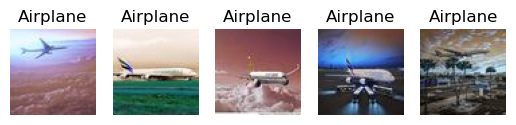

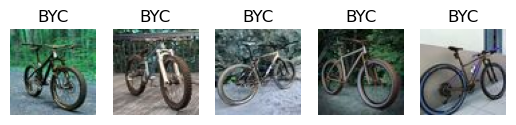

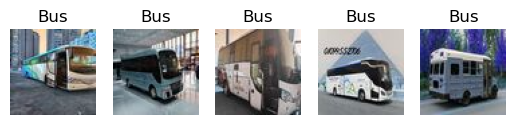

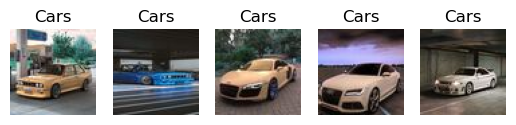

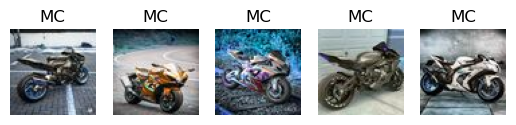

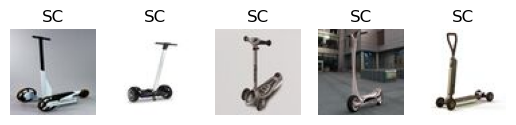

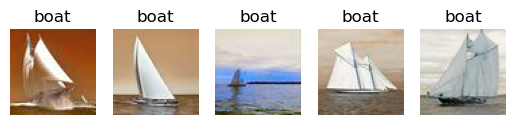

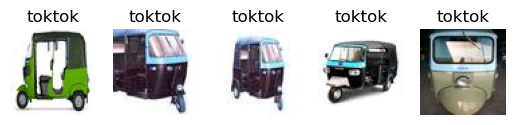

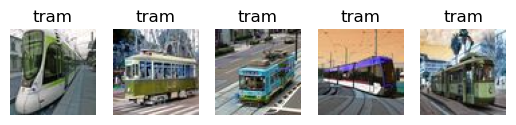

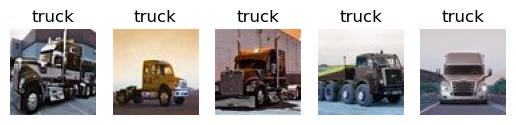

In [22]:
#visualie a sample from every class
train_lst= list(np.unique(y_train))
visualize_classes(train_lst)

### replace the class names with numbers

In [23]:
y_train_replaced = replace_labels_values(y_train)
y_val_replaced   = replace_labels_values(y_val)
y_test_replaced  = replace_labels_values(y_test)

### scale the images 

In [24]:
X_train = scale_images(X_train)
X_val   = scale_images(X_val)
X_test  = scale_images(X_test)

<h3 style="color:maroon;"> Building the models </h3> 

<h4 style="color:darkBlue;"> Model 1 </h4> 

In [25]:
model_1 = tf.keras.models.Sequential([
    #put the first convolution layer 
    tf.keras.layers.Conv2D(64, (3,3), activation='relu', input_shape=(64, 64, 3)),
    
    #put the maxpooling layer
    tf.keras.layers.MaxPooling2D(2, 2),
    
    #put the second convolution
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    
    #put the maxpooling layer
    tf.keras.layers.MaxPooling2D(2,2),
    
    #put the third convolution
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    
    #put the maxpooling layer
    tf.keras.layers.MaxPooling2D(2,2),
    
    #put the fourth convolution layer
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    
    #put the maxpooling layer
    tf.keras.layers.MaxPooling2D(2,2),
    
    #Flatten the results to feed into the DNN
    tf.keras.layers.Flatten(),
    
    #put the dropout layer
    tf.keras.layers.Dropout(0.5),
    
    #put the dense 512 neuron hidden layer
    tf.keras.layers.Dense(512, activation='relu'),
    
    #put the dense output layer with softmax activation function
    tf.keras.layers.Dense(10, activation='softmax')
])

In [26]:
#print the model summary
model_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 62, 62, 64)        1792      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 31, 31, 64)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 29, 29, 64)        36928     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 14, 14, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 12, 12, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 6, 6, 128)        0

In [27]:
#compile the model
model_1.compile(optimizer=Adam(learning_rate=0.0001),loss='sparse_categorical_crossentropy',metrics=['accuracy'])

<h4 style="color:darkBlue;"> Model 2 </h4> 

In [28]:
#define the input shape of the model, learning optimizer and number of classes
input_shape = (64, 64, 3)
optim = Adam(learning_rate=0.0001)
n_classes=10

# Re-compile the model, with freezing all the weight of the VGG network 
model_2 = create_model(input_shape, n_classes, optim, fine_tune=0)

In [21]:
#print the model summary
model_2.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 16, 16, 128)       0     

<h4 style="color:darkBlue;"> Model 3 </h4> 

In [22]:
# Re-compile the model, this time leaving the last 2 layers unfrozen for Fine-Tuning
model_3 = create_model(input_shape, n_classes, optim, fine_tune=2)

In [23]:
#print the model summary
model_3.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 16, 16, 128)       0   

<h3 style="color:maroon;"> Fitting the models on the original Data </h3> 

In [24]:
# EarlyStopping
early_stop = EarlyStopping(monitor='val_loss',patience=10,restore_best_weights=True,mode='min')

# ModelCheckpoint callback - save best weights
tl_checkpoint_1 = ModelCheckpoint(filepath='tl_model_1.weights.best.hdf5',save_best_only=True,verbose=1)
tl_checkpoint_2 = ModelCheckpoint(filepath='tl_model_2.weights.best.hdf5',save_best_only=True,verbose=1)
tl_checkpoint_3 = ModelCheckpoint(filepath='tl_model_3.weights.best.hdf5',save_best_only=True,verbose=1)

<h4 style="color:darkBlue;"> Model 1 </h4> 

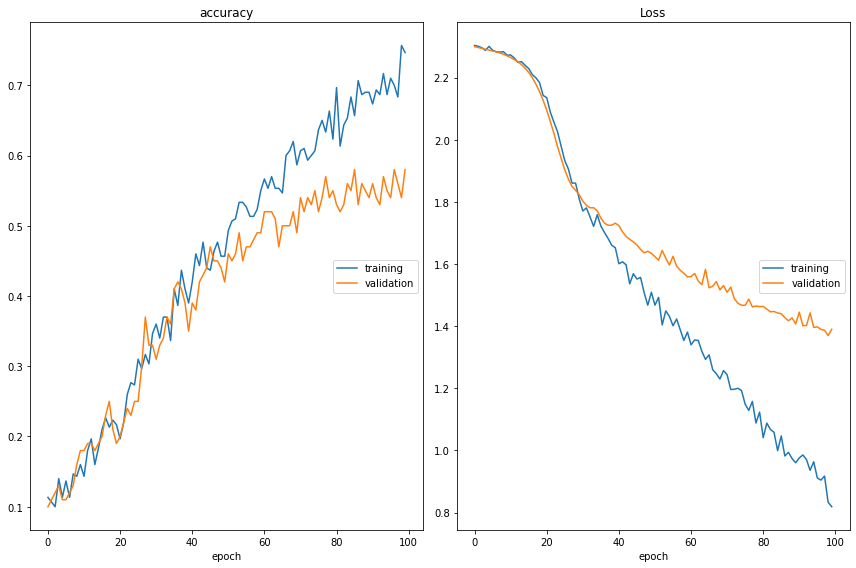

accuracy
	training         	 (min:    0.100, max:    0.757, cur:    0.747)
	validation       	 (min:    0.100, max:    0.580, cur:    0.580)
Loss
	training         	 (min:    0.819, max:    2.304, cur:    0.819)
	validation       	 (min:    1.370, max:    2.300, cur:    1.390)
3/3 [==============================] - 2s 747ms/step - loss: 0.8189 - accuracy: 0.7467 - val_loss: 1.3902 - val_accuracy: 0.5800


In [25]:
#plotting the results of model 1
plot_loss = PlotLossesCallback()
model_1_history = model_1.fit(X_train,np.array(y_train_replaced),
                              batch_size=128,
                              epochs=100, verbose=1, 
                              validation_data=(X_val,np.array(y_val_replaced)),
                              callbacks=[tl_checkpoint_1, early_stop,plot_loss])

<h4 style="color:darkBlue;"> Model 2 </h4> 

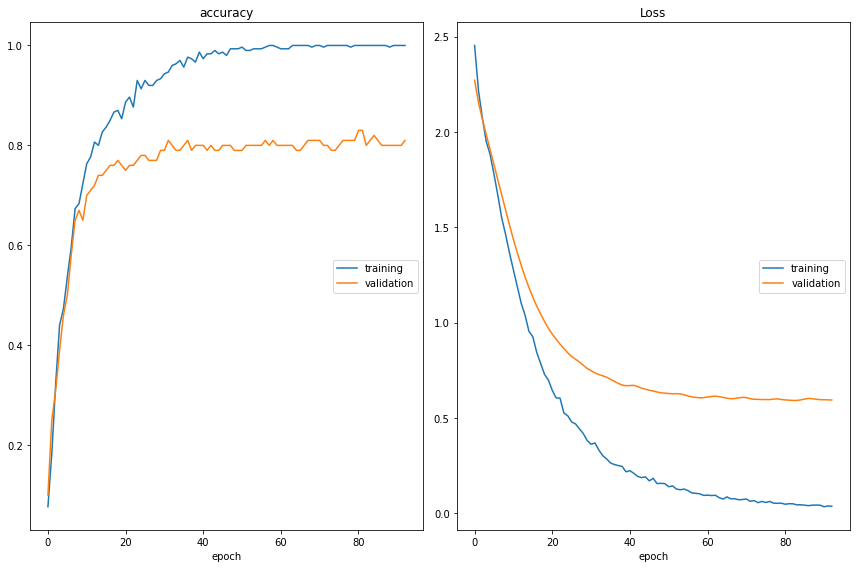

accuracy
	training         	 (min:    0.077, max:    1.000, cur:    1.000)
	validation       	 (min:    0.100, max:    0.830, cur:    0.810)
Loss
	training         	 (min:    0.034, max:    2.454, cur:    0.037)
	validation       	 (min:    0.591, max:    2.271, cur:    0.594)
3/3 [==============================] - 9s 3s/step - loss: 0.0366 - accuracy: 1.0000 - val_loss: 0.5938 - val_accuracy: 0.8100


In [26]:
#plot the results of model 2 
plot_loss2 = PlotLossesCallback()
model_2_history = model_2.fit(X_train,np.array(y_train_replaced),
                              batch_size=128, 
                              epochs=100, 
                              verbose=1, 
                              validation_data=(X_val,np.array(y_val_replaced)),
                              callbacks=[tl_checkpoint_2, early_stop,plot_loss2])

<h4 style="color:darkBlue;"> Model 3 </h4> 

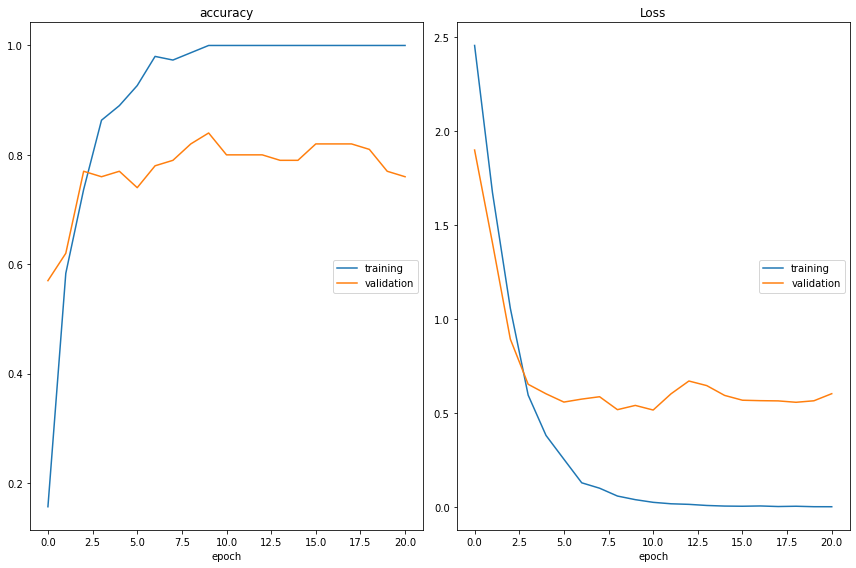

accuracy
	training         	 (min:    0.157, max:    1.000, cur:    1.000)
	validation       	 (min:    0.570, max:    0.840, cur:    0.760)
Loss
	training         	 (min:    0.003, max:    2.456, cur:    0.003)
	validation       	 (min:    0.517, max:    1.899, cur:    0.604)
3/3 [==============================] - 8s 3s/step - loss: 0.0027 - accuracy: 1.0000 - val_loss: 0.6038 - val_accuracy: 0.7600


In [27]:
#plot the results of model 3
plot_loss3 = PlotLossesCallback()
model_3_history = model_3.fit(X_train,np.array(y_train_replaced), 
                              batch_size=128, 
                              epochs=100, 
                              verbose=1,
                              validation_data=(X_val,np.array(y_val_replaced)),
                              callbacks=[tl_checkpoint_2, early_stop,plot_loss3])

<h3 style="color:maroon;"> Get predictions of the models using the test Dataset </h3> 

<h4 style="color:darkBlue;"> Model 1 </h4> 

In [34]:
#get the prediction of model 1
x_test_pred_1 = model_1.predict(X_test)
x_test_pred_1_cls = np.argmax(x_test_pred_1, axis=1)

4/4 [==============================] - 0s 32ms/step


<h4 style="color:darkBlue;"> Model 2 </h4> 

In [35]:
#get the prediction of model 2
x_test_pred_2 = model_2.predict(X_test)
x_test_pred_2_cls = np.argmax(x_test_pred_2, axis=1)

4/4 [==============================] - 2s 386ms/step


<h4 style="color:darkBlue;"> Model 3 </h4> 

In [36]:
#get the prediction of model 3
x_test_pred_3 = model_3.predict(X_test)
x_test_pred_3_cls = np.argmax(x_test_pred_3, axis=1)

4/4 [==============================] - 2s 380ms/step


<h3 style="color:maroon;"> plot the classification report and the confusion matrix for each model </h3> 

<h4 style="color:darkBlue;"> Model 1 </h4> 

<Figure size 1152x1152 with 0 Axes>

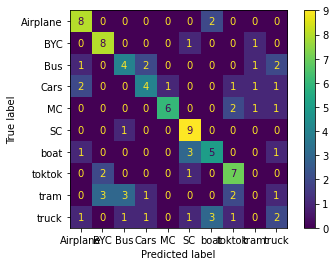

              precision    recall  f1-score   support

    Airplane       0.62      0.80      0.70        10
         BYC       0.62      0.80      0.70        10
         Bus       0.44      0.40      0.42        10
        Cars       0.50      0.40      0.44        10
          MC       0.86      0.60      0.71        10
          SC       0.60      0.90      0.72        10
        boat       0.50      0.50      0.50        10
      toktok       0.54      0.70      0.61        10
        tram       0.00      0.00      0.00        10
       truck       0.25      0.20      0.22        10

    accuracy                           0.53       100
   macro avg       0.49      0.53      0.50       100
weighted avg       0.49      0.53      0.50       100



In [71]:
#plot the confusion matrix and classification report of model1
plot_report_confusionMatrix(list(x_test_pred_1_cls),y_test_replaced)

<h4 style="color:darkBlue;"> Model 2 </h4> 

<Figure size 1152x1152 with 0 Axes>

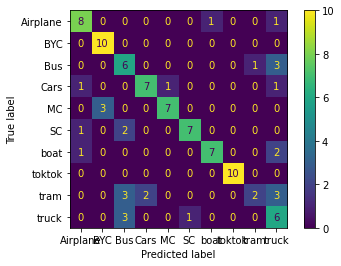

              precision    recall  f1-score   support

    Airplane       0.73      0.80      0.76        10
         BYC       0.77      1.00      0.87        10
         Bus       0.43      0.60      0.50        10
        Cars       0.78      0.70      0.74        10
          MC       0.88      0.70      0.78        10
          SC       0.88      0.70      0.78        10
        boat       0.88      0.70      0.78        10
      toktok       1.00      1.00      1.00        10
        tram       0.67      0.20      0.31        10
       truck       0.38      0.60      0.46        10

    accuracy                           0.70       100
   macro avg       0.74      0.70      0.70       100
weighted avg       0.74      0.70      0.70       100



In [74]:
#plot the confusion matrix and classification report of model2
plot_report_confusionMatrix(x_test_pred_2_cls,y_test_replaced)

<h4 style="color:darkBlue;"> Model 3 </h4> 

<Figure size 1152x1152 with 0 Axes>

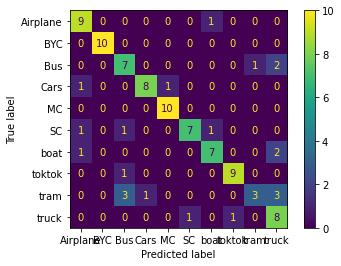

              precision    recall  f1-score   support

    Airplane       0.75      0.90      0.82        10
         BYC       1.00      1.00      1.00        10
         Bus       0.58      0.70      0.64        10
        Cars       0.89      0.80      0.84        10
          MC       0.91      1.00      0.95        10
          SC       0.88      0.70      0.78        10
        boat       0.78      0.70      0.74        10
      toktok       0.90      0.90      0.90        10
        tram       0.75      0.30      0.43        10
       truck       0.53      0.80      0.64        10

    accuracy                           0.78       100
   macro avg       0.80      0.78      0.77       100
weighted avg       0.80      0.78      0.77       100



In [75]:
#plot the confusion matrix and classification report of model3
plot_report_confusionMatrix(x_test_pred_3_cls,y_test_replaced)

### Visualize the feature maps of each model

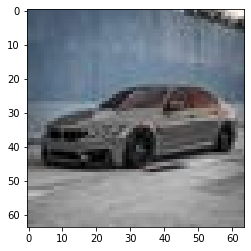

In [199]:
test_img = X_test[1].copy()

plt.imshow(test_img)
plt.show()

conv2d_input (1, 64, 64, 3) 


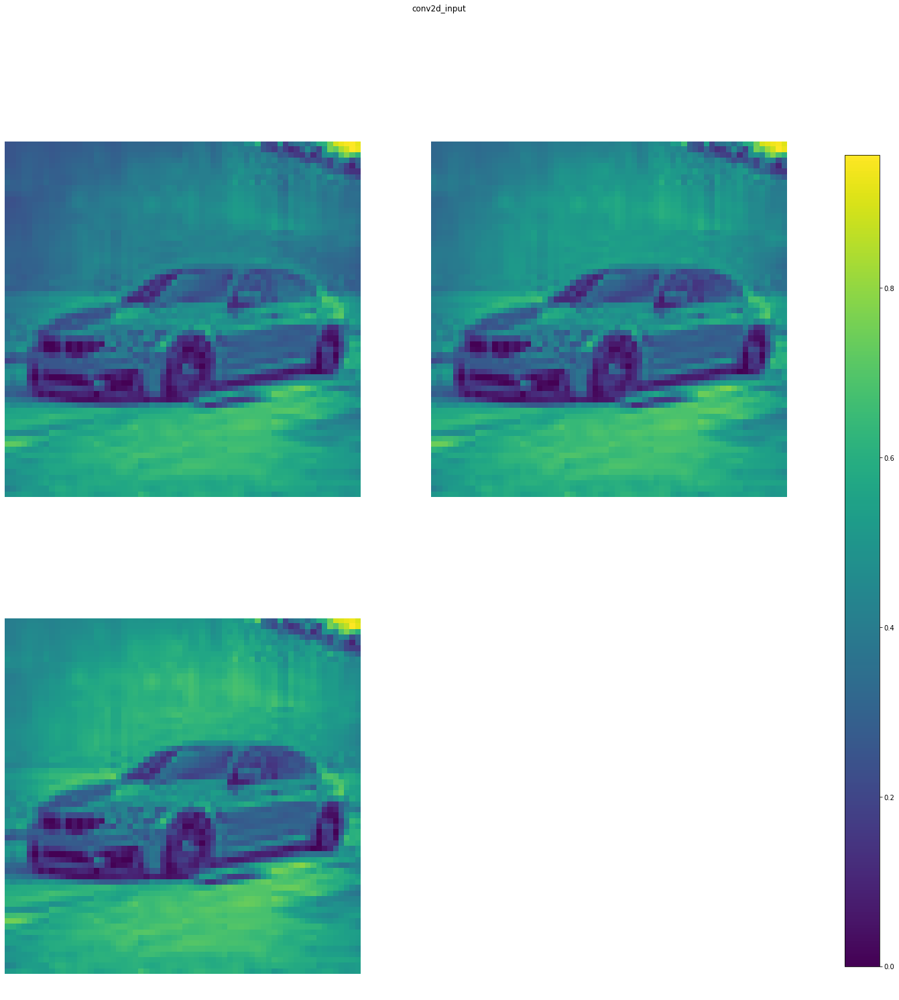

conv2d (1, 62, 62, 64) 


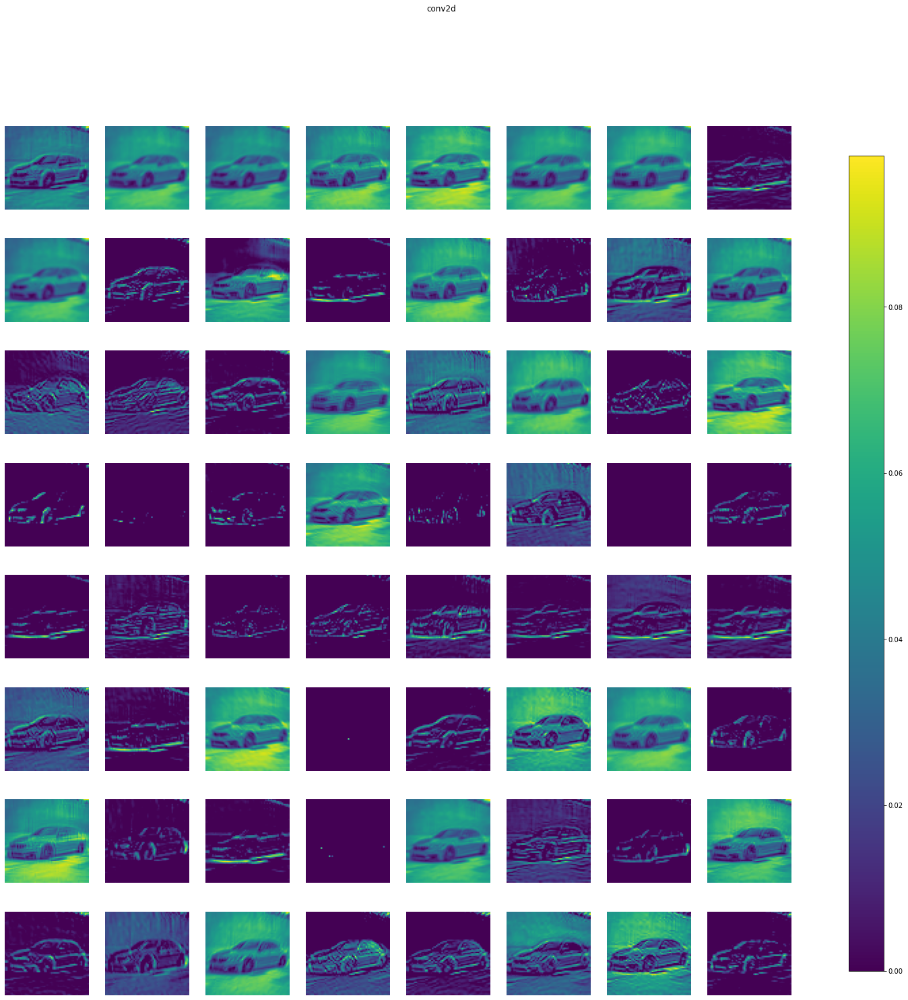

max_pooling2d (1, 31, 31, 64) 


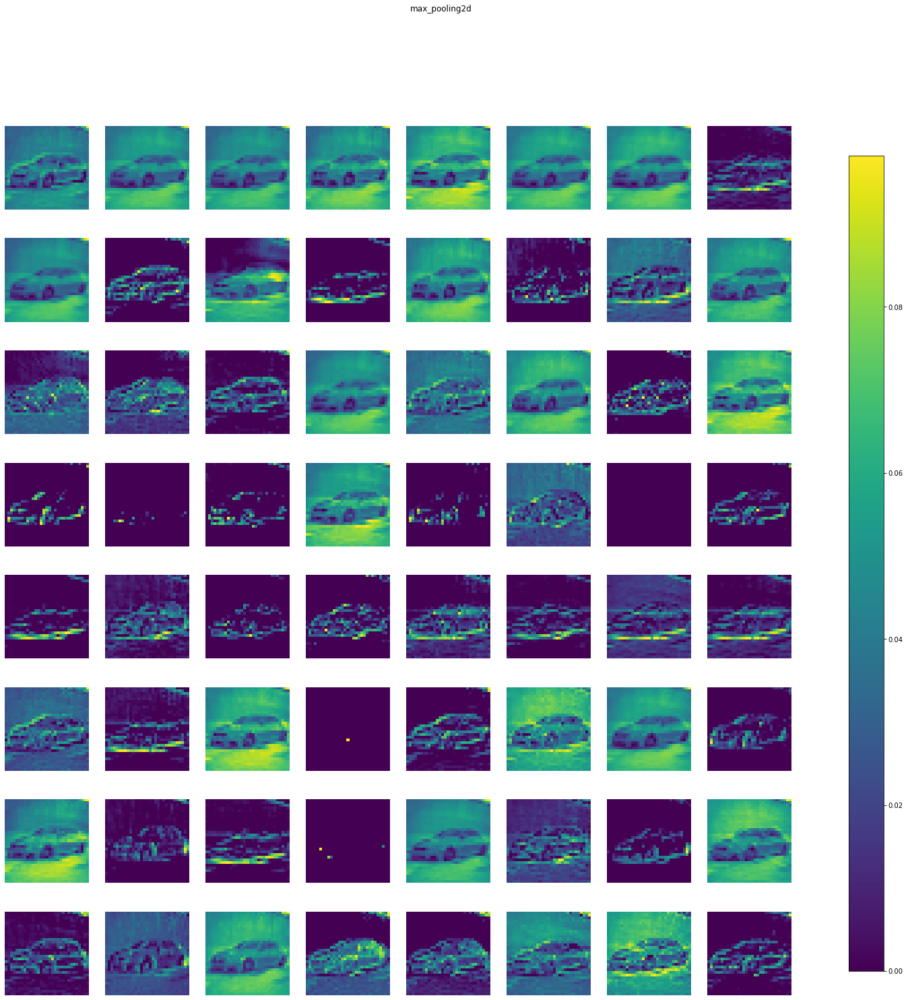

conv2d_1 (1, 29, 29, 64) 


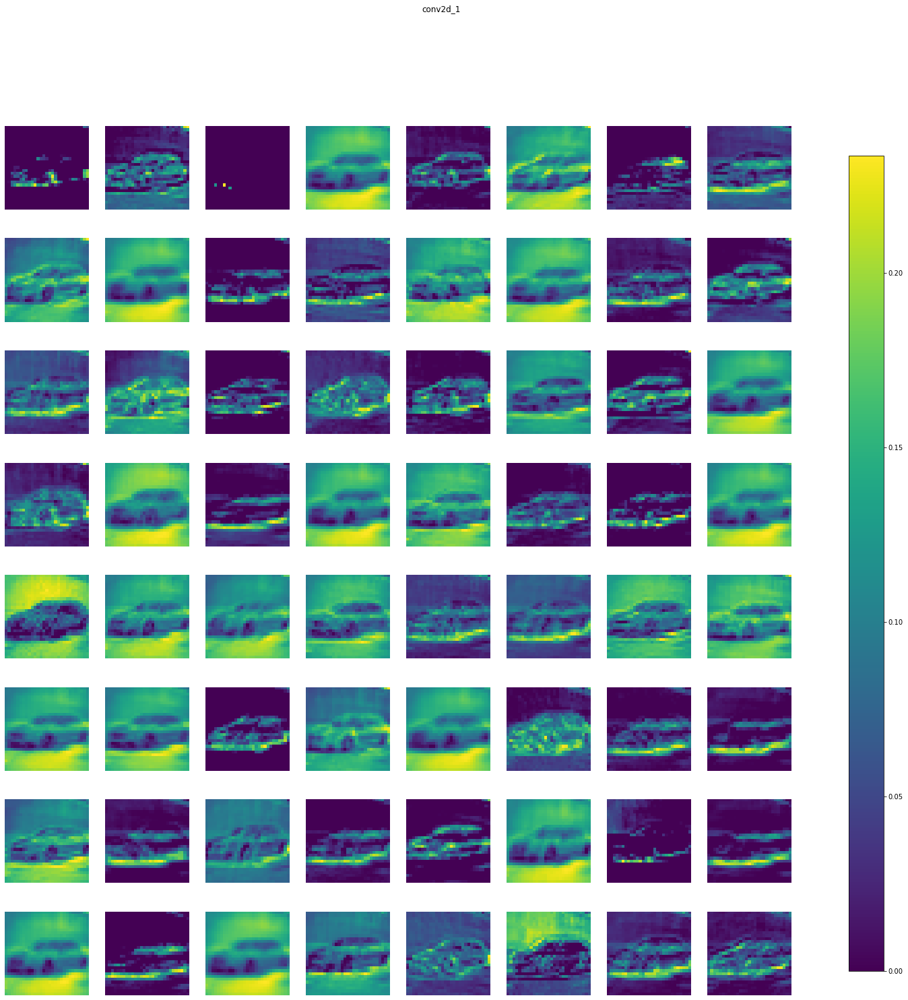

max_pooling2d_1 (1, 14, 14, 64) 


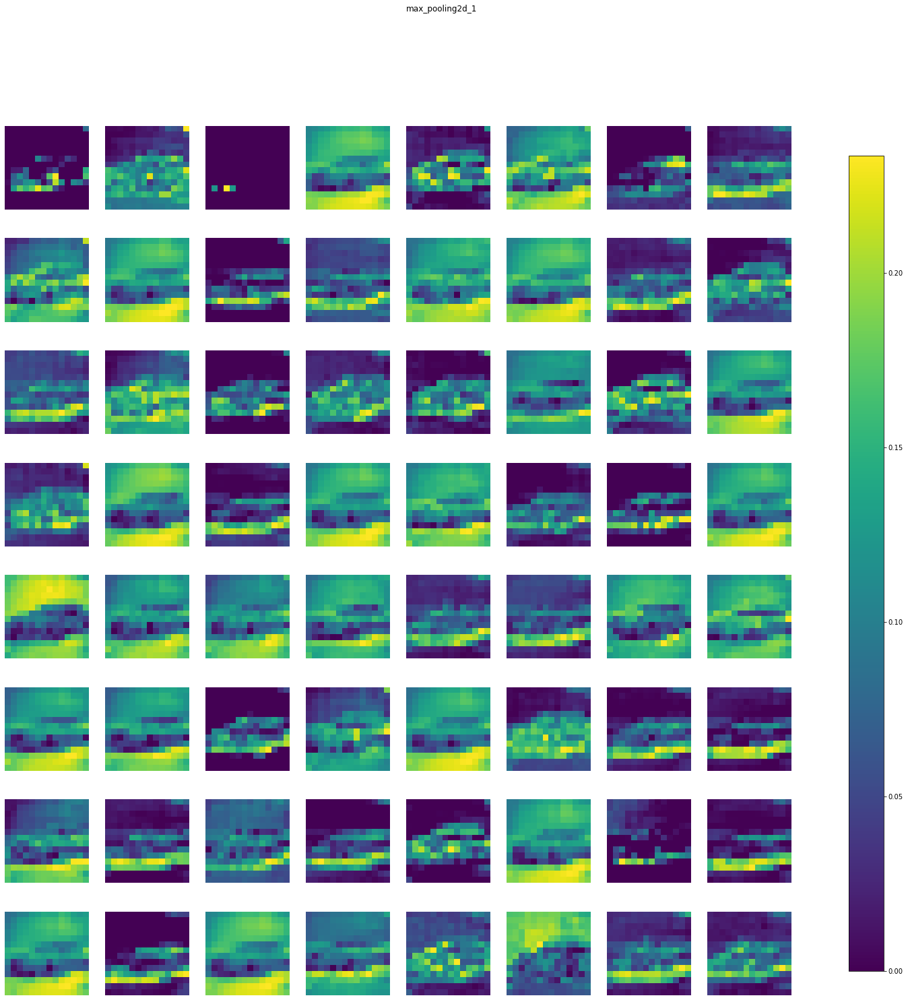

conv2d_2 (1, 12, 12, 128) 


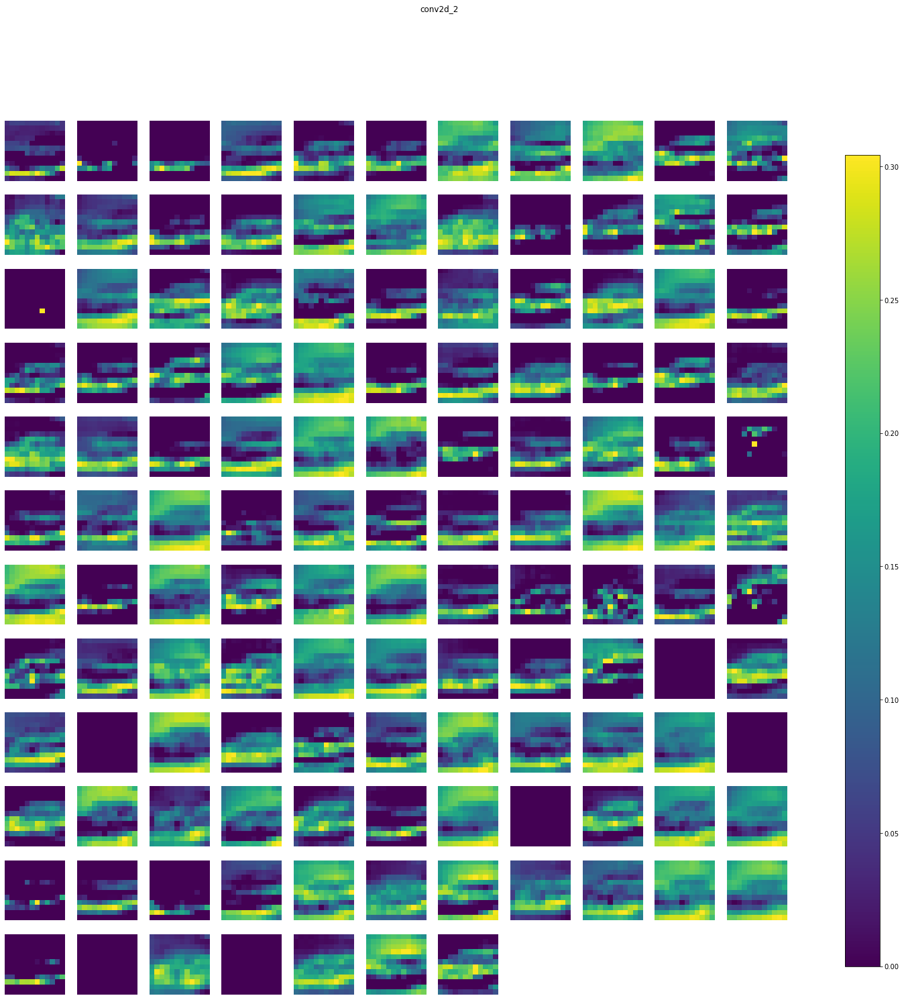

max_pooling2d_2 (1, 6, 6, 128) 


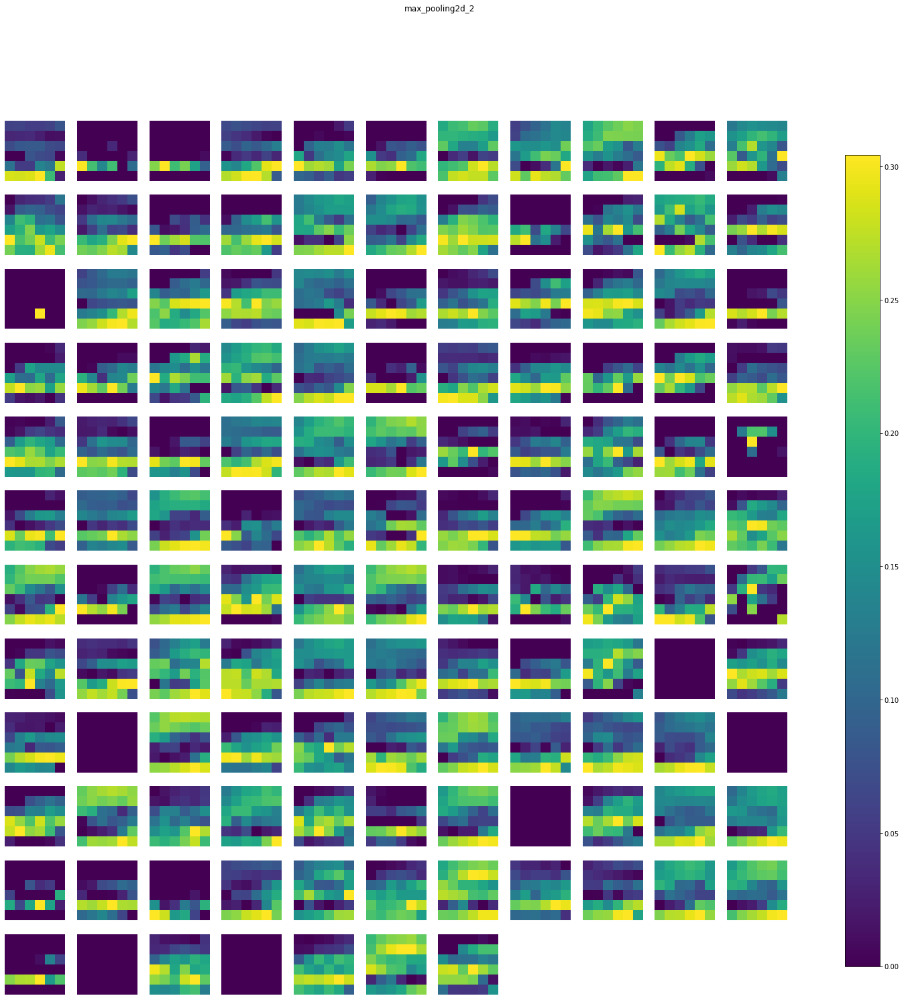

conv2d_3 (1, 4, 4, 128) 


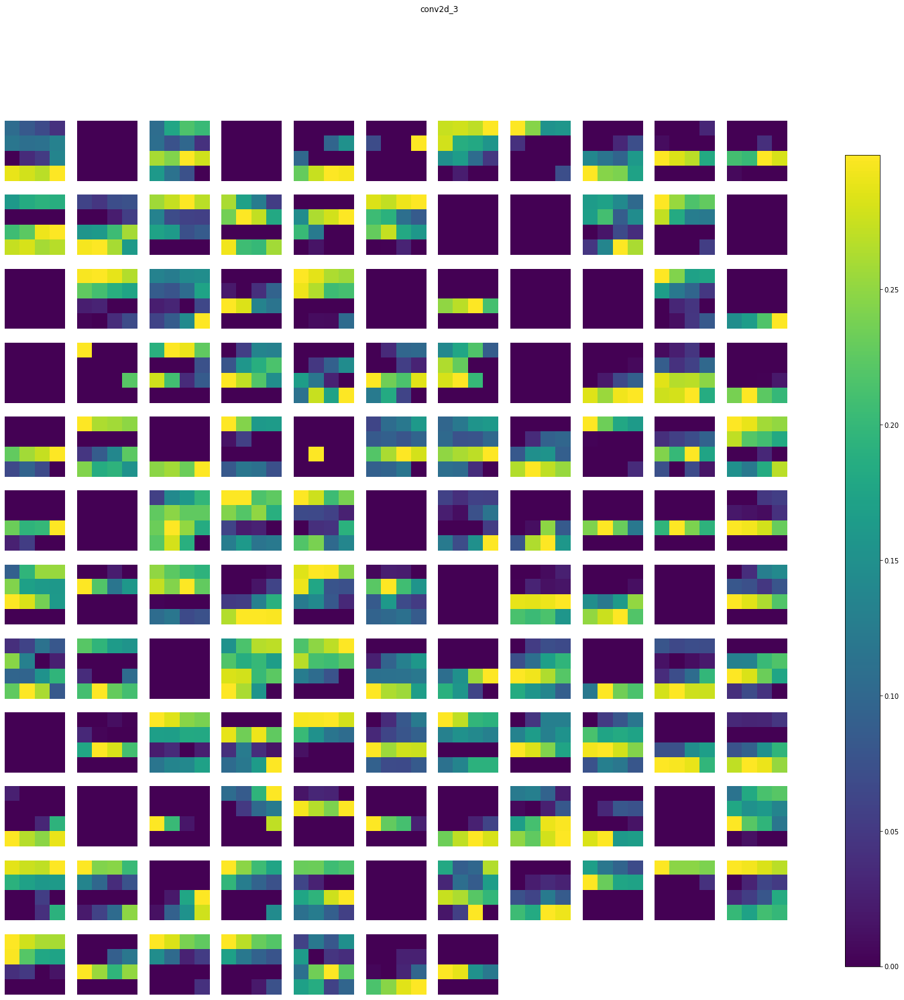

max_pooling2d_3 (1, 2, 2, 128) 


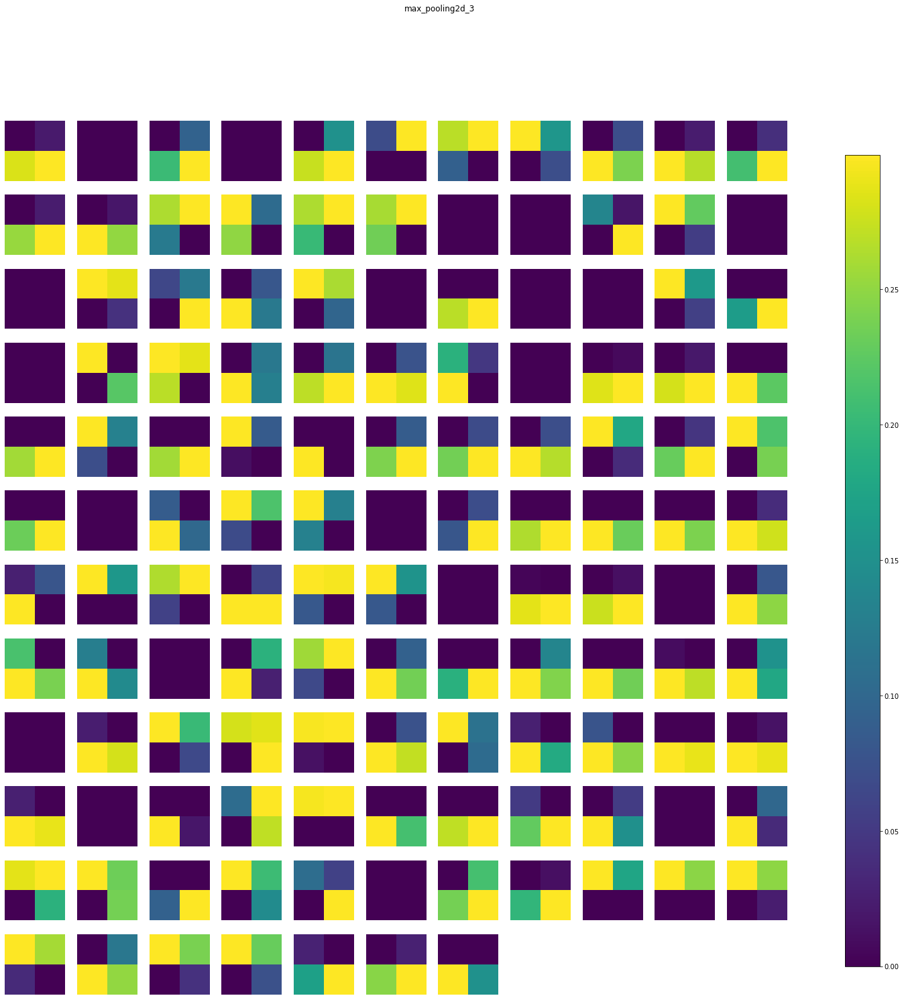

flatten (1, 512) 


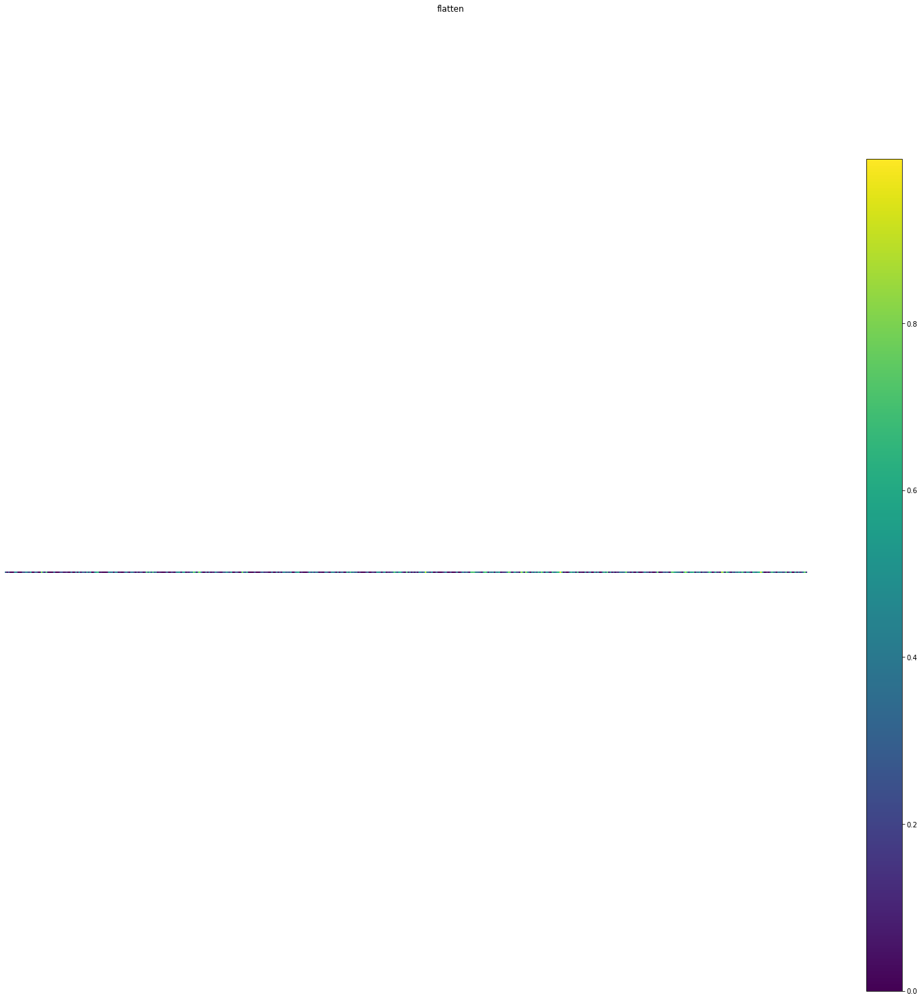

dropout (1, 512) 


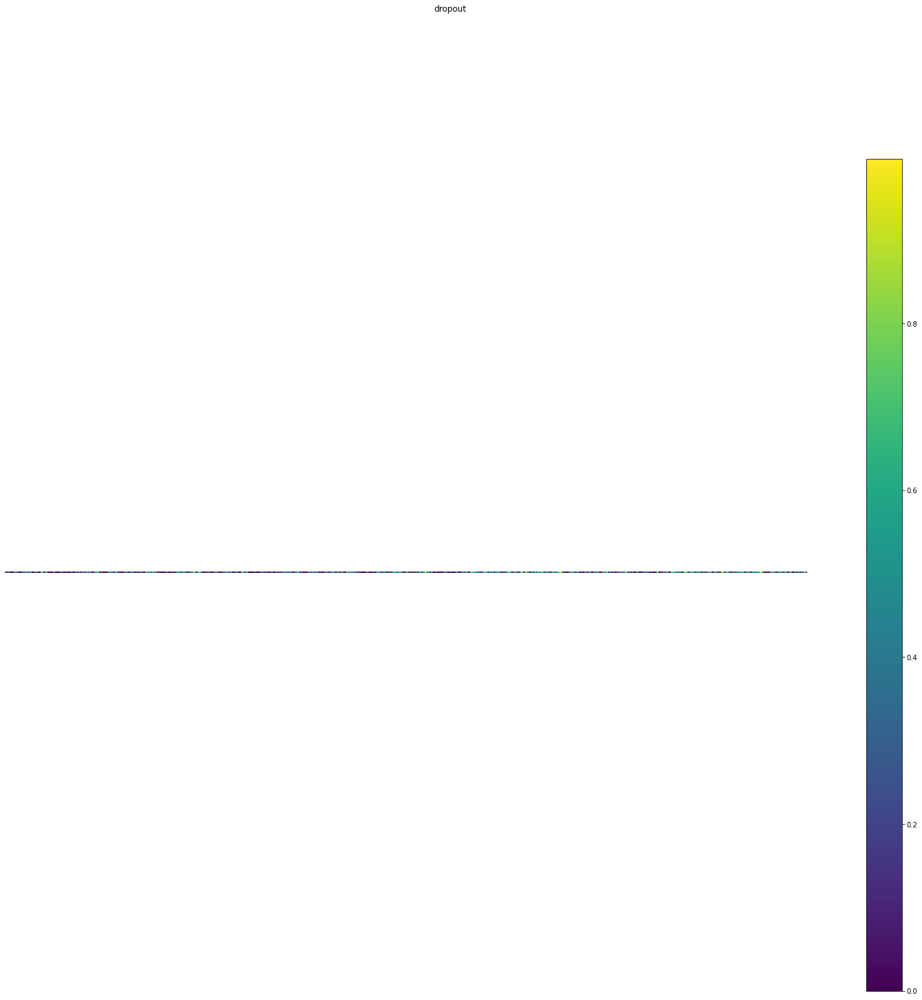

dense (1, 512) 


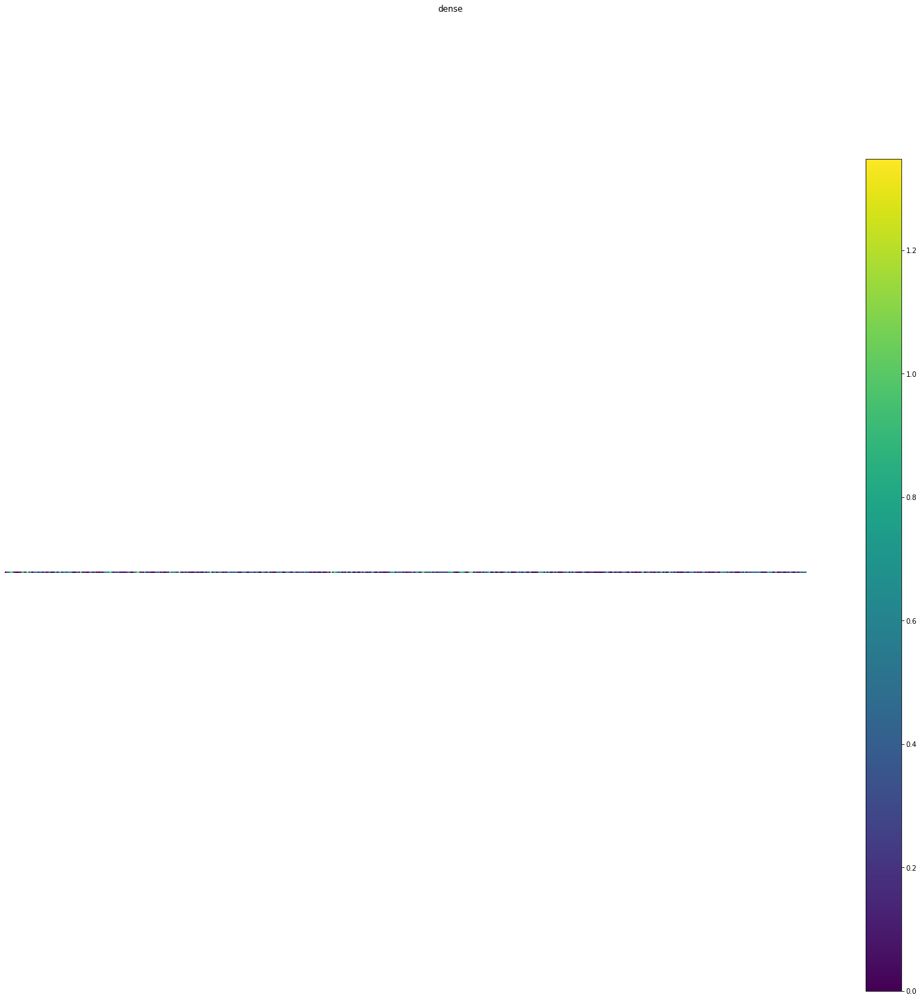

dense_1 (1, 10) 


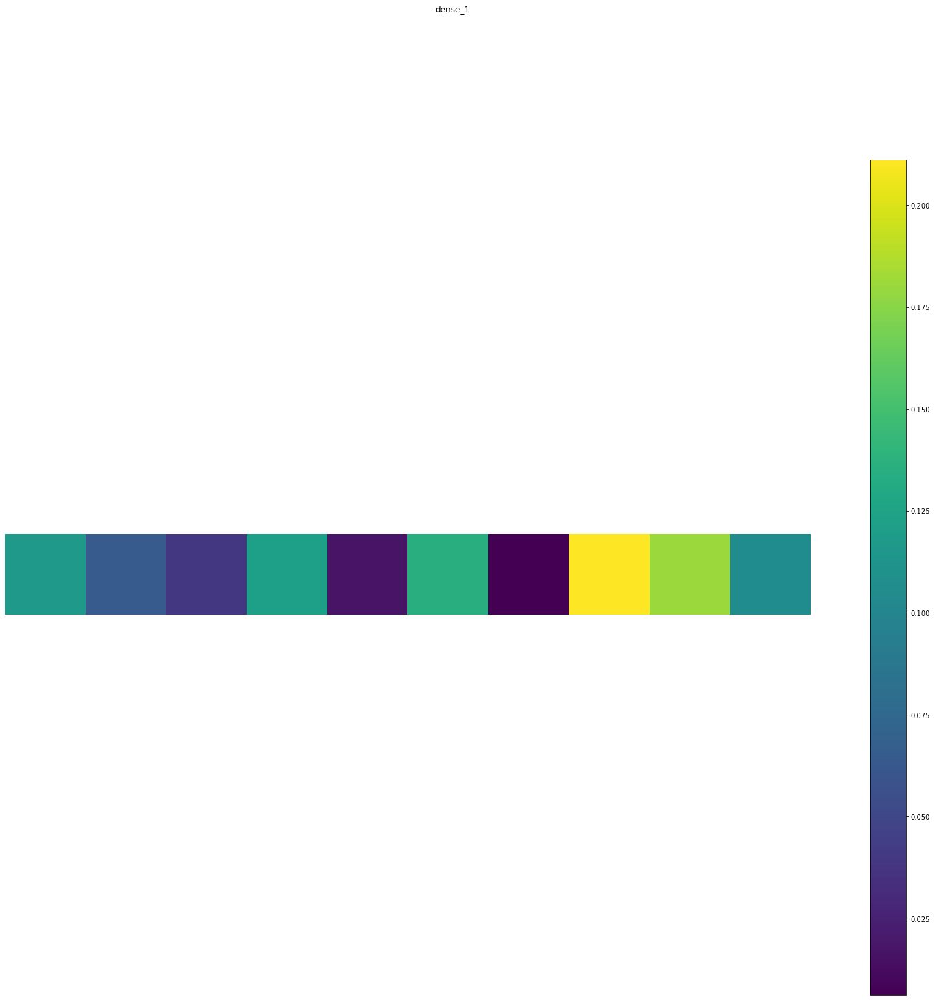

In [100]:
#visualze the feature maps learned by model 1
visualize_activation_maps_learned_by_model(model_1,test_img)

input_1 (1, 64, 64, 3) 


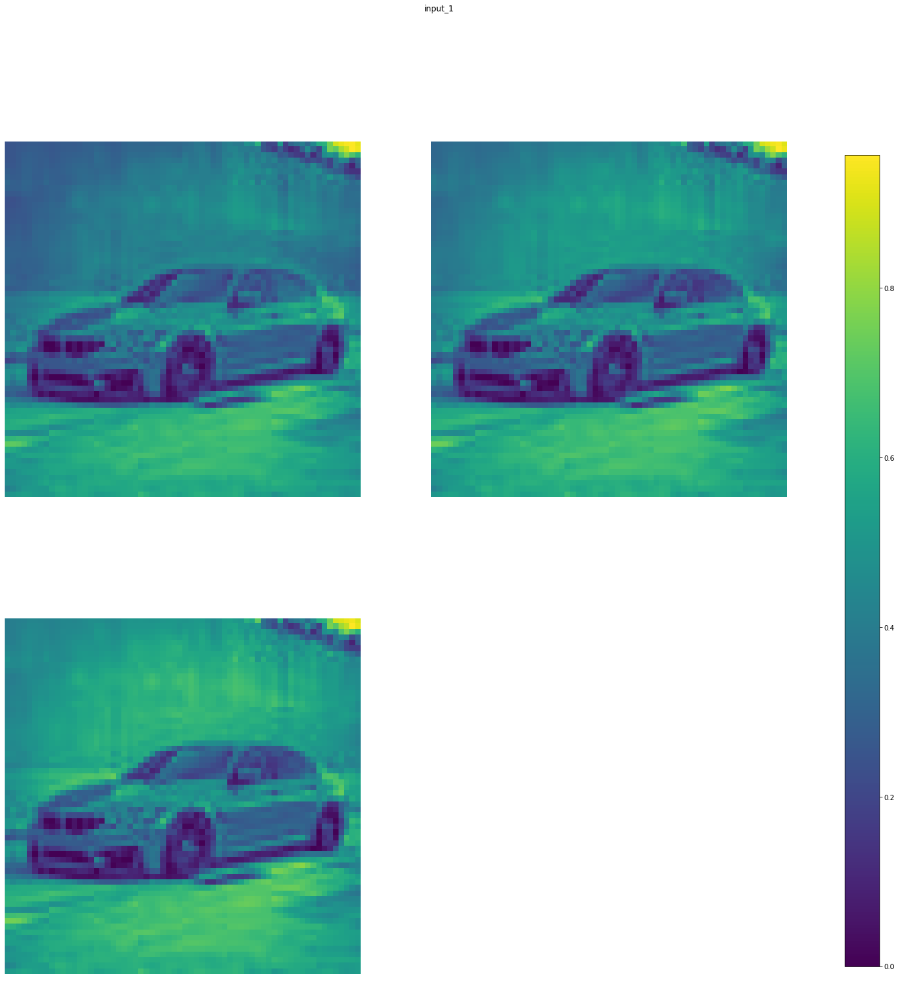

block1_conv1 (1, 64, 64, 64) 


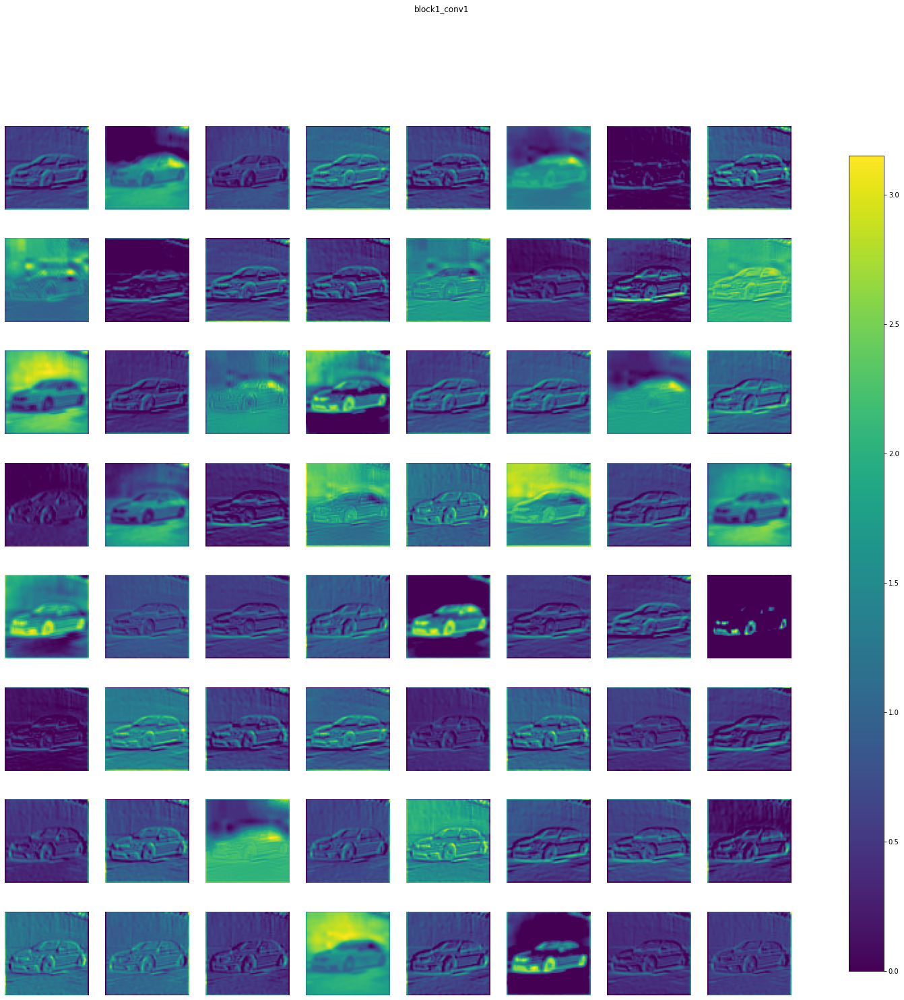

block1_conv2 (1, 64, 64, 64) 


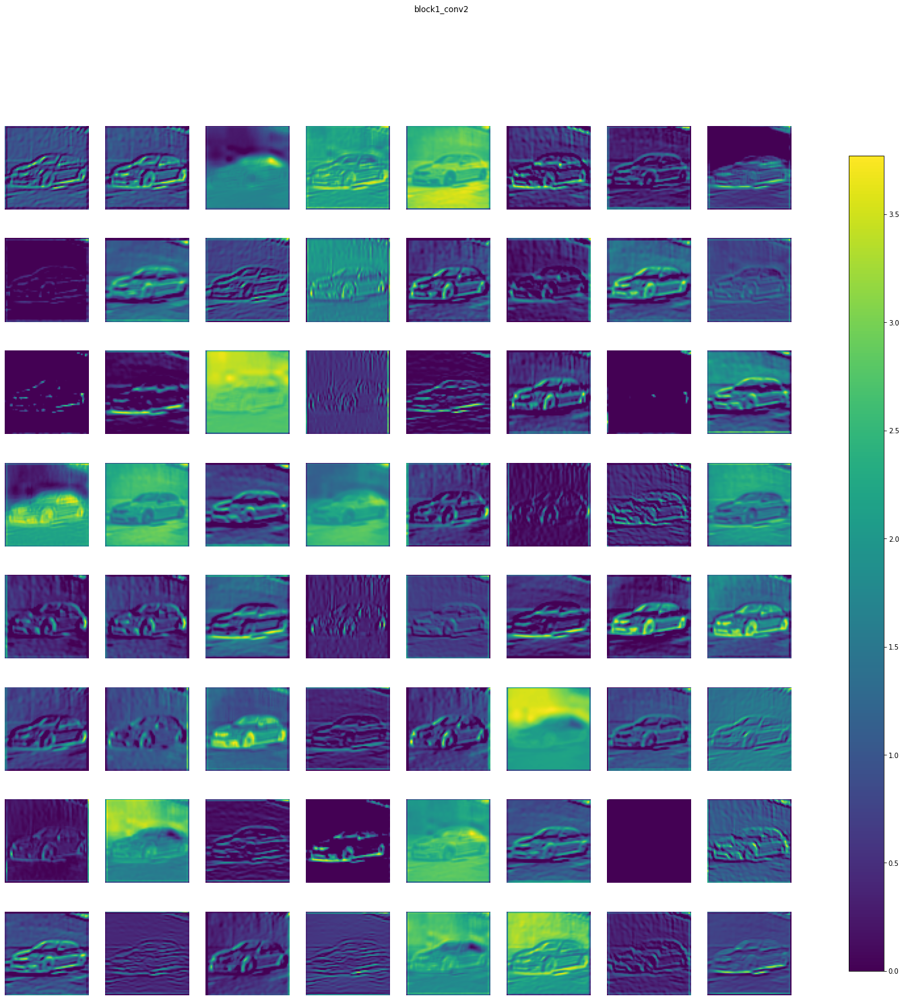

block1_pool (1, 32, 32, 64) 


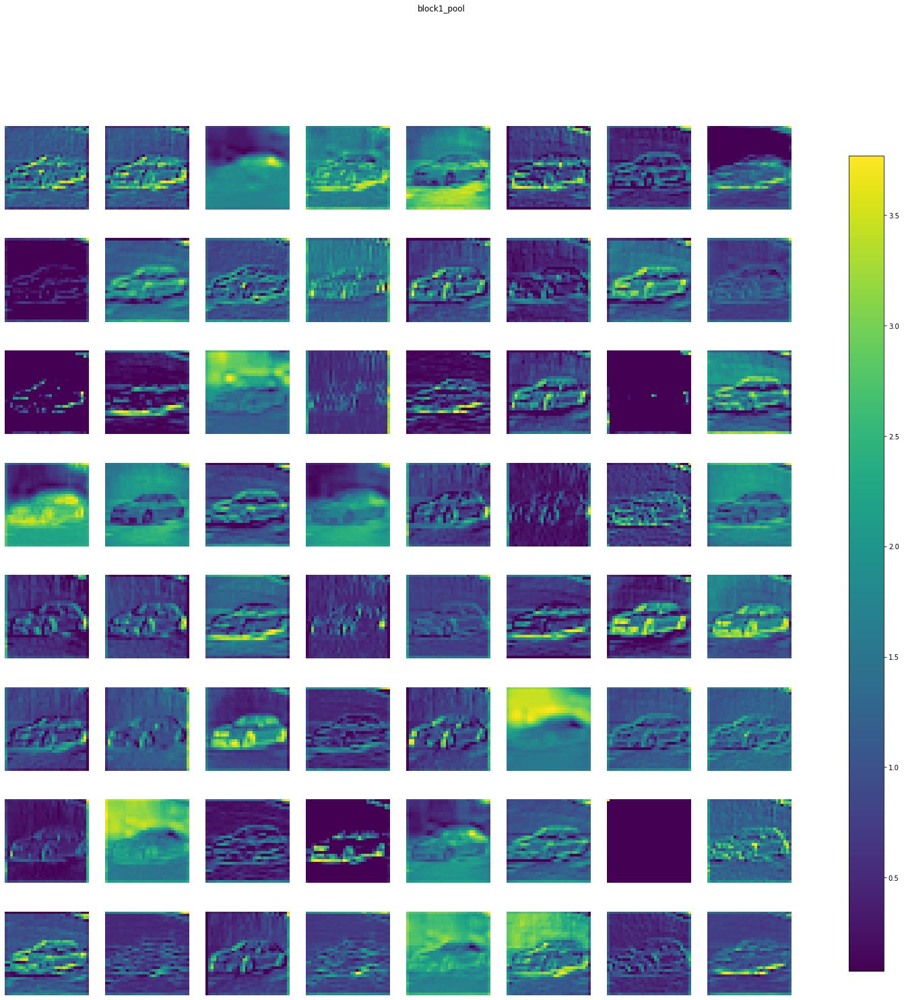

block2_conv1 (1, 32, 32, 128) 


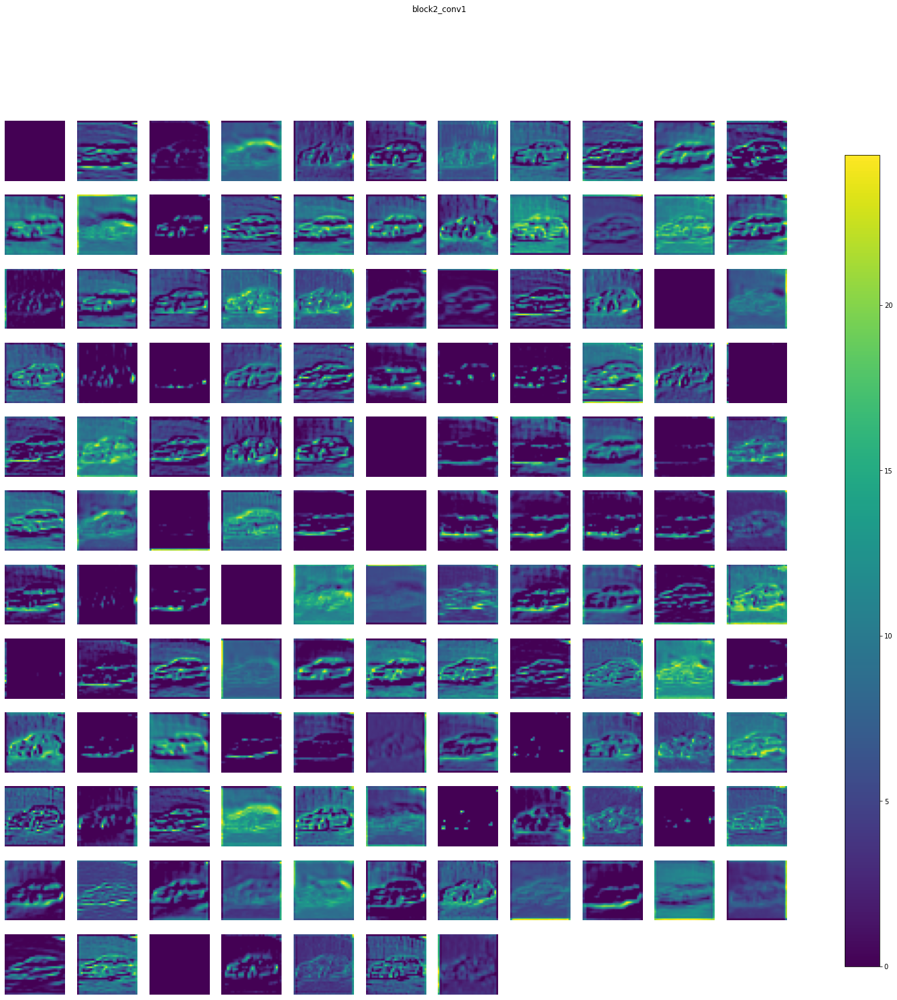

block2_conv2 (1, 32, 32, 128) 


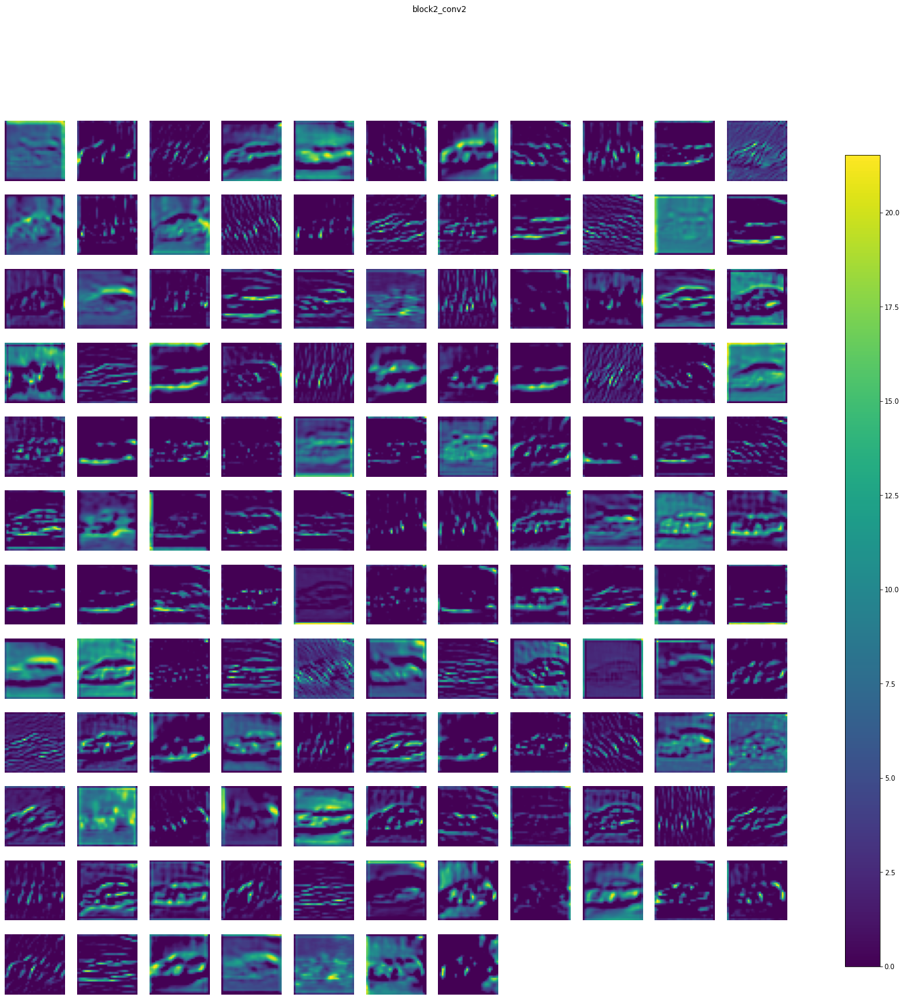

block2_pool (1, 16, 16, 128) 


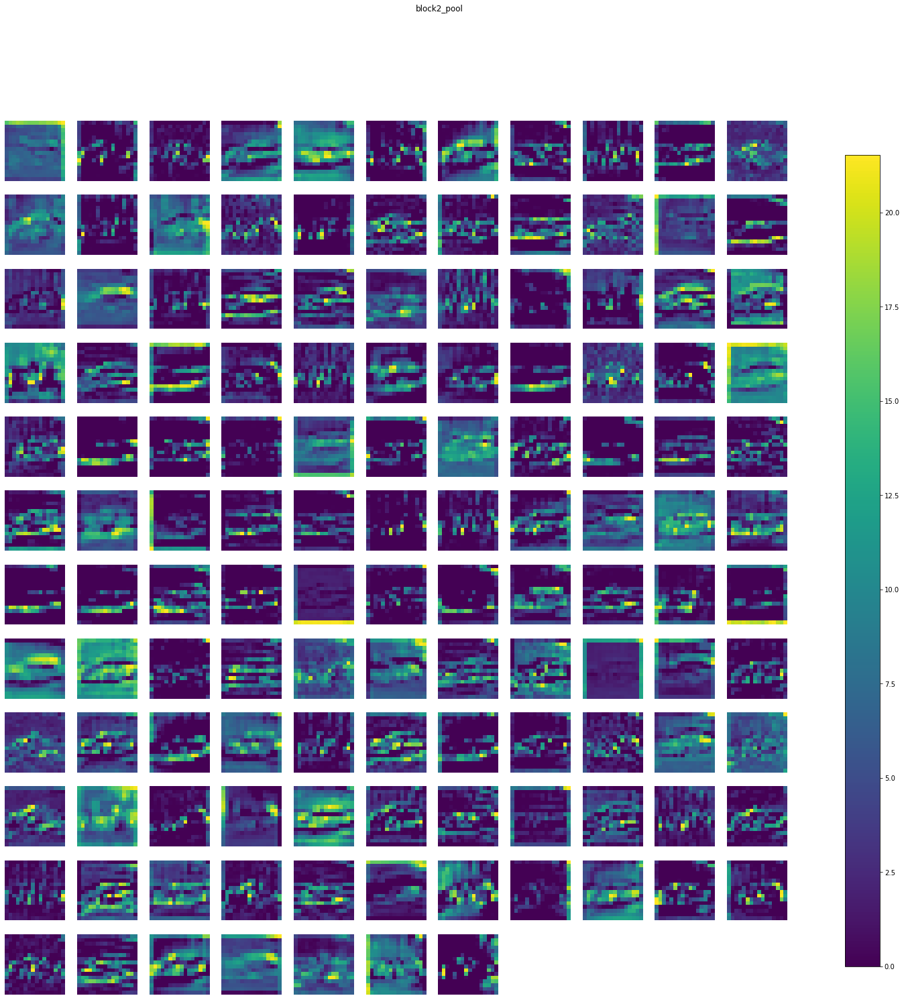

block3_conv1 (1, 16, 16, 256) 


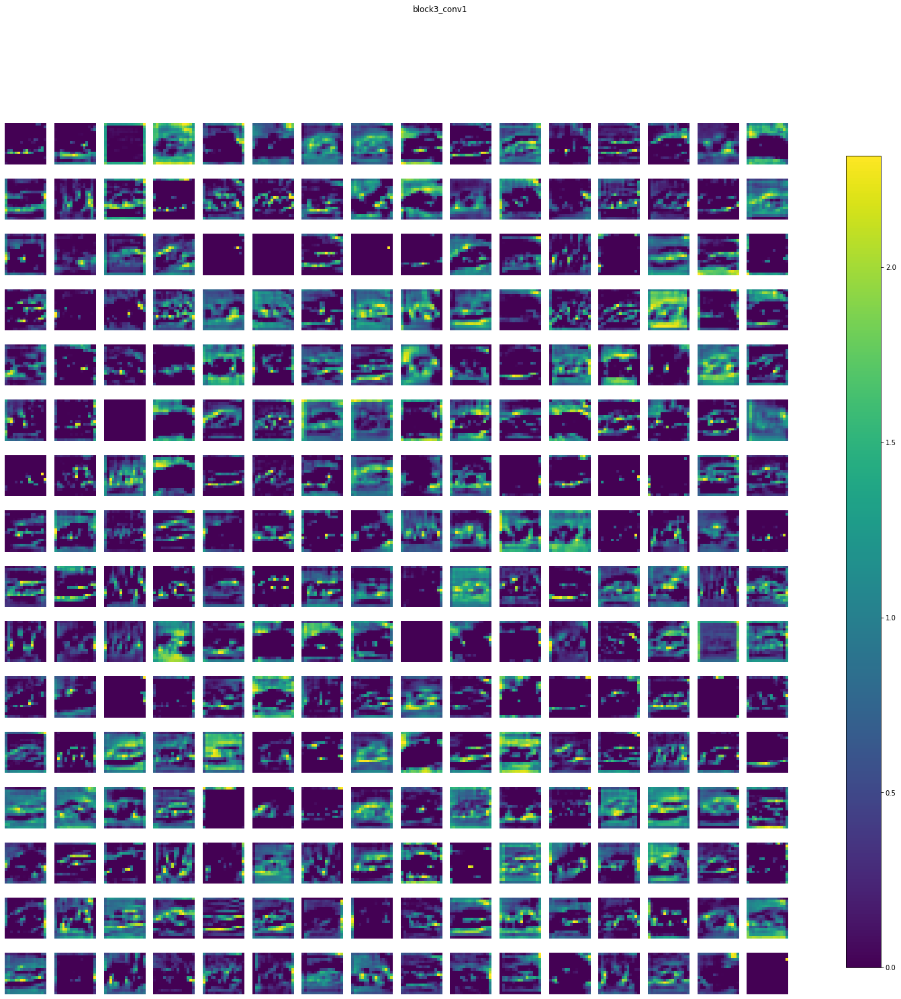

block3_conv2 (1, 16, 16, 256) 


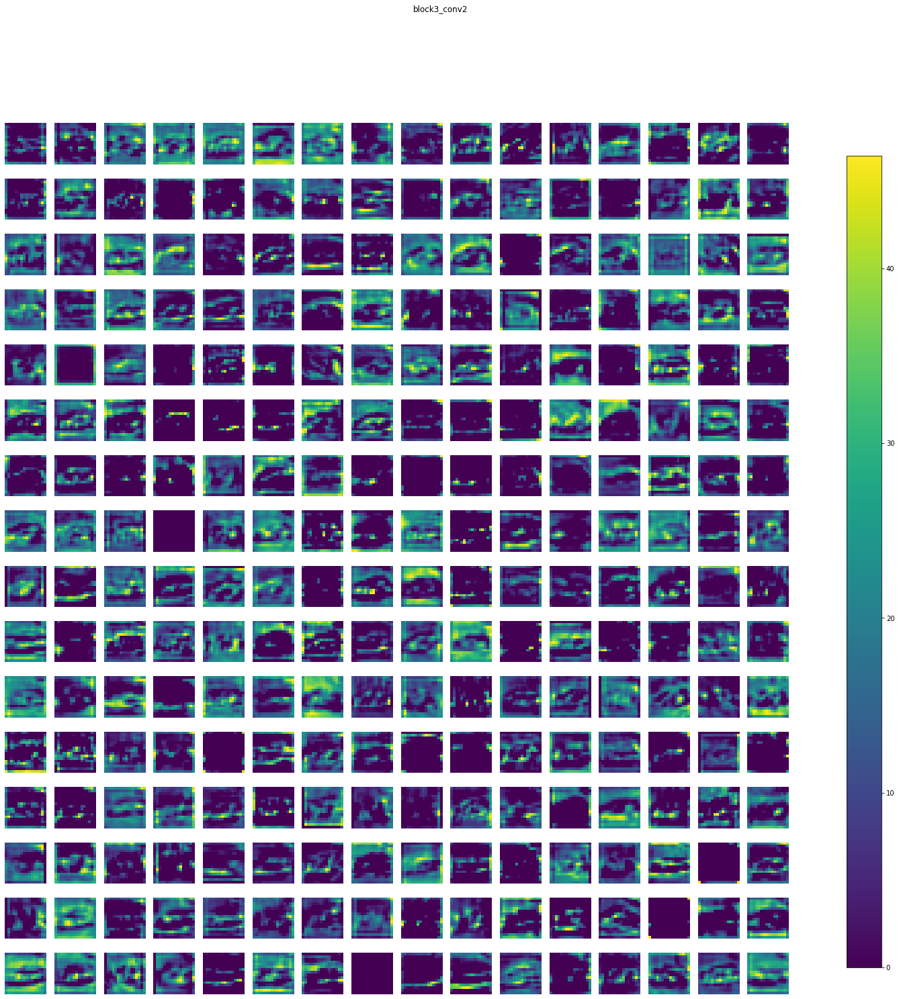

block3_conv3 (1, 16, 16, 256) 


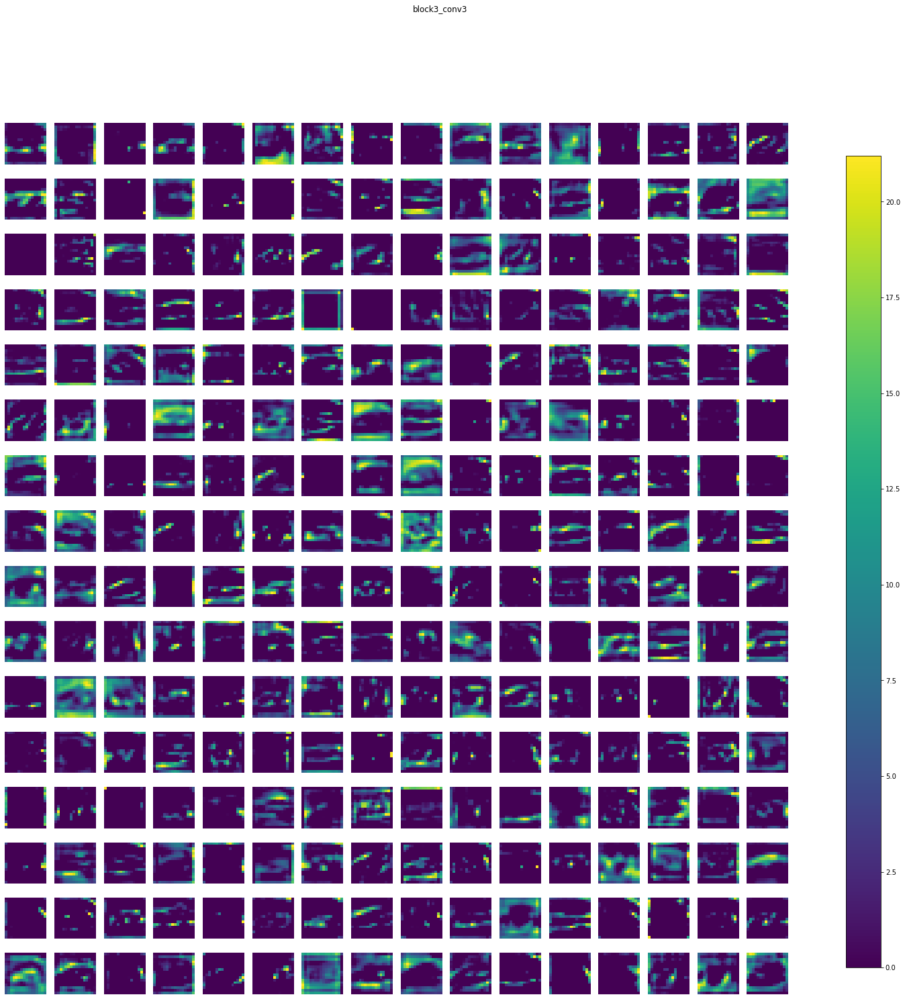

block3_pool (1, 8, 8, 256) 


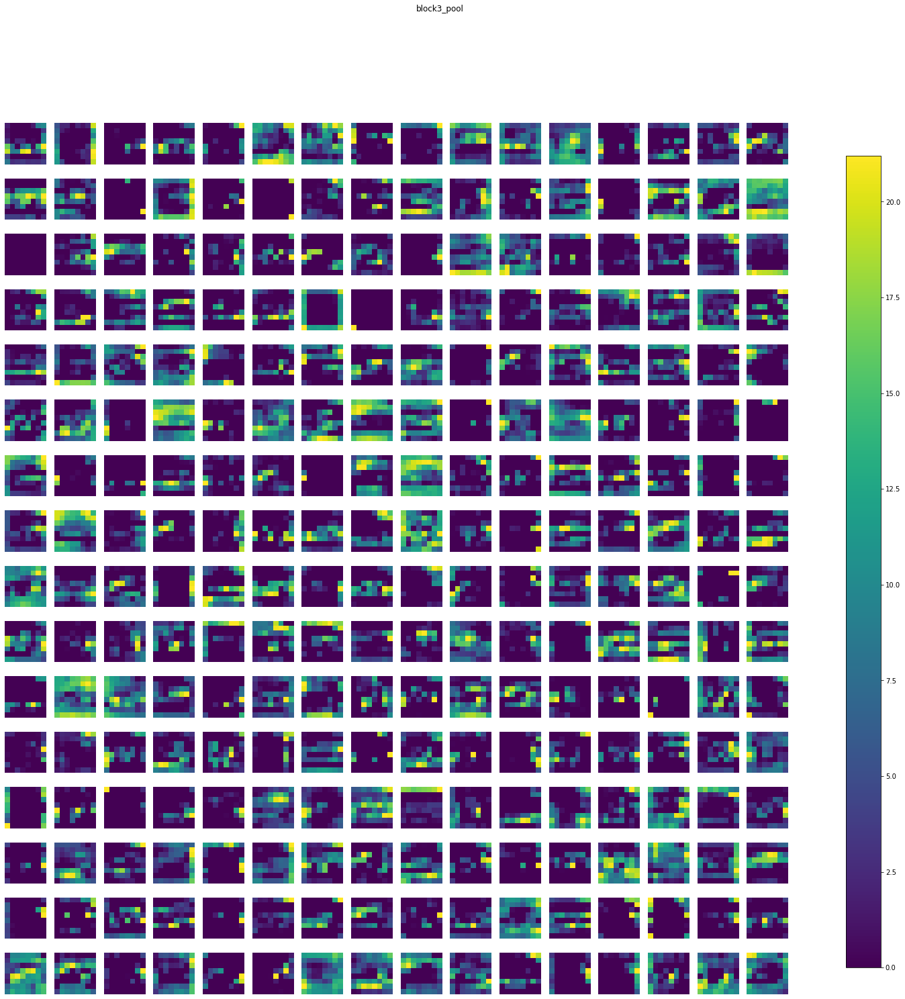

block4_conv1 (1, 8, 8, 512) 


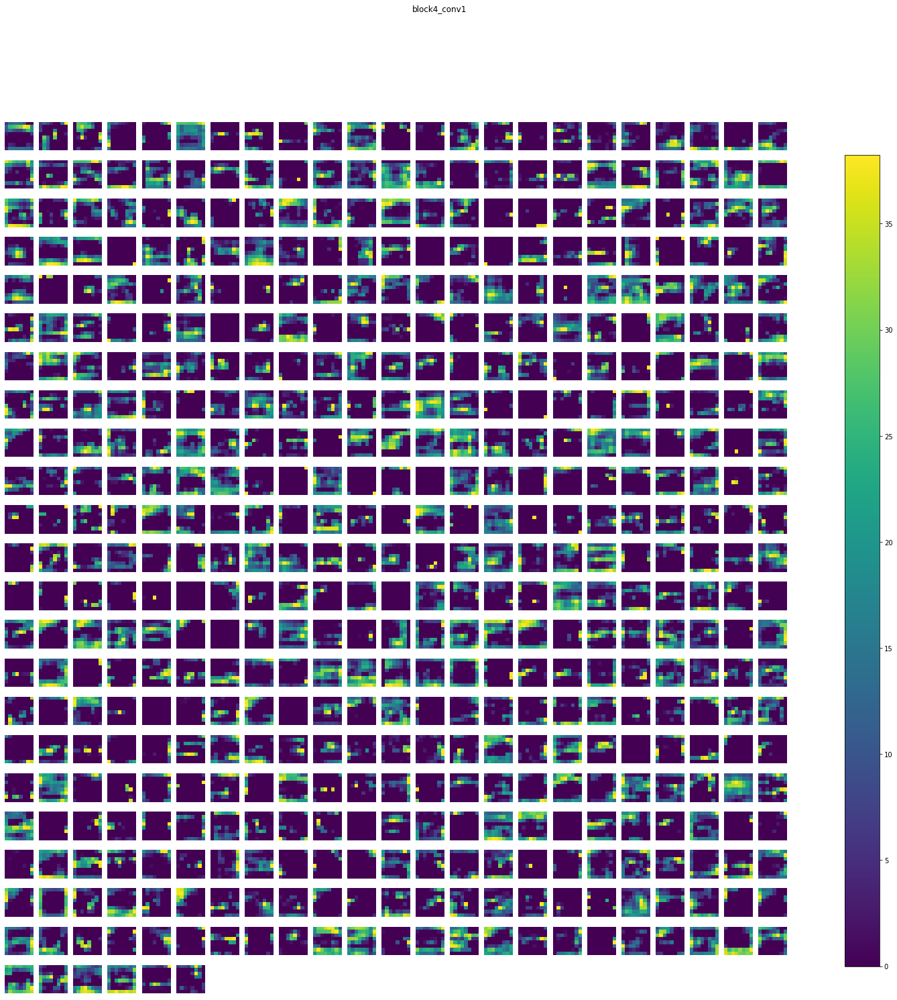

block4_conv2 (1, 8, 8, 512) 


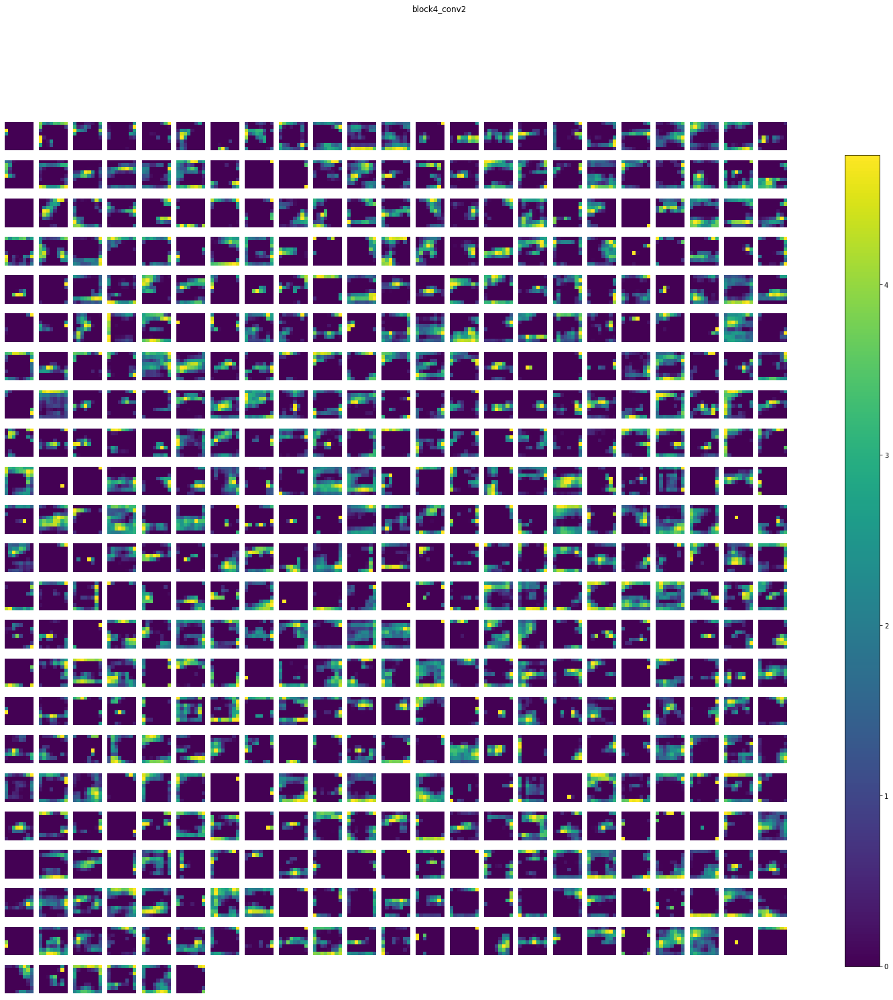

block4_conv3 (1, 8, 8, 512) 


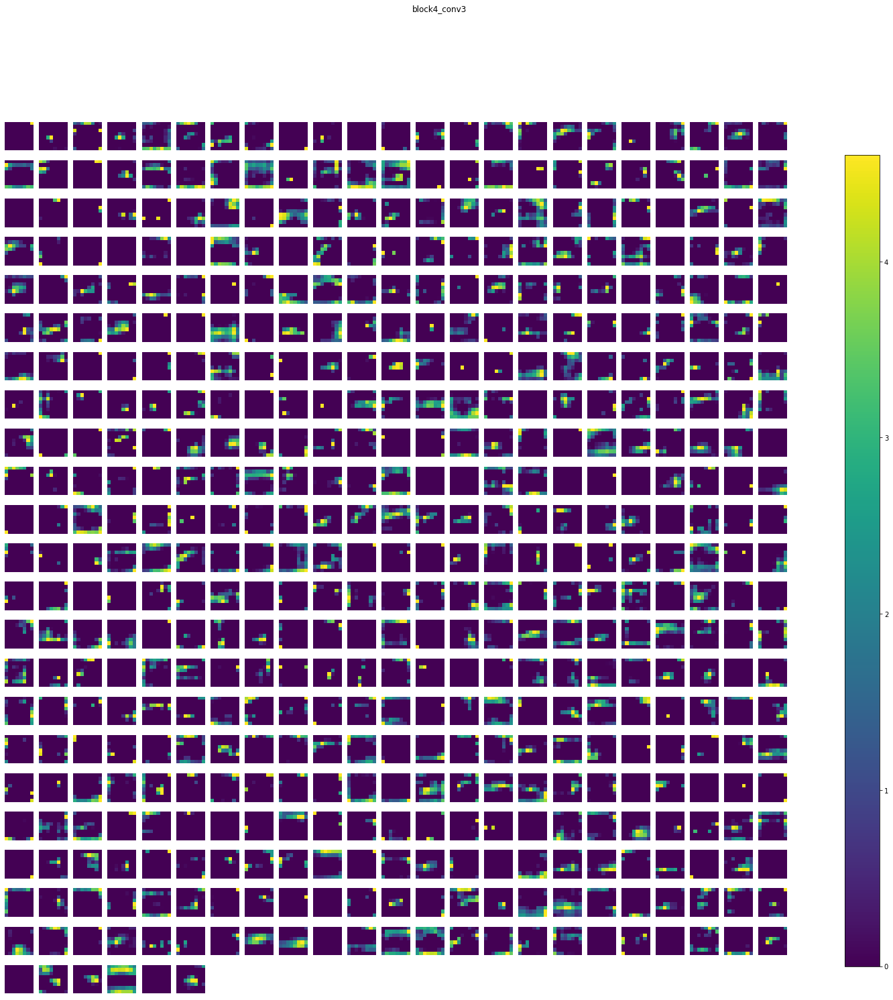

block4_pool (1, 4, 4, 512) 


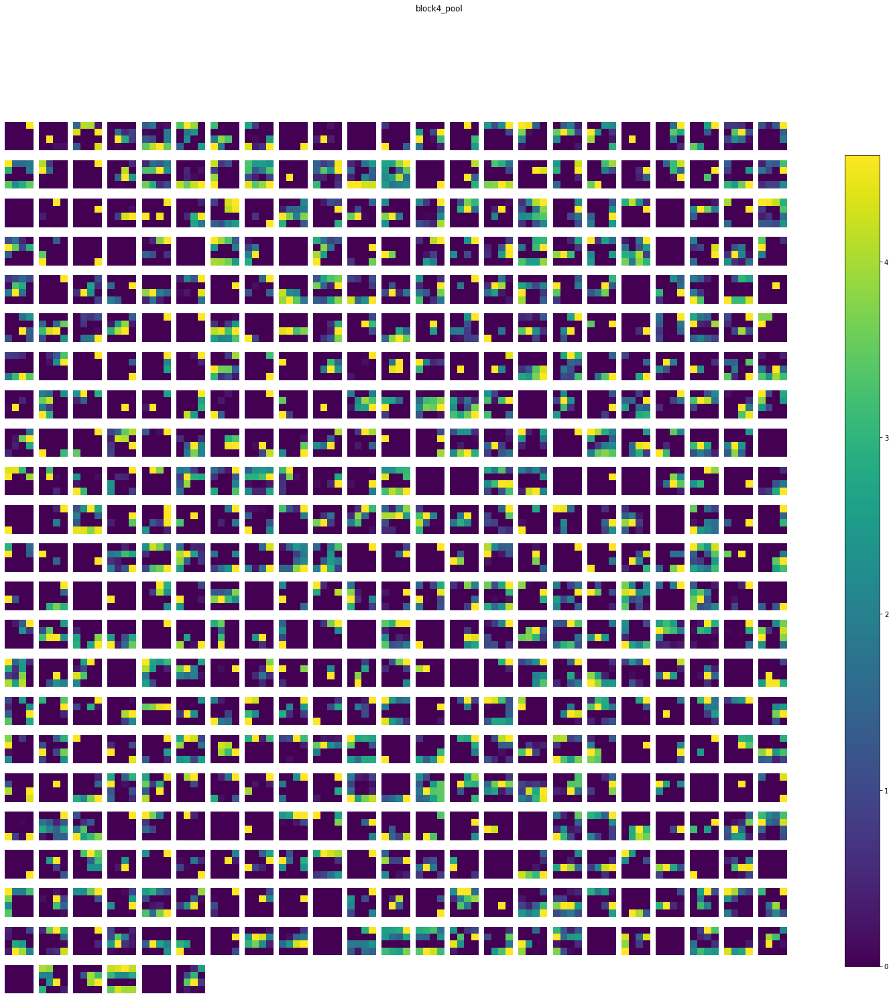

block5_conv1 (1, 4, 4, 512) 


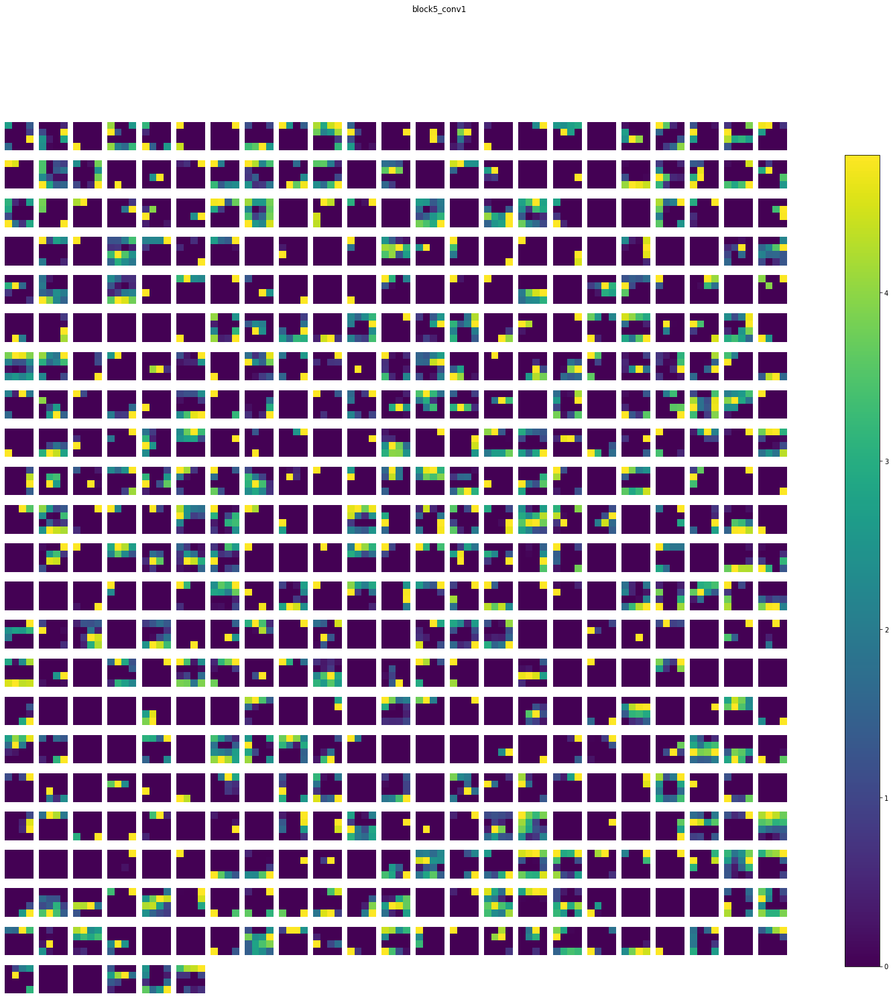

block5_conv2 (1, 4, 4, 512) 


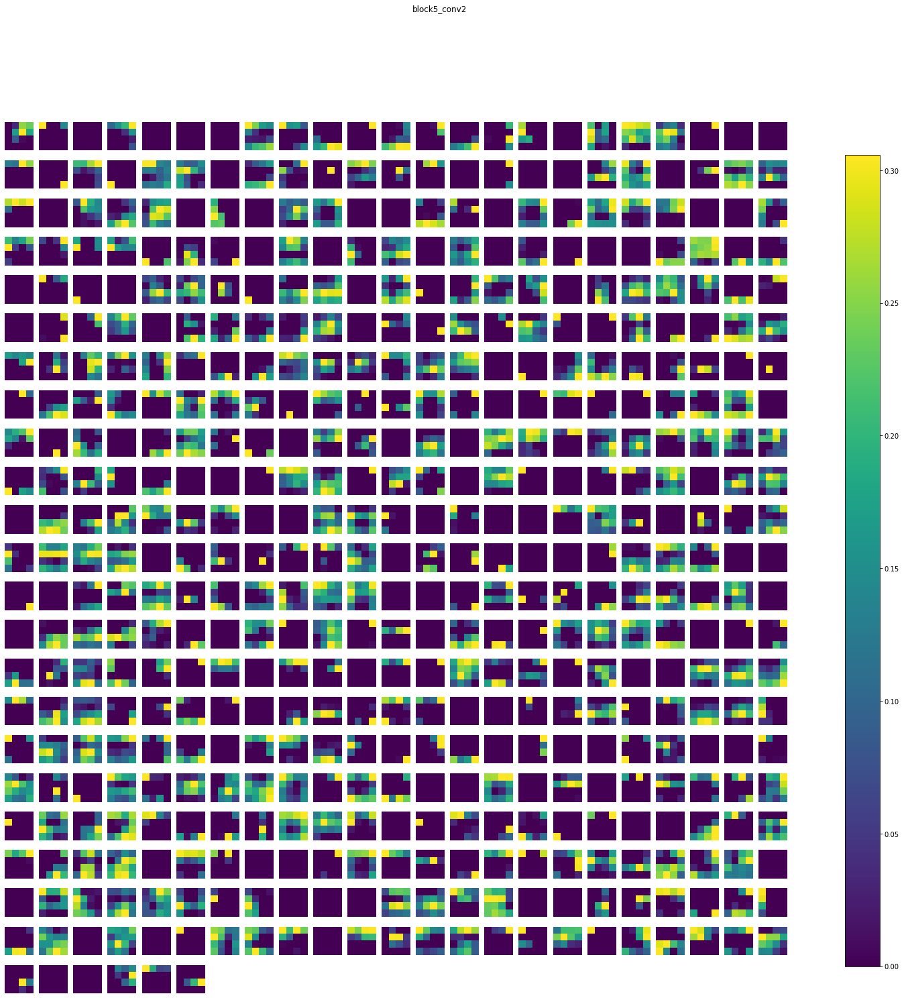

block5_conv3 (1, 4, 4, 512) 


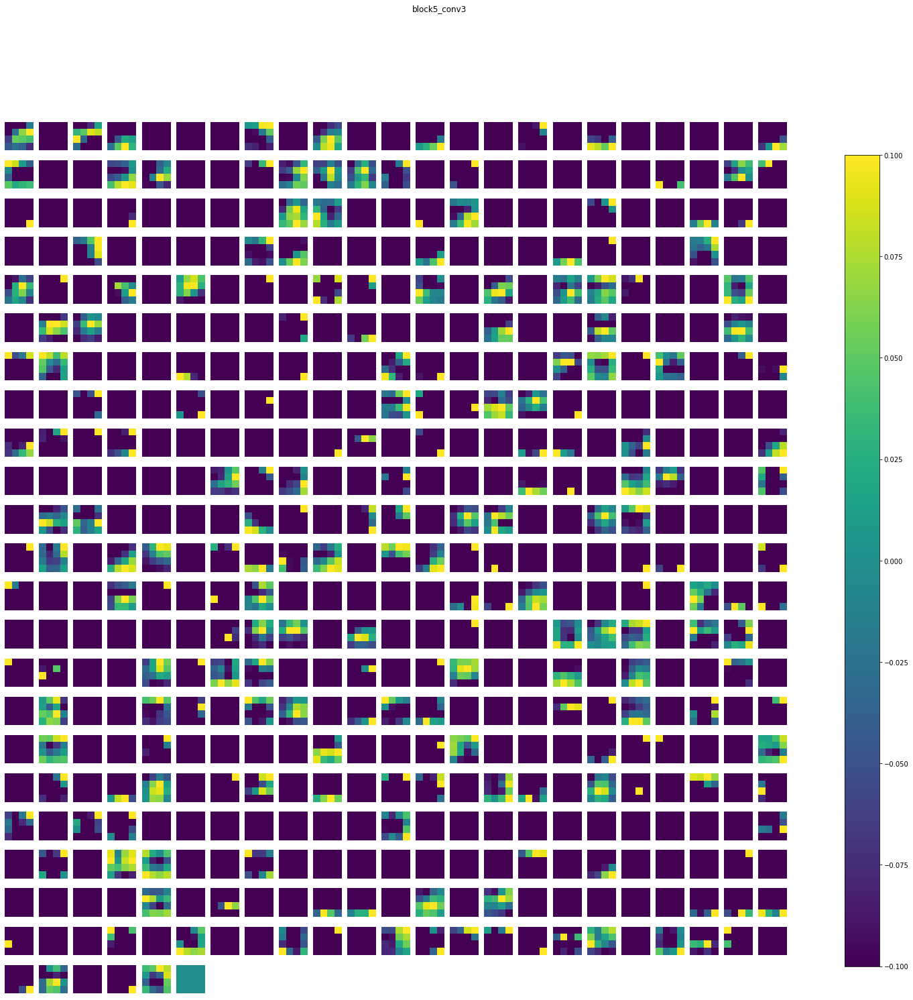

block5_pool (1, 2, 2, 512) 


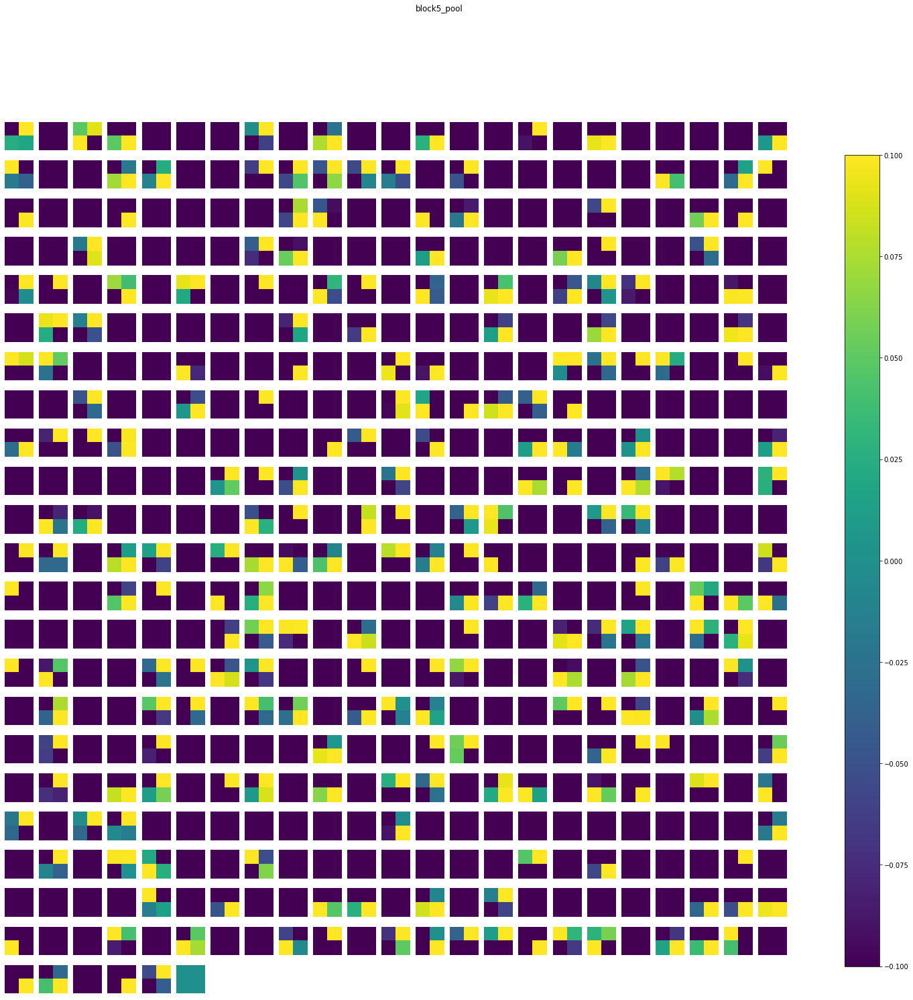

flatten (1, 2048) 


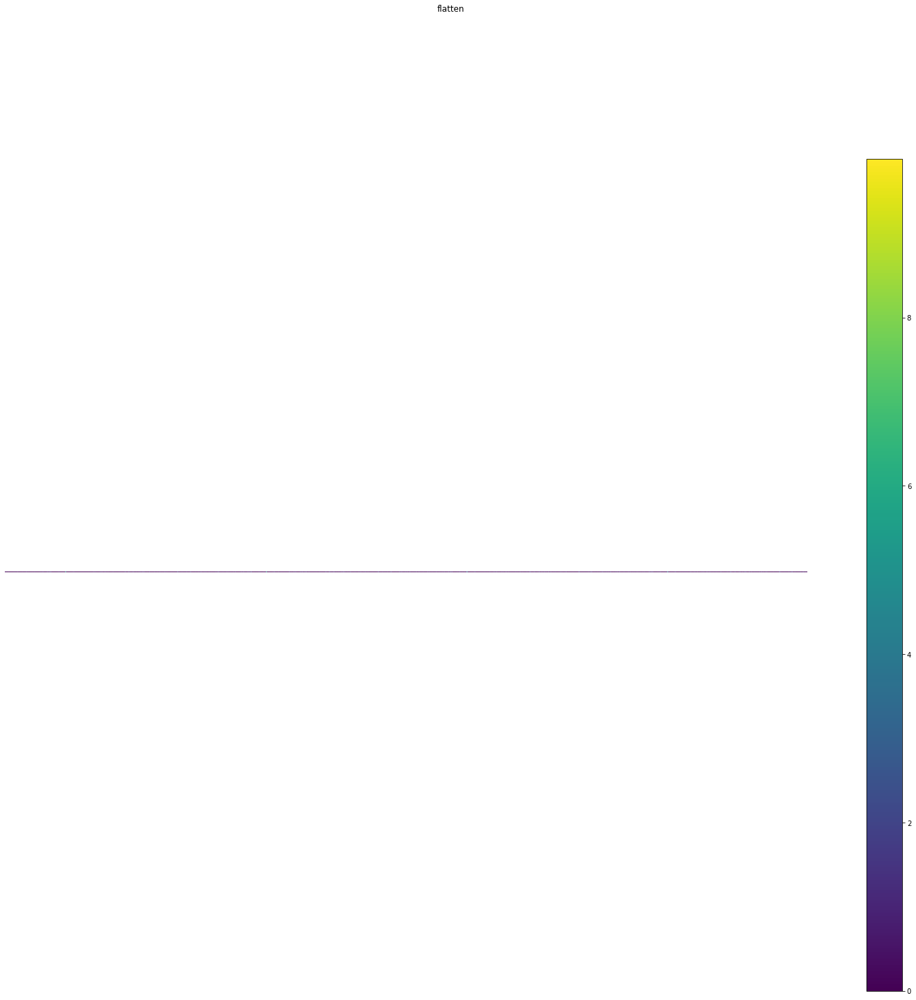

dense_2 (1, 400) 


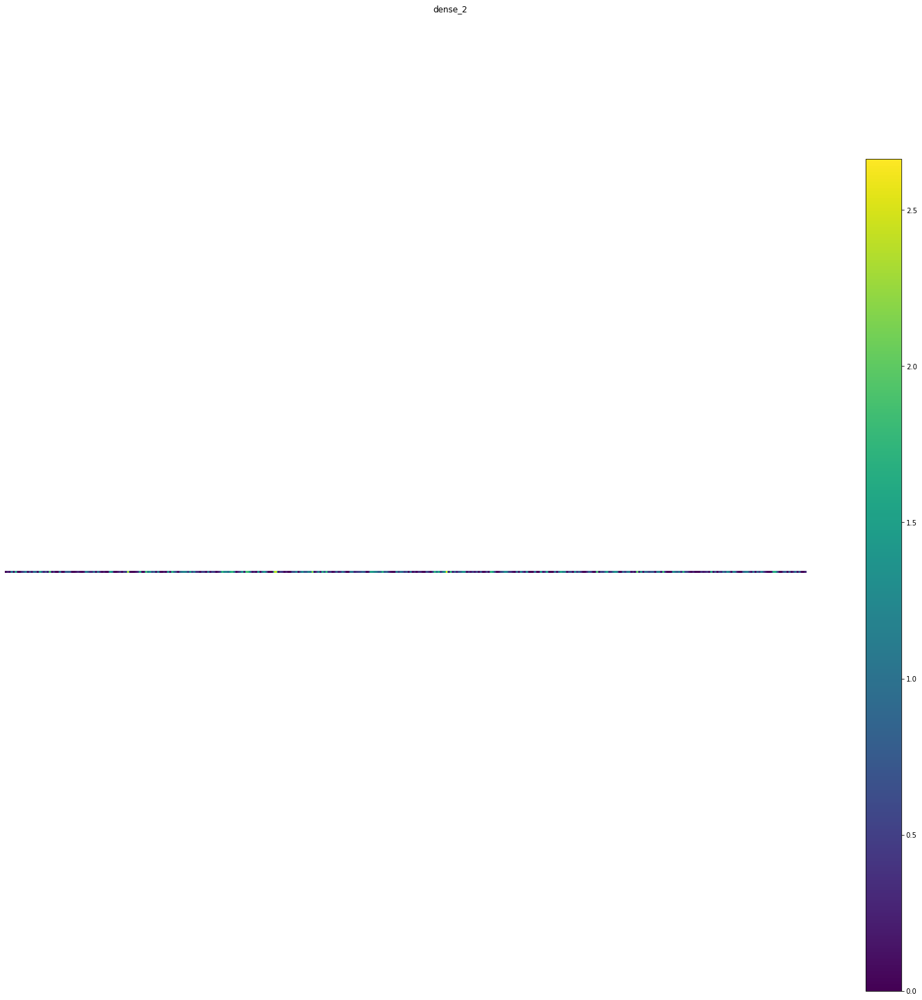

dense_3 (1, 300) 


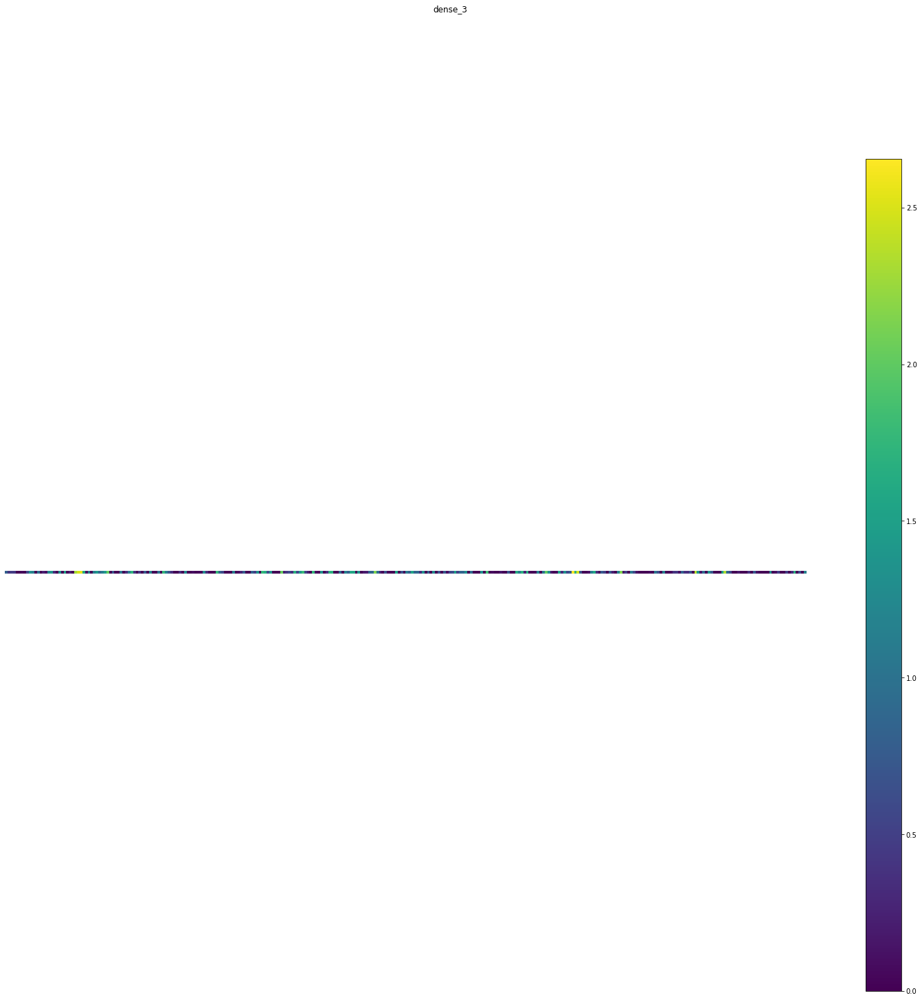

dropout_1 (1, 300) 


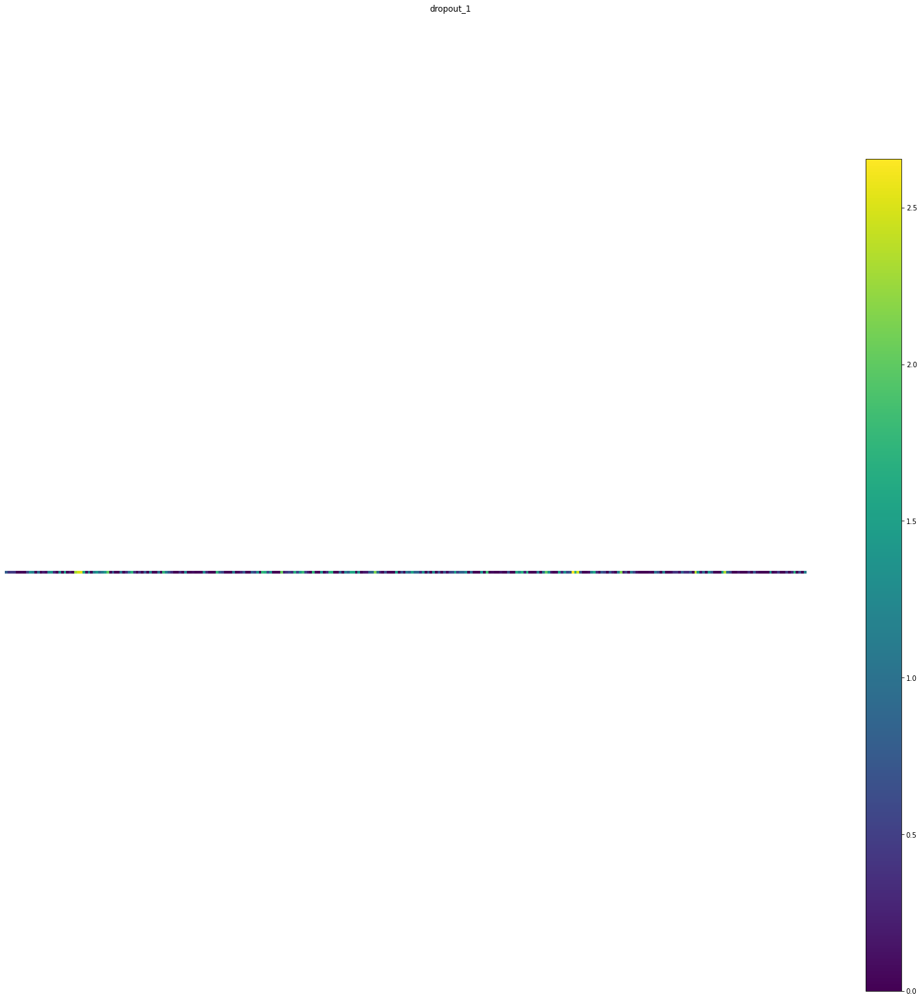

dense_4 (1, 10) 


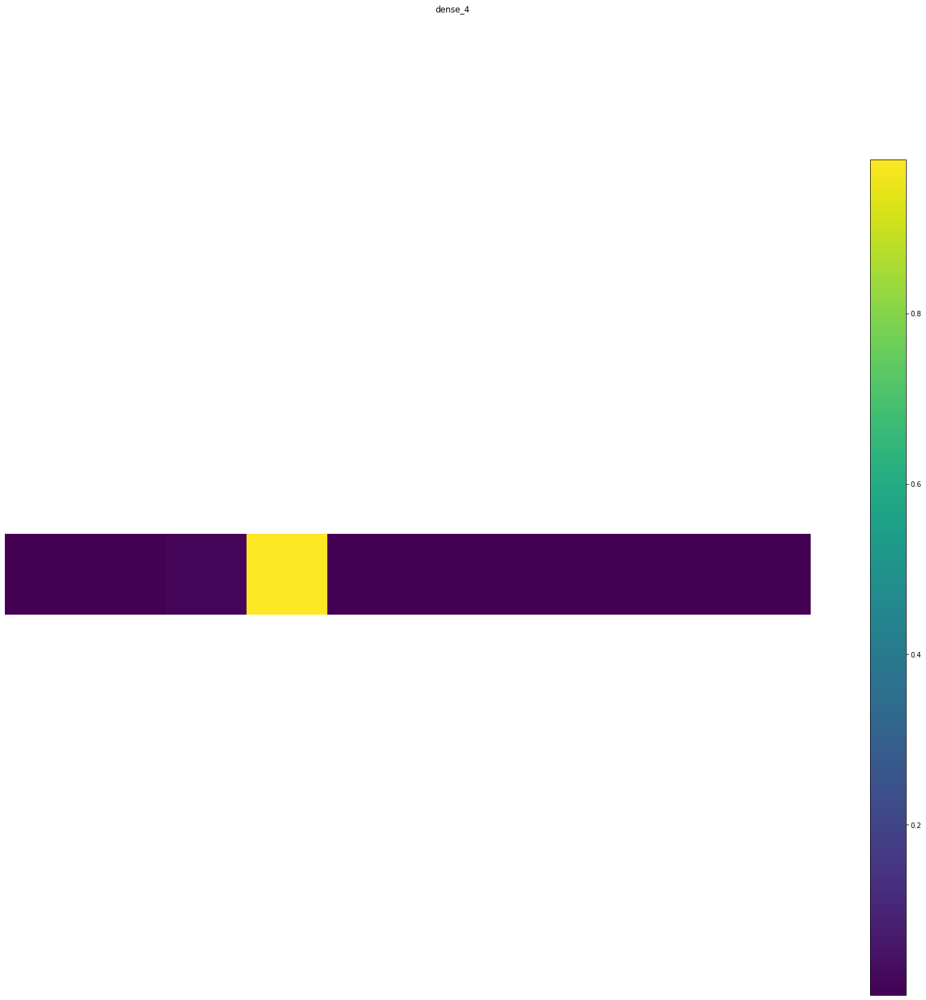

In [101]:
#visualze the feature maps learned by model 2
visualize_activation_maps_learned_by_model(model_2,test_img)

input_2 (1, 64, 64, 3) 


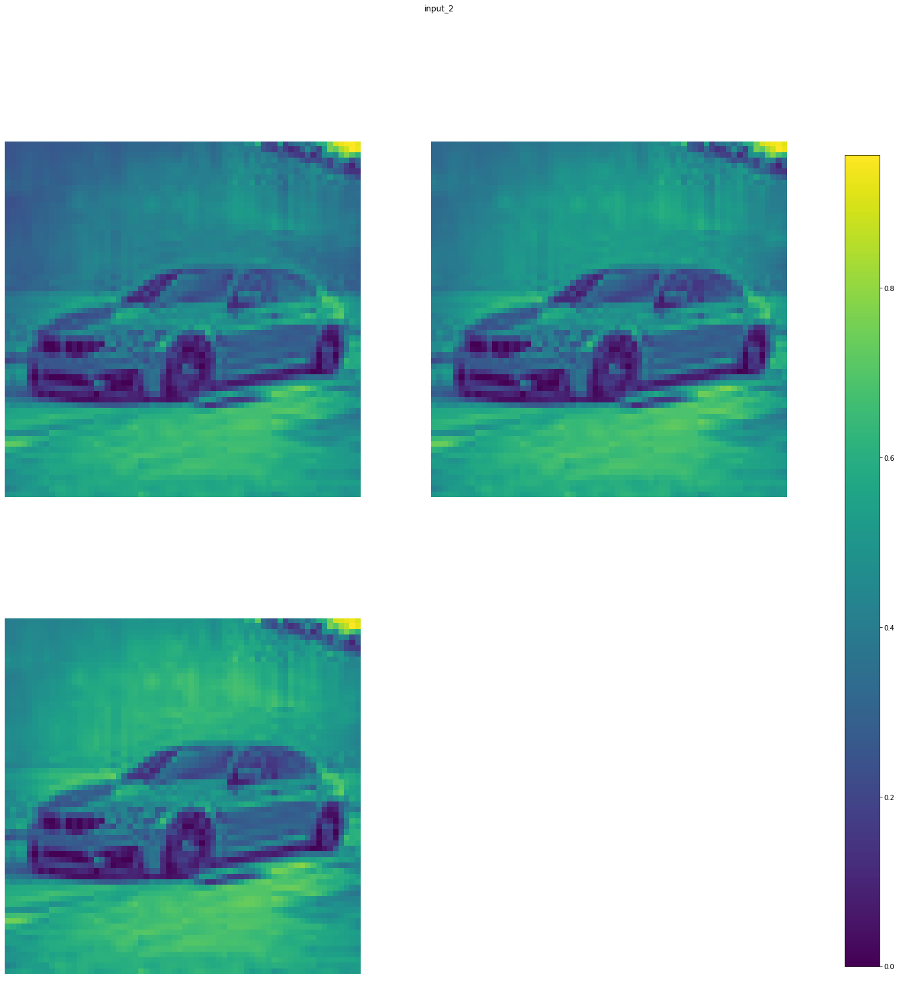

block1_conv1 (1, 64, 64, 64) 


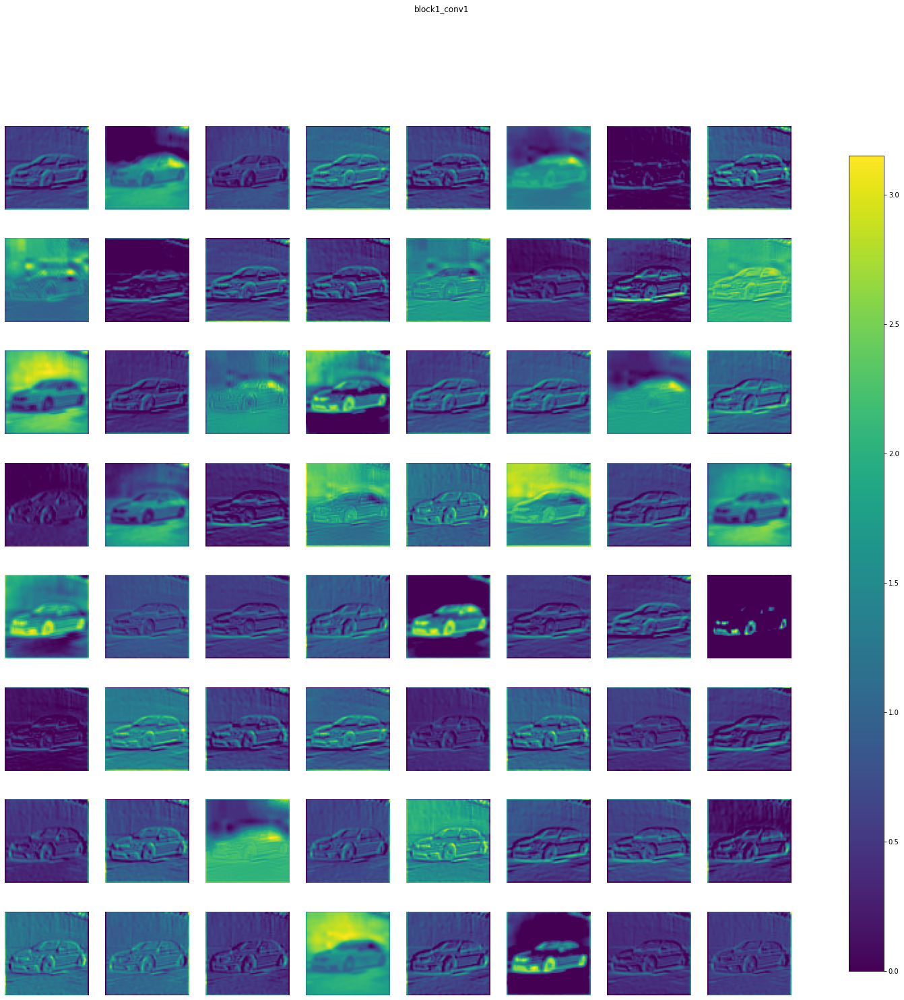

block1_conv2 (1, 64, 64, 64) 


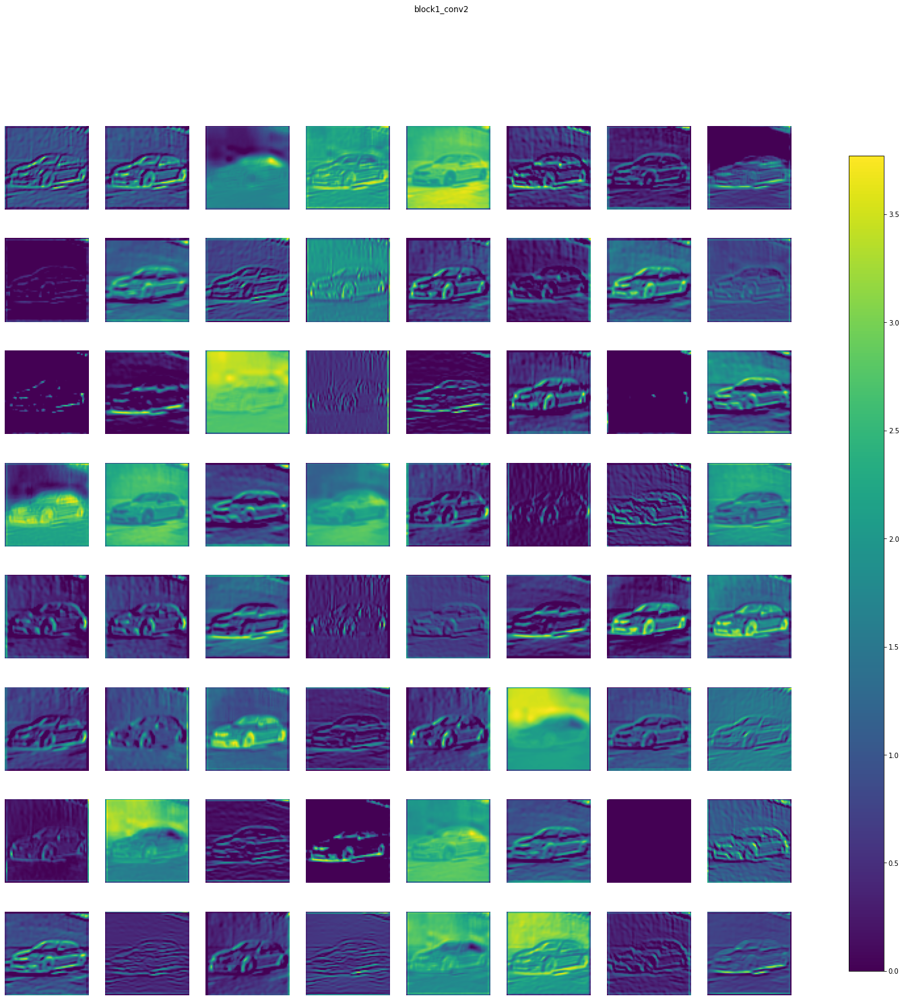

block1_pool (1, 32, 32, 64) 


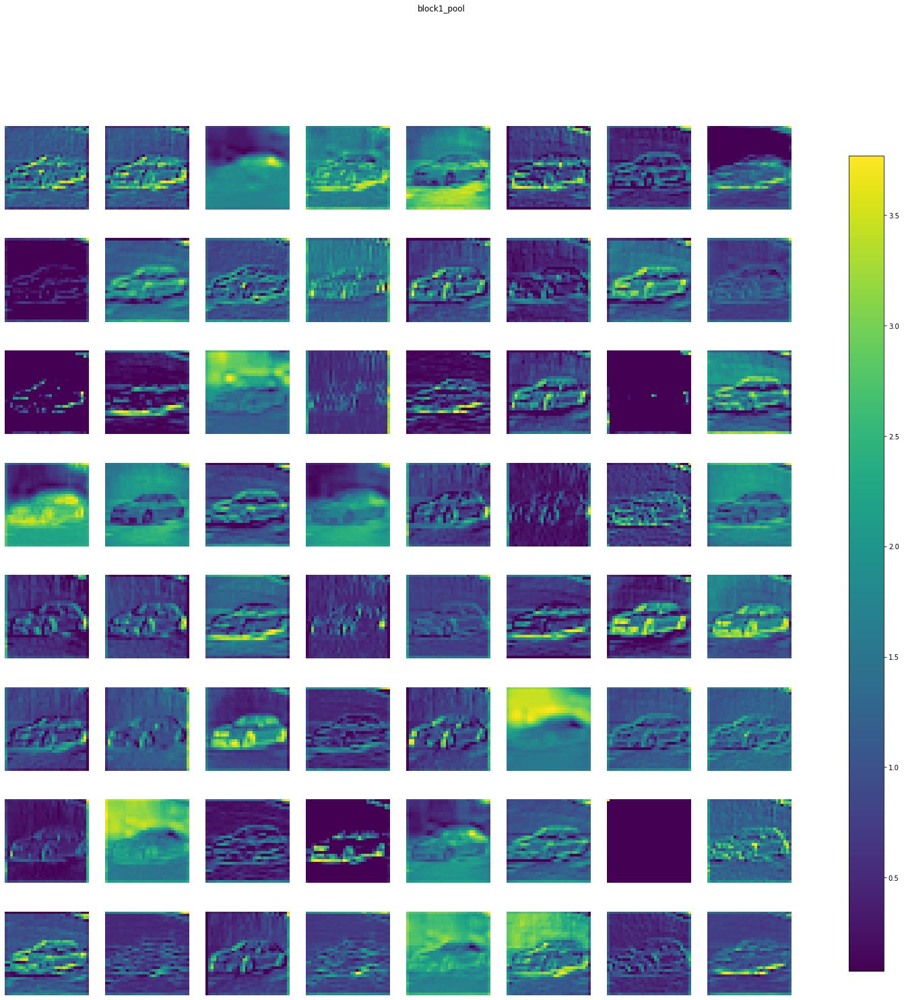

block2_conv1 (1, 32, 32, 128) 


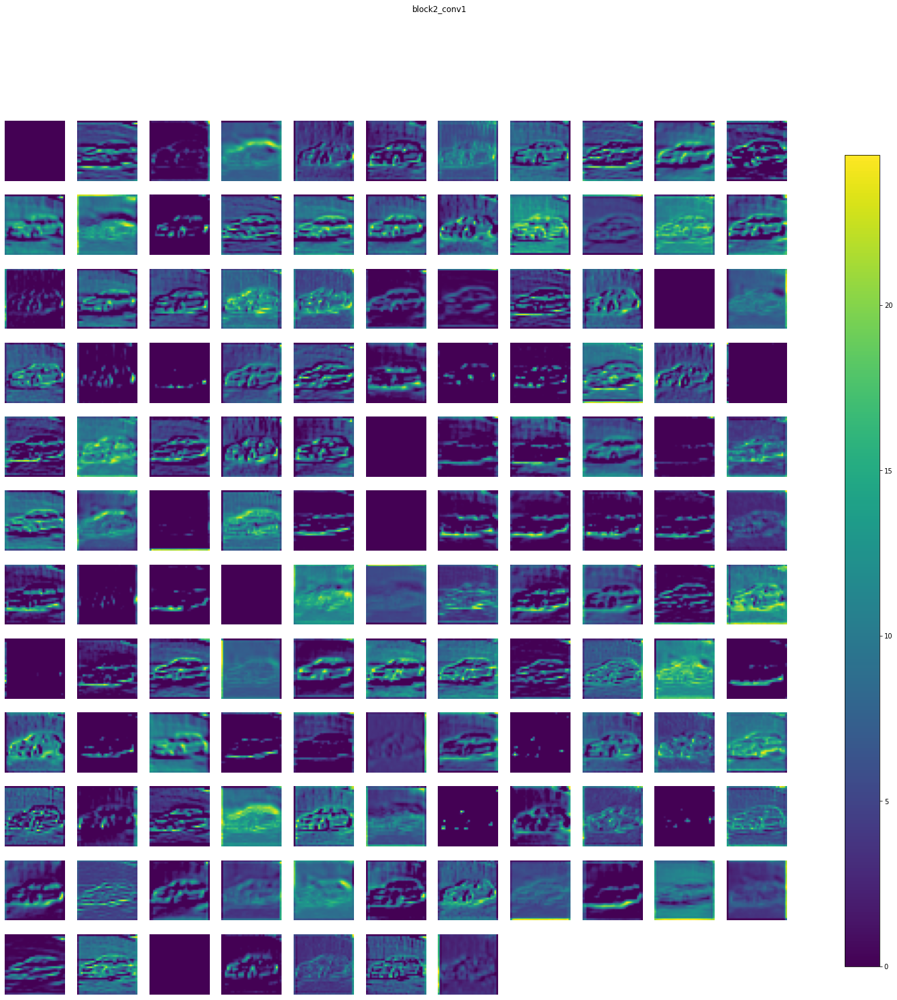

block2_conv2 (1, 32, 32, 128) 


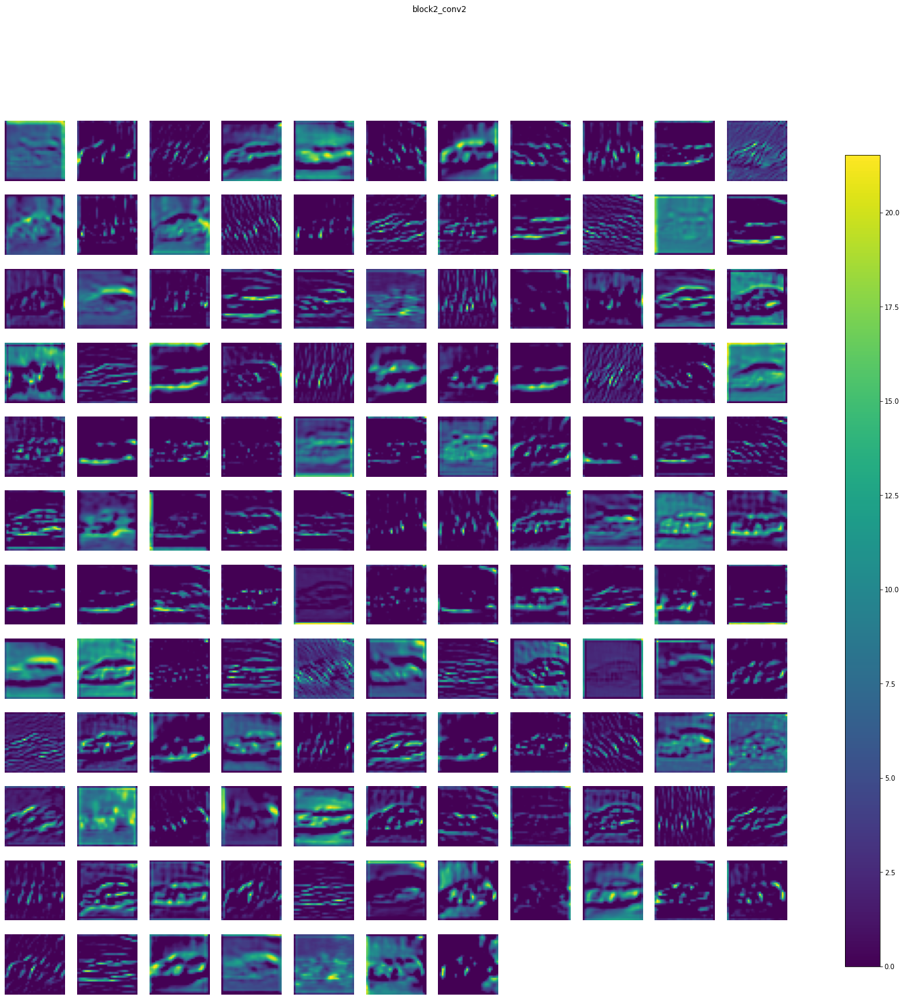

block2_pool (1, 16, 16, 128) 


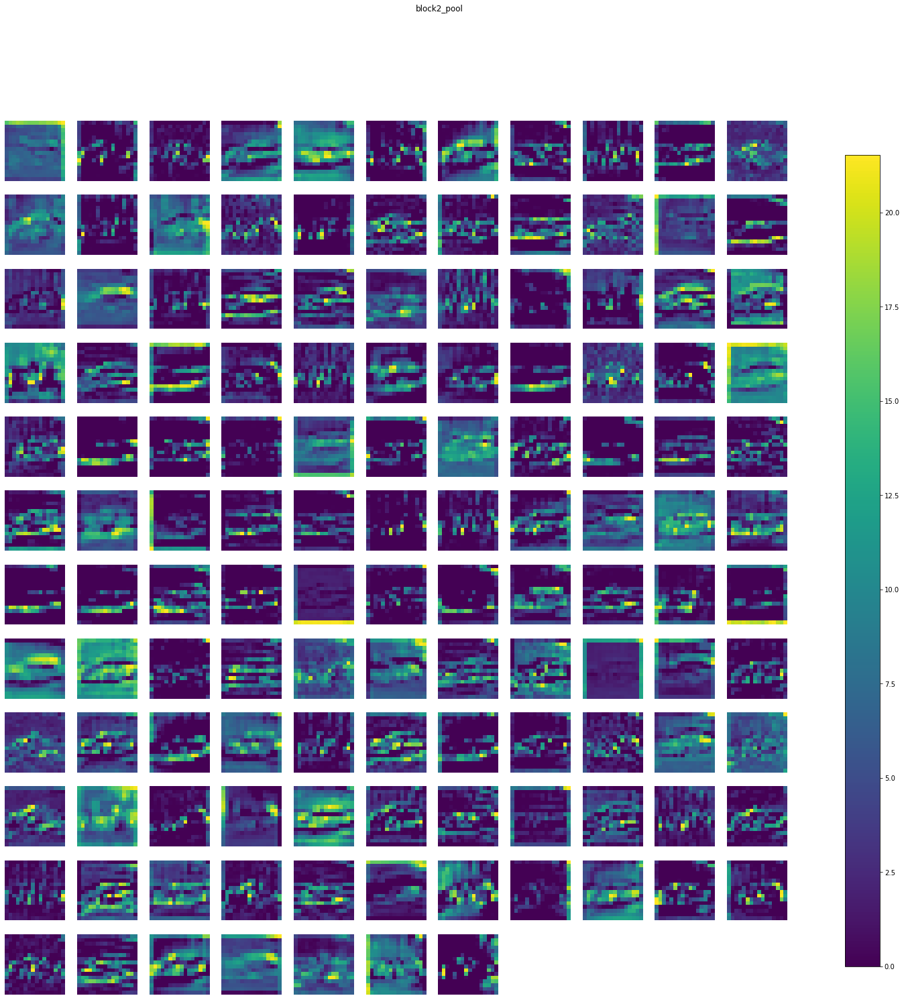

block3_conv1 (1, 16, 16, 256) 


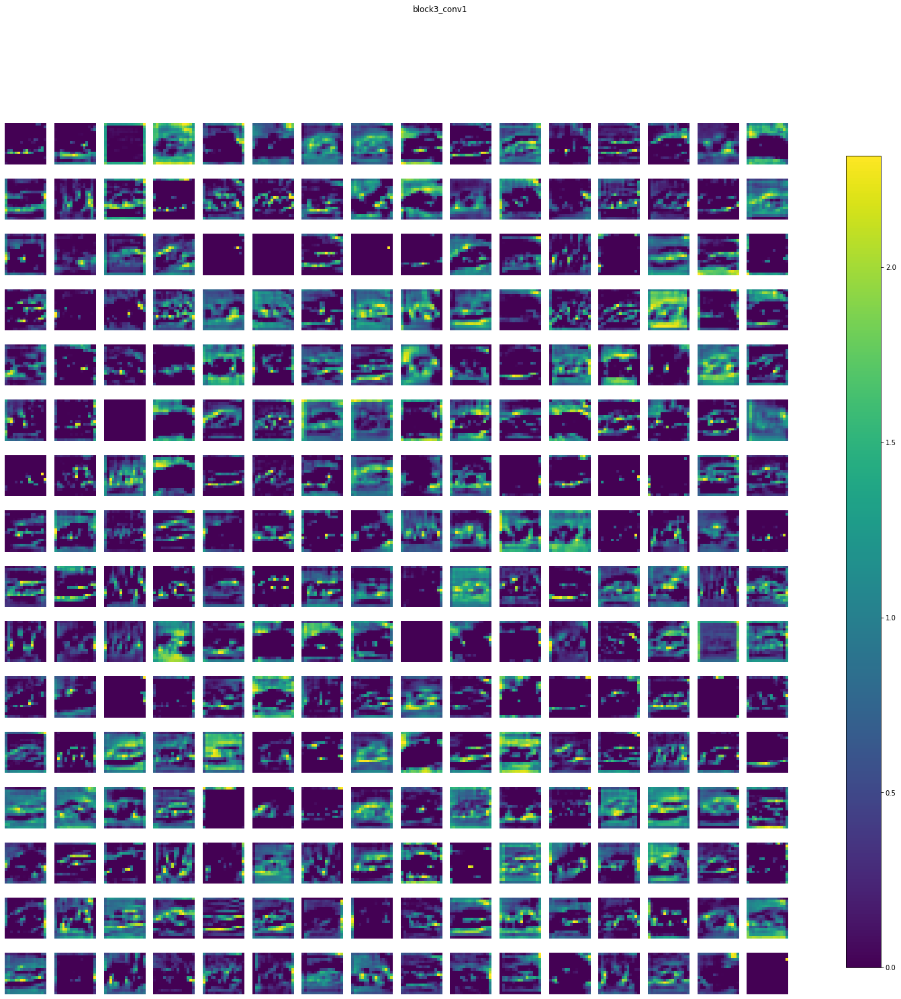

block3_conv2 (1, 16, 16, 256) 


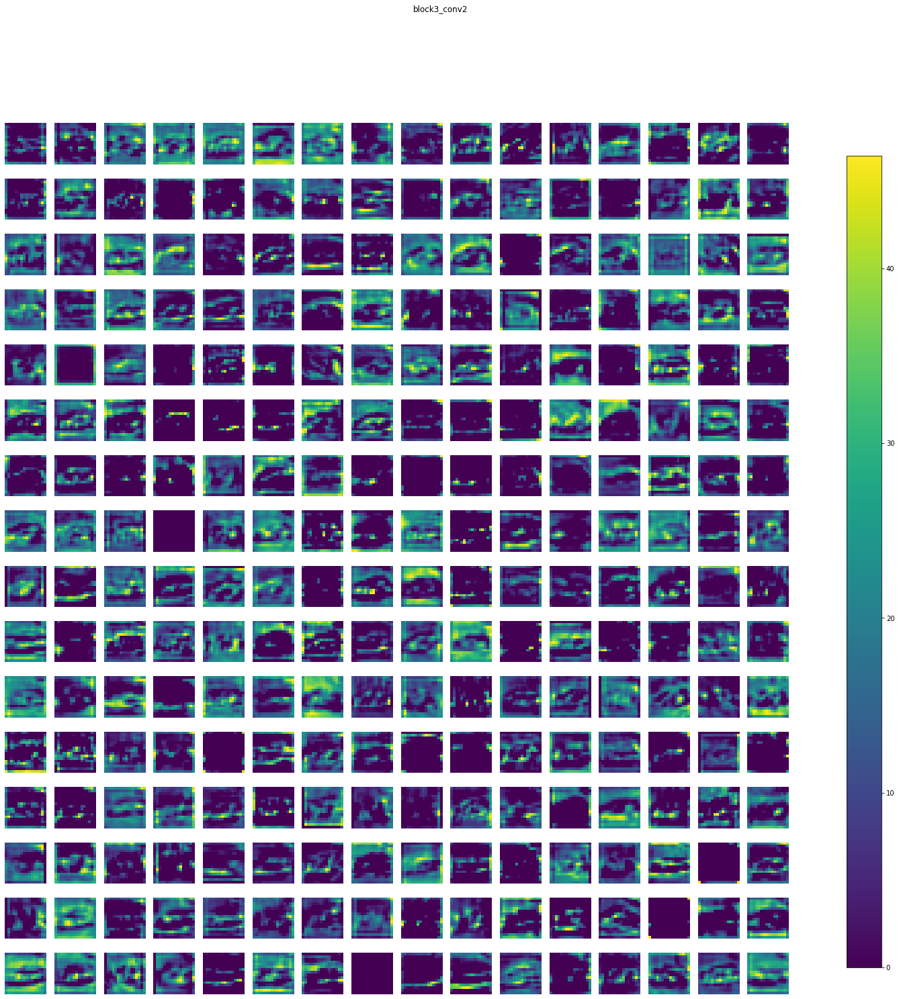

block3_conv3 (1, 16, 16, 256) 


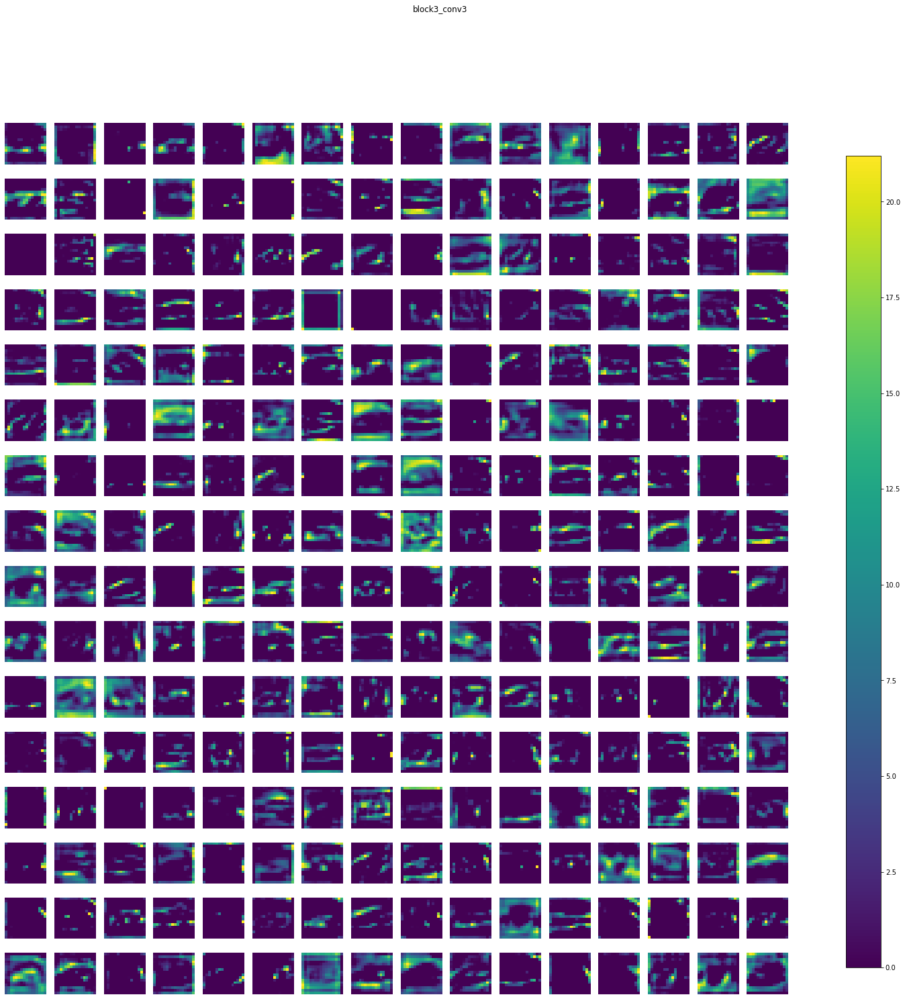

block3_pool (1, 8, 8, 256) 


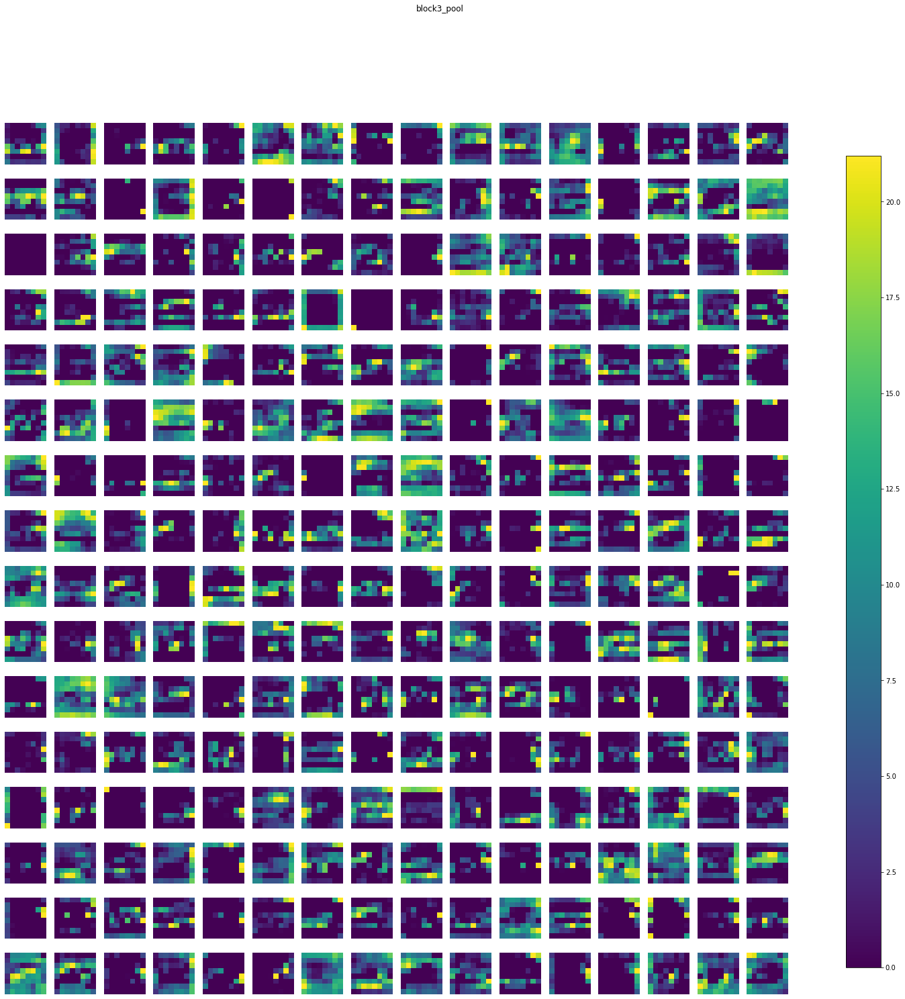

block4_conv1 (1, 8, 8, 512) 


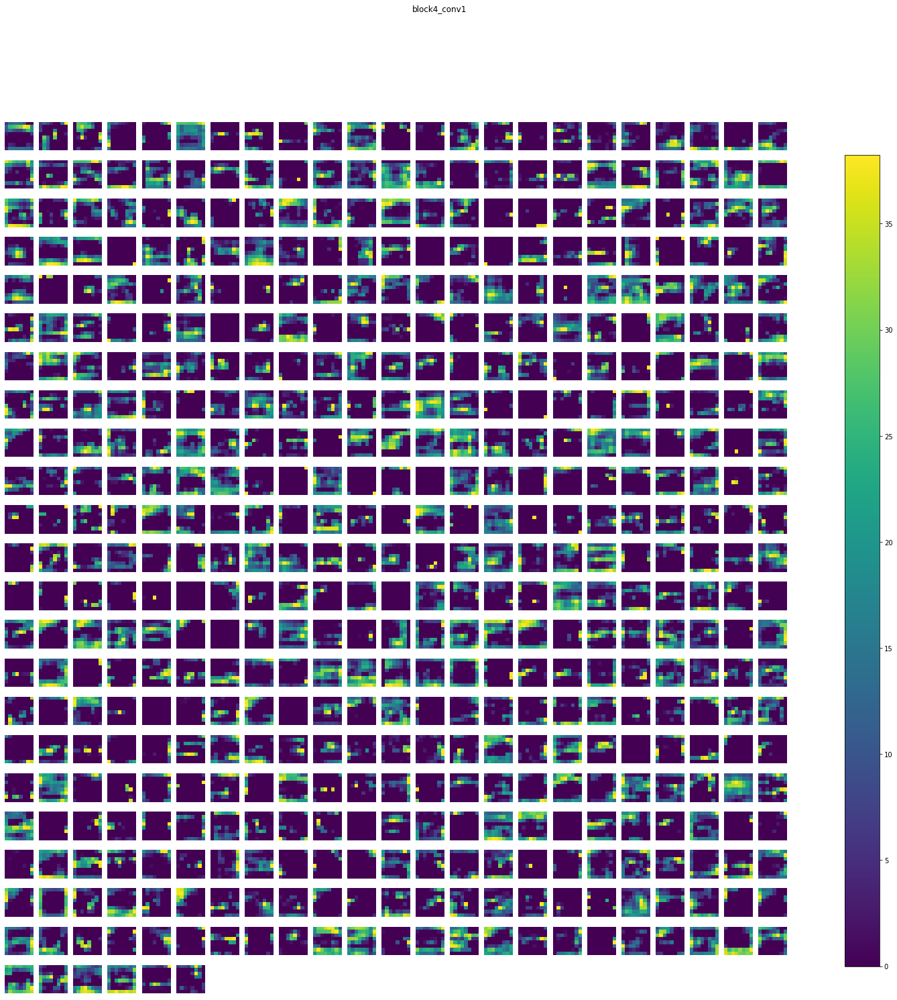

block4_conv2 (1, 8, 8, 512) 


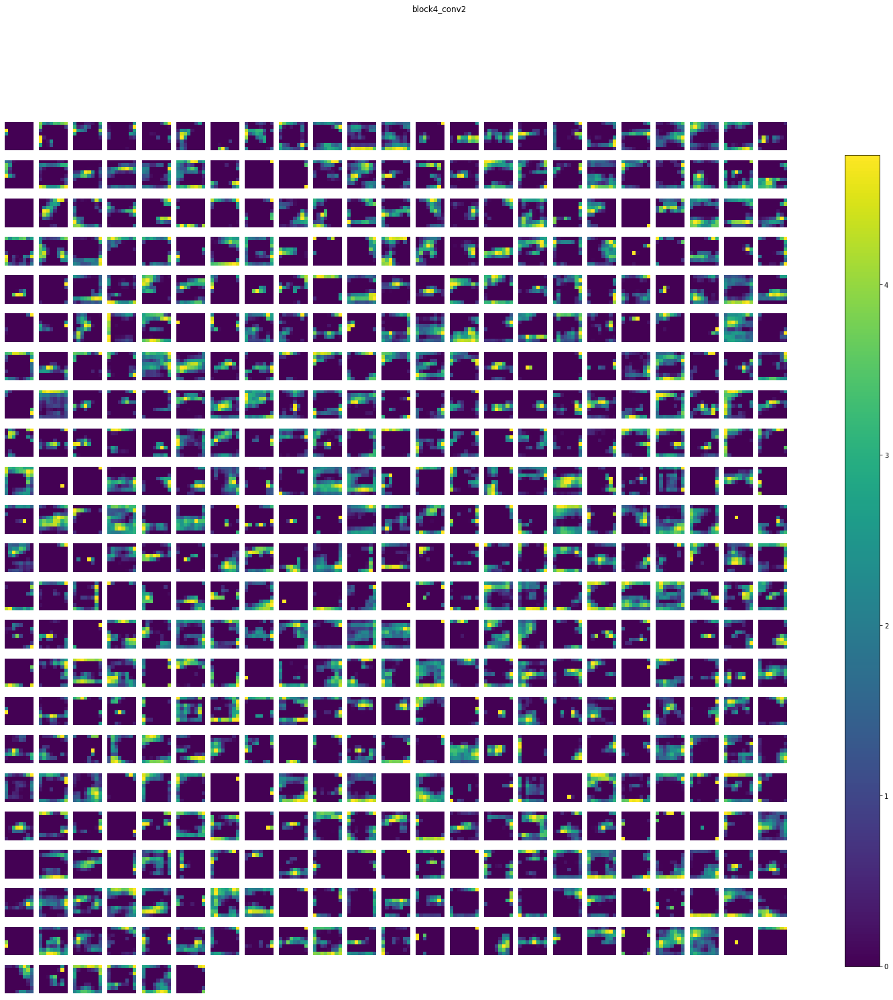

block4_conv3 (1, 8, 8, 512) 


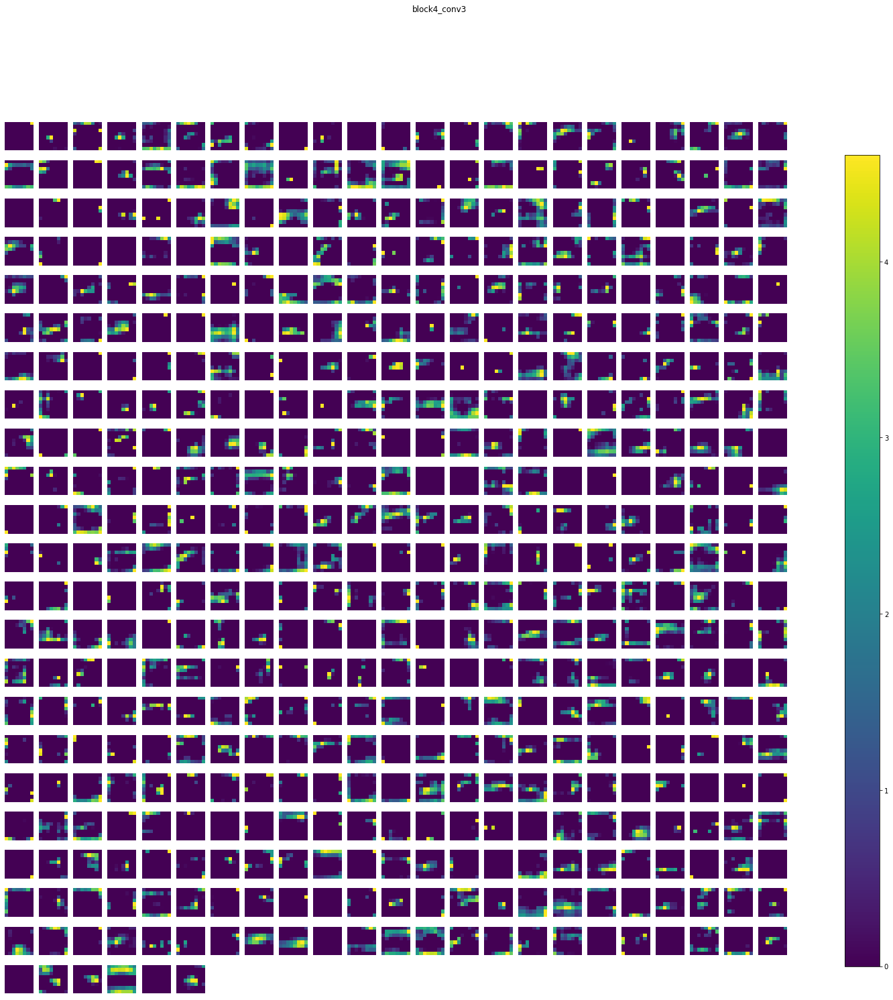

block4_pool (1, 4, 4, 512) 


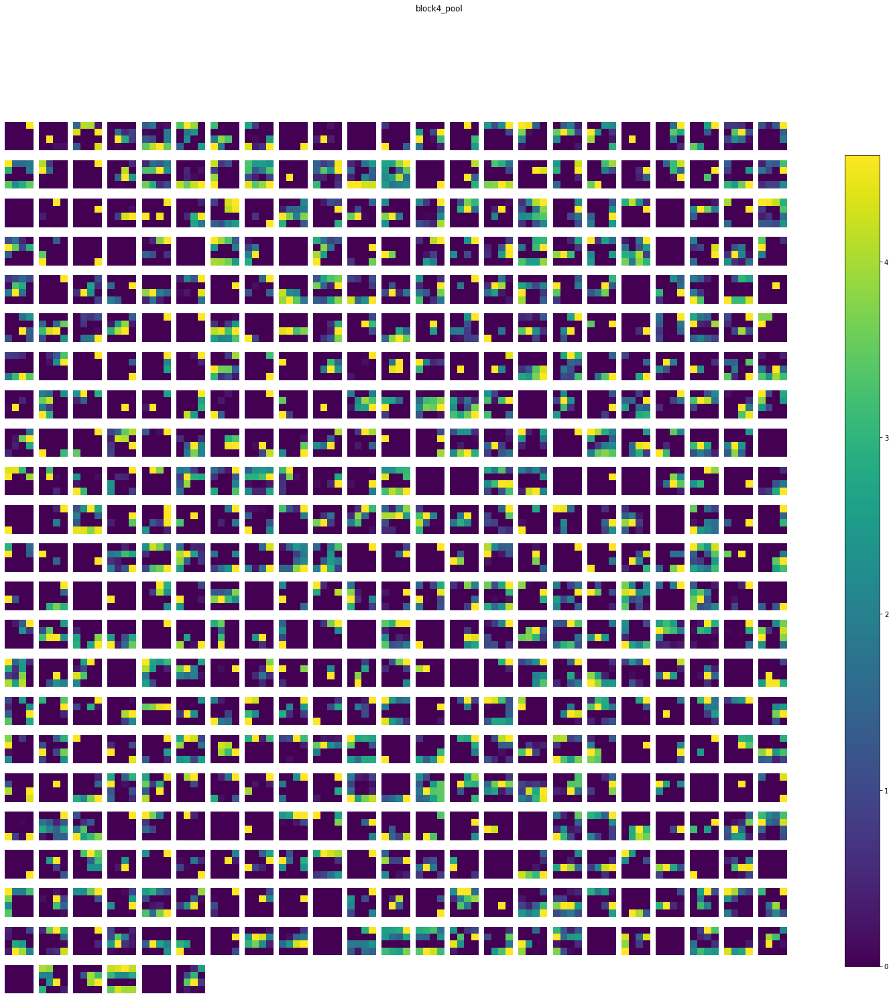

block5_conv1 (1, 4, 4, 512) 


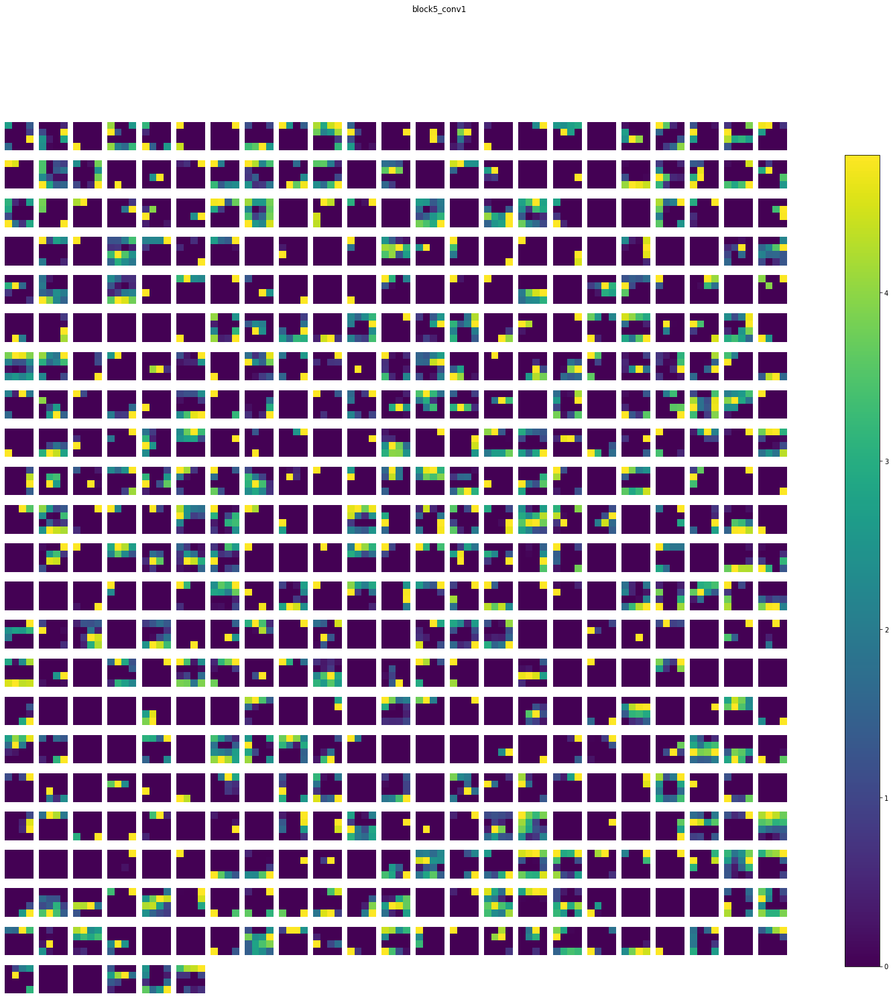

block5_conv2 (1, 4, 4, 512) 


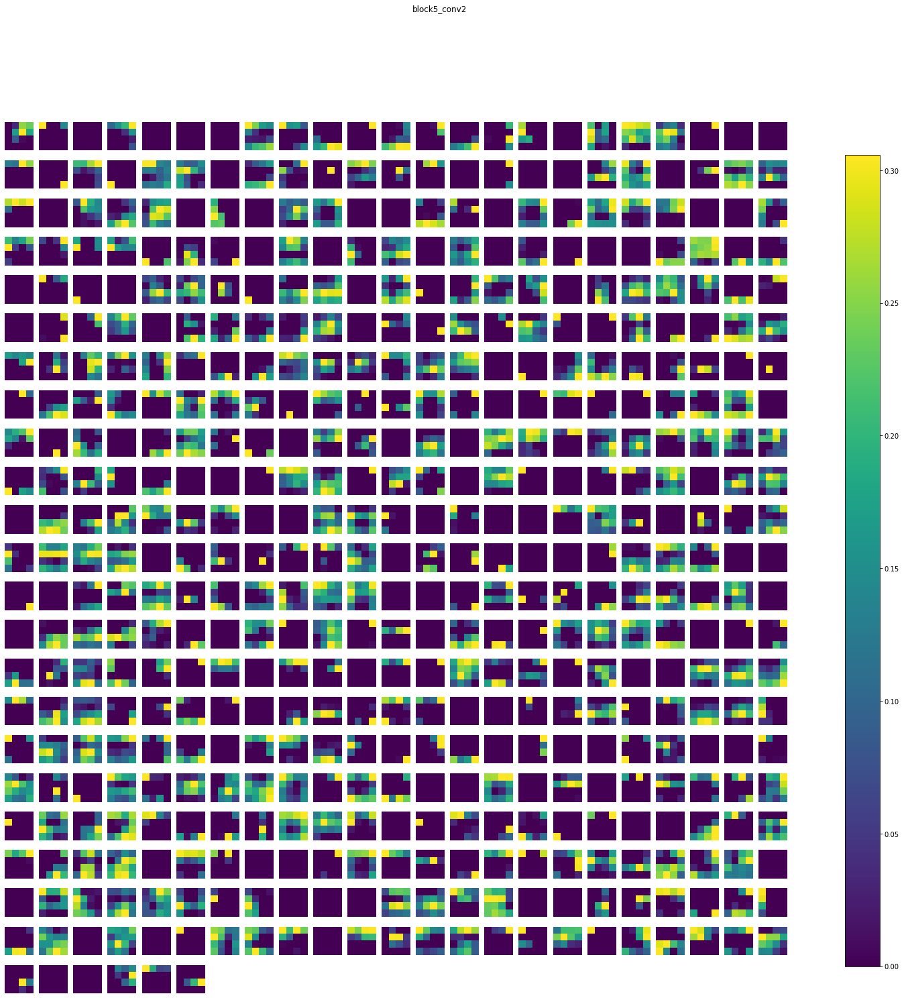

block5_conv3 (1, 4, 4, 512) 


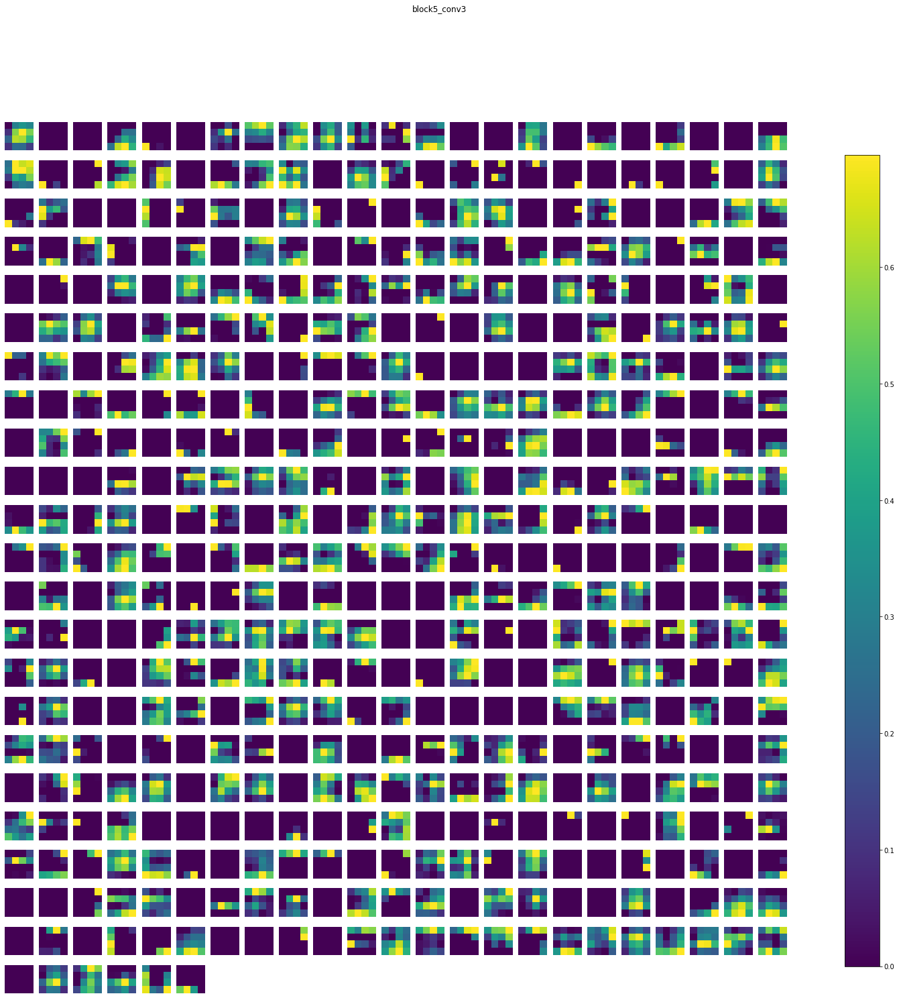

block5_pool (1, 2, 2, 512) 


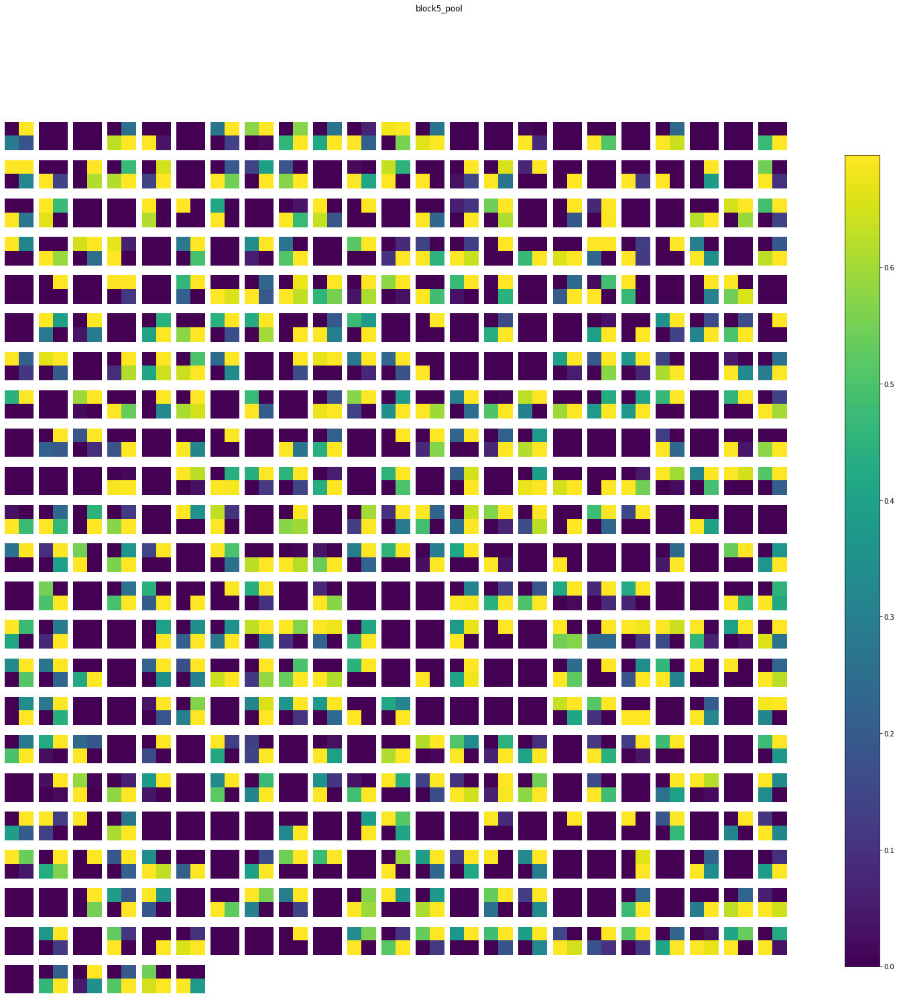

flatten (1, 2048) 


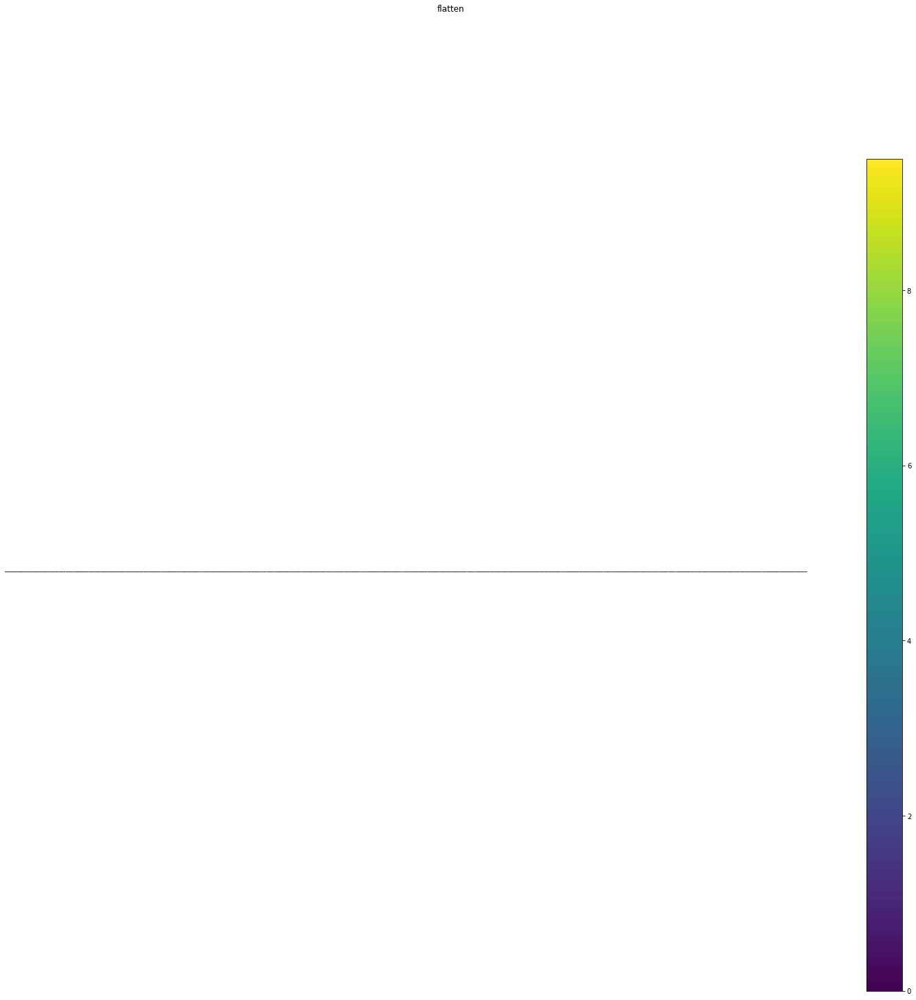

dense_5 (1, 400) 


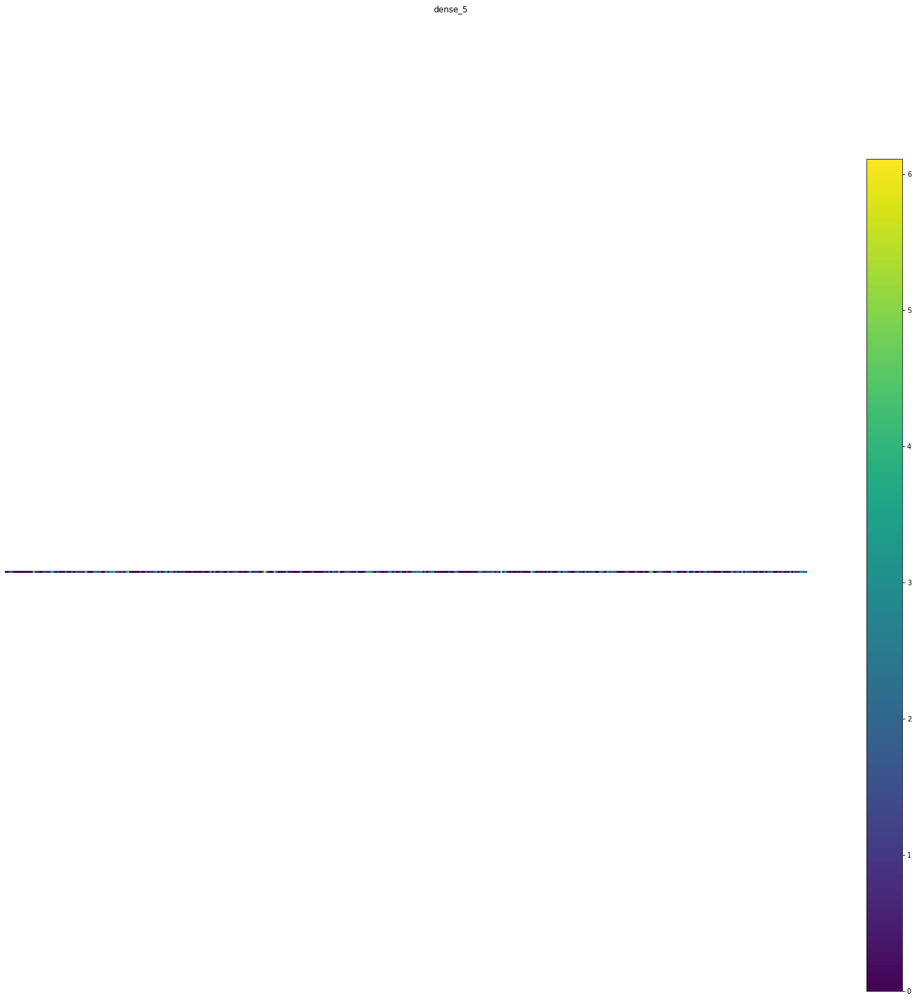

dense_6 (1, 300) 


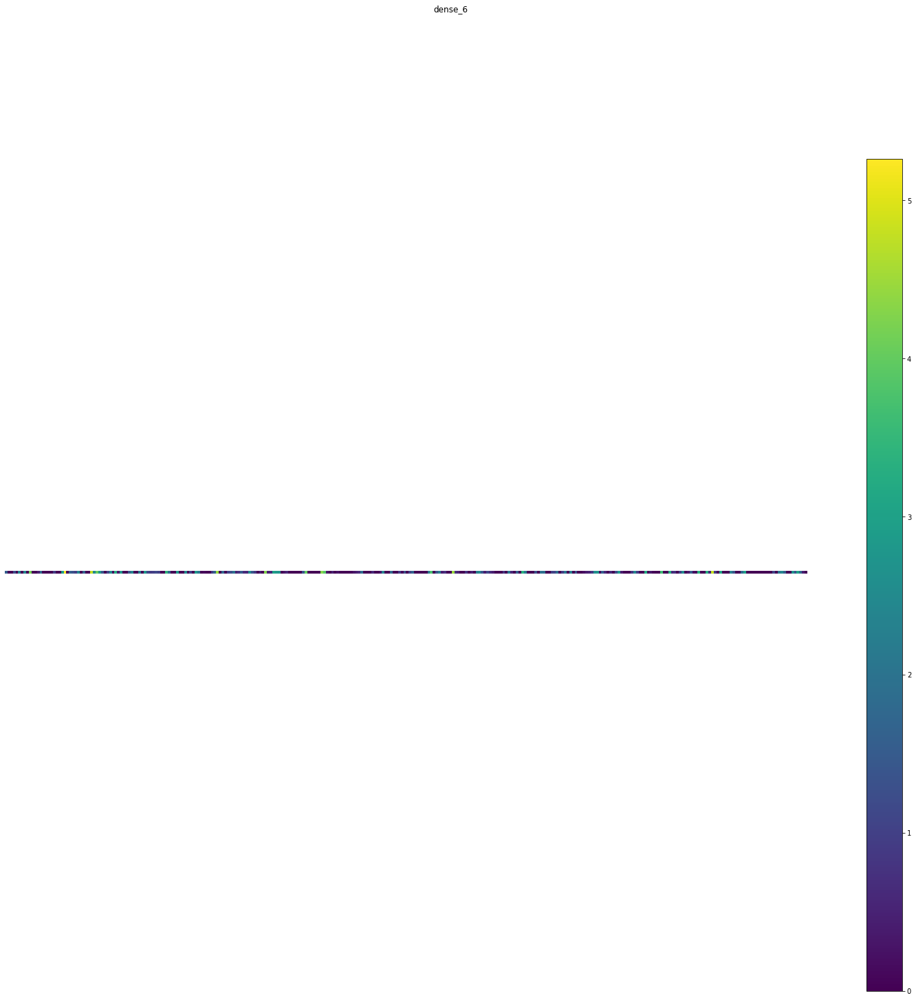

dropout_2 (1, 300) 


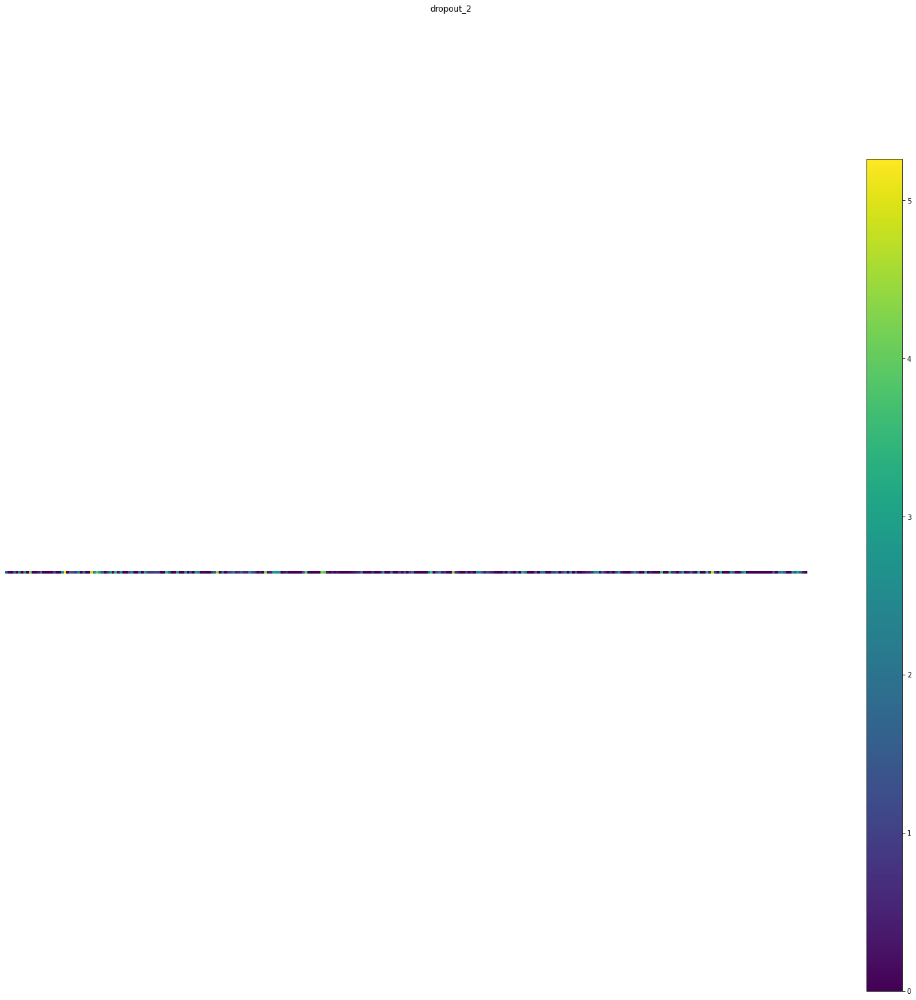

dense_7 (1, 10) 


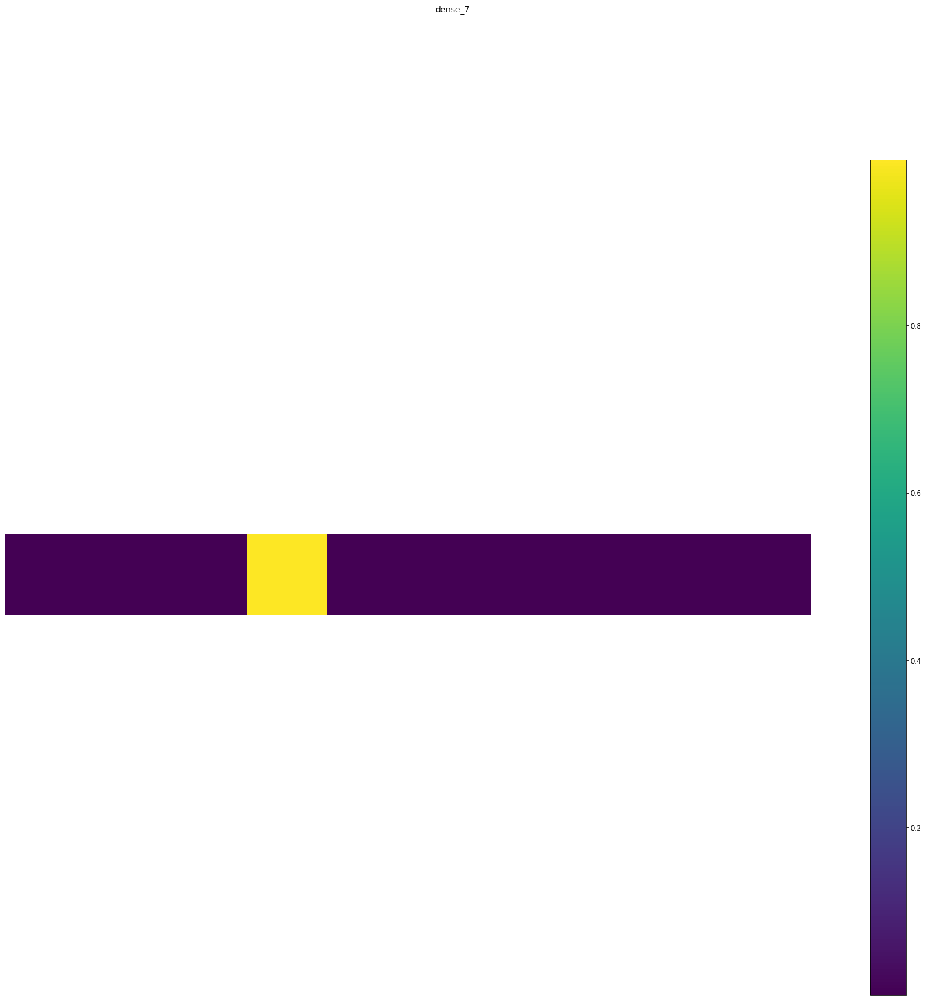

In [102]:
#visualze the feature maps learned by model 3
visualize_activation_maps_learned_by_model(model_3,test_img)

### Interpret the results of each model in a specific image from the test Dataset 

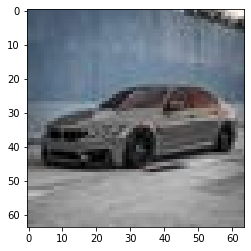

In [217]:
last_conv_layer_name = "conv2d_3"

plt.imshow(test_img)
plt.show()

### process the test image and use the model to predict its class 

1/1 [==============================] - 0s 35ms/step
predicted class:Cars


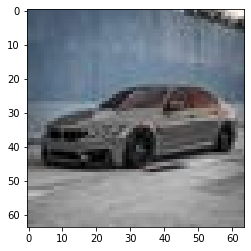

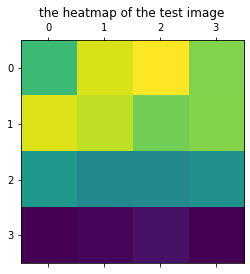

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


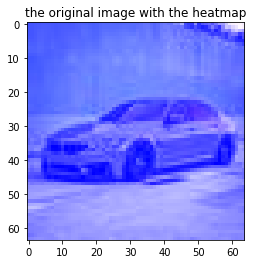

In [340]:
#interpret the results of model1
interpret_prediction(test_img,model_1,"conv2d_3")

1/1 [==============================] - 0s 52ms/step
predicted class:Airplane


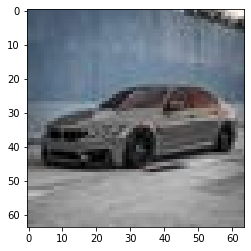

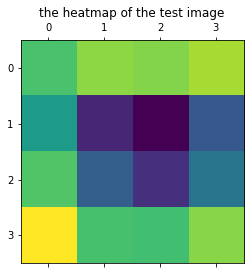

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


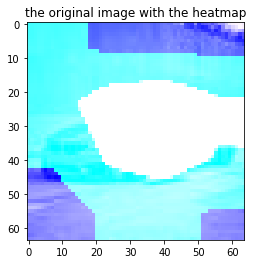

In [341]:
#interpret the results of model2
interpret_prediction(test_img,model_2,"block5_conv3")

1/1 [==============================] - 0s 37ms/step
predicted class:Airplane


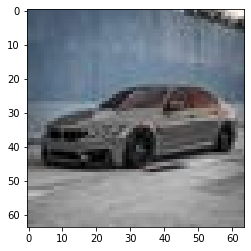

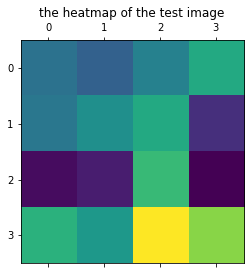

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


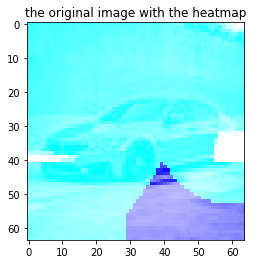

In [342]:
#interpret the results of model3
interpret_prediction(test_img,model_3,"block5_conv3")

<h3 style="color:maroon;"> Apply Regularization technique </h3> 

### 1. Ensample methods

In [85]:
preds =[]
preds.append(list(x_test_pred_1_cls))
preds.append(list(x_test_pred_2_cls))
preds.append(list(x_test_pred_3_cls))

In [87]:
# get the final predictions 
preds_new = np.array(preds)
transposed_preds_new = preds_new.T
predictions = st.mode(transposed_preds_new,axis=1)

#make them into a list
y_pred_final=list(predictions[0].reshape(-1))

<Figure size 1152x1152 with 0 Axes>

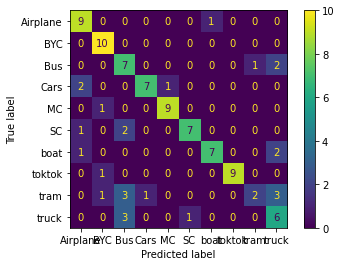

              precision    recall  f1-score   support

    Airplane       0.69      0.90      0.78        10
         BYC       0.77      1.00      0.87        10
         Bus       0.47      0.70      0.56        10
        Cars       0.88      0.70      0.78        10
          MC       0.90      0.90      0.90        10
          SC       0.88      0.70      0.78        10
        boat       0.88      0.70      0.78        10
      toktok       1.00      0.90      0.95        10
        tram       0.67      0.20      0.31        10
       truck       0.46      0.60      0.52        10

    accuracy                           0.73       100
   macro avg       0.76      0.73      0.72       100
weighted avg       0.76      0.73      0.72       100



In [90]:
#print the results of the model
plot_report_confusionMatrix(y_pred_final,y_test_replaced)

### 2. Data Augmentation 

In [360]:
# ModelCheckpoint callback - save best weights
tl_checkpoint_4 = ModelCheckpoint(filepath='tl_model_4.weights.best.hdf5',save_best_only=True,verbose=1)
tl_checkpoint_5 = ModelCheckpoint(filepath='tl_model_5.weights.best.hdf5',save_best_only=True,verbose=1)
tl_checkpoint_6 = ModelCheckpoint(filepath='tl_model_6.weights.best.hdf5',save_best_only=True,verbose=1)

In [361]:
#perform data augmentation on the train data
datagen = ImageDataGenerator(
    featurewise_center=True,
    featurewise_std_normalization=True,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    validation_split=0.2)

datagen.fit(X_train)

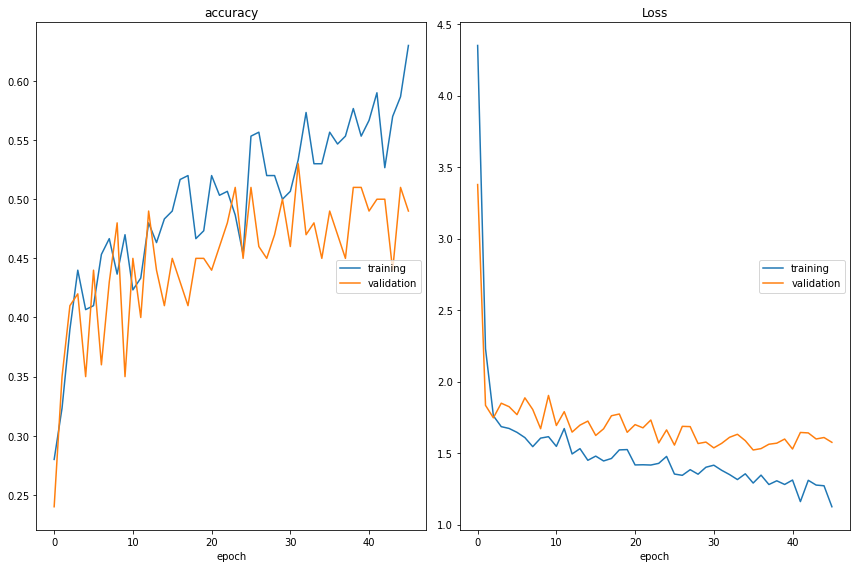

accuracy
	training         	 (min:    0.280, max:    0.630, cur:    0.630)
	validation       	 (min:    0.240, max:    0.530, cur:    0.490)
Loss
	training         	 (min:    1.125, max:    4.350, cur:    1.125)
	validation       	 (min:    1.522, max:    3.378, cur:    1.575)
10/10 [==============================] - 3s 285ms/step - loss: 1.1250 - accuracy: 0.6300 - val_loss: 1.5753 - val_accuracy: 0.4900


In [369]:
# fit model 1 again using Data Augmentation 

# fits the model on batches with real-time data augmentation:
plot_loss4 = PlotLossesCallback()
augmentation_history_1 = model_1.fit(datagen.flow(X_train,np.array(y_train_replaced), 
                                                  batch_size=32),
        validation_data=datagen.flow(X_val,np.array(y_val_replaced),
                                     batch_size=8), 
                                     epochs=100,
                                     callbacks=[tl_checkpoint_4, 
                                                early_stop,plot_loss4])


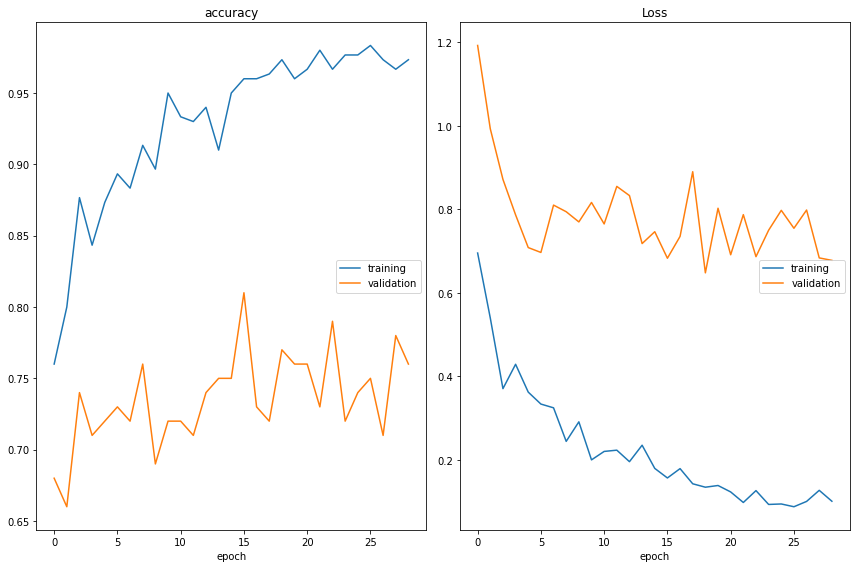

accuracy
	training         	 (min:    0.760, max:    0.983, cur:    0.973)
	validation       	 (min:    0.660, max:    0.810, cur:    0.760)
Loss
	training         	 (min:    0.088, max:    0.695, cur:    0.101)
	validation       	 (min:    0.648, max:    1.193, cur:    0.678)
10/10 [==============================] - 10s 962ms/step - loss: 0.1007 - accuracy: 0.9733 - val_loss: 0.6779 - val_accuracy: 0.7600


In [370]:
# fit model 2 again using Data Augmentation 
# fits the model on batches with real-time data augmentation:
plot_loss5 = PlotLossesCallback()
augmentation_history_2 = model_2.fit(datagen.flow(X_train, 
                                                  np.array(y_train_replaced),
                                                  batch_size=32),
         validation_data=datagen.flow(X_val,np.array(y_val_replaced),
                                      batch_size=8), 
                                     epochs=100,
                                     callbacks=[tl_checkpoint_5, early_stop,plot_loss5])


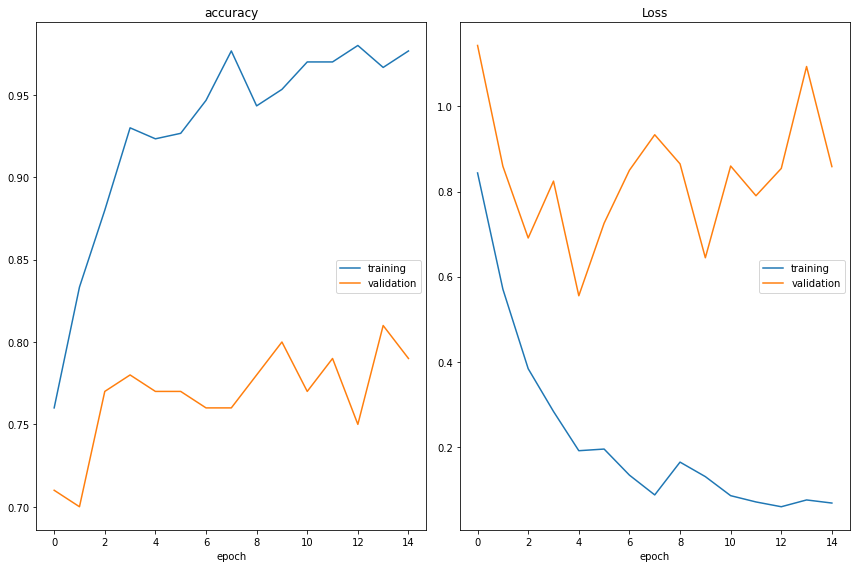

accuracy
	training         	 (min:    0.760, max:    0.980, cur:    0.977)
	validation       	 (min:    0.700, max:    0.810, cur:    0.790)
Loss
	training         	 (min:    0.059, max:    0.844, cur:    0.068)
	validation       	 (min:    0.555, max:    1.143, cur:    0.859)
10/10 [==============================] - 10s 982ms/step - loss: 0.0681 - accuracy: 0.9767 - val_loss: 0.8586 - val_accuracy: 0.7900


In [371]:
# fit model 3 again using Data Augmentation 

# fits the model on batches with real-time data augmentation:
plot_loss6 = PlotLossesCallback()
augmentation_history_1 = model_3.fit(datagen.flow(X_train, 
                                                  np.array(y_train_replaced), 
                                                  batch_size=32),
         validation_data=datagen.flow(X_val,
                                      np.array(y_val_replaced),batch_size=8), 
                                     epochs=100,
                                     callbacks=[tl_checkpoint_6, early_stop,plot_loss6])


### check the performance of the models after using Data Augmentation 

In [372]:
x_test_pred_4 = model_1.predict(X_test)
x_test_pred_4_cls = np.argmax(x_test_pred_4, axis=1)

x_test_pred_5 = model_2.predict(X_test)
x_test_pred_5_cls = np.argmax(x_test_pred_5, axis=1)

x_test_pred_6 = model_3.predict(X_test)
x_test_pred_6_cls = np.argmax(x_test_pred_6, axis=1)

4/4 [==============================] - 2s 481ms/step


<Figure size 1152x1152 with 0 Axes>

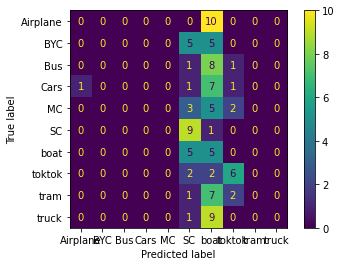

              precision    recall  f1-score   support

    Airplane       0.00      0.00      0.00        10
         BYC       0.00      0.00      0.00        10
         Bus       0.00      0.00      0.00        10
        Cars       0.00      0.00      0.00        10
          MC       0.00      0.00      0.00        10
          SC       0.32      0.90      0.47        10
        boat       0.08      0.50      0.14        10
      toktok       0.50      0.60      0.55        10
        tram       0.00      0.00      0.00        10
       truck       0.00      0.00      0.00        10

    accuracy                           0.20       100
   macro avg       0.09      0.20      0.12       100
weighted avg       0.09      0.20      0.12       100



In [380]:
#display the performance after data augmentation with model 1
plot_report_confusionMatrix(list(x_test_pred_4_cls),y_test_replaced)

<Figure size 1152x1152 with 0 Axes>

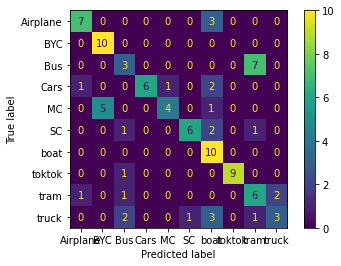

              precision    recall  f1-score   support

    Airplane       0.78      0.70      0.74        10
         BYC       0.67      1.00      0.80        10
         Bus       0.38      0.30      0.33        10
        Cars       1.00      0.60      0.75        10
          MC       0.80      0.40      0.53        10
          SC       0.86      0.60      0.71        10
        boat       0.48      1.00      0.65        10
      toktok       1.00      0.90      0.95        10
        tram       0.40      0.60      0.48        10
       truck       0.60      0.30      0.40        10

    accuracy                           0.64       100
   macro avg       0.70      0.64      0.63       100
weighted avg       0.70      0.64      0.63       100



In [381]:
#display the performance after data augmentation with model 2
plot_report_confusionMatrix(list(x_test_pred_5_cls),y_test_replaced)

<Figure size 1152x1152 with 0 Axes>

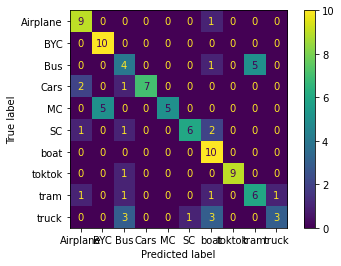

              precision    recall  f1-score   support

    Airplane       0.69      0.90      0.78        10
         BYC       0.67      1.00      0.80        10
         Bus       0.36      0.40      0.38        10
        Cars       1.00      0.70      0.82        10
          MC       1.00      0.50      0.67        10
          SC       0.86      0.60      0.71        10
        boat       0.56      1.00      0.71        10
      toktok       1.00      0.90      0.95        10
        tram       0.55      0.60      0.57        10
       truck       0.75      0.30      0.43        10

    accuracy                           0.69       100
   macro avg       0.74      0.69      0.68       100
weighted avg       0.74      0.69      0.68       100



In [382]:
#display the performance after data augmentation with model 3
plot_report_confusionMatrix(list(x_test_pred_6_cls),y_test_replaced)

### 3. Ensample methods after Data Augmentation 

In [383]:
preds =[]
preds.append(list(x_test_pred_4_cls))
preds.append(list(x_test_pred_5_cls))
preds.append(list(x_test_pred_6_cls))

# get the final predictions 
preds_new = np.array(preds)
transposed_preds_new = preds_new.T
predictions = st.mode(transposed_preds_new,axis=1)
y_pred_final=list(predictions[0].reshape(-1))

<Figure size 1152x1152 with 0 Axes>

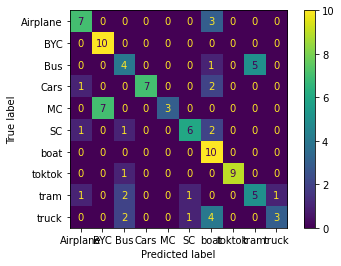

              precision    recall  f1-score   support

    Airplane       0.70      0.70      0.70        10
         BYC       0.59      1.00      0.74        10
         Bus       0.40      0.40      0.40        10
        Cars       1.00      0.70      0.82        10
          MC       1.00      0.30      0.46        10
          SC       0.75      0.60      0.67        10
        boat       0.45      1.00      0.62        10
      toktok       1.00      0.90      0.95        10
        tram       0.50      0.50      0.50        10
       truck       0.75      0.30      0.43        10

    accuracy                           0.64       100
   macro avg       0.71      0.64      0.63       100
weighted avg       0.71      0.64      0.63       100



In [384]:
#display the performance of ensamle metho after data augmentation 
plot_report_confusionMatrix(y_pred_final,y_test_replaced)

### **4. Add the L1 and L2 Regularization**

In [400]:
# ModelCheckpoint callback - save best weights
tl_checkpoint_7 = ModelCheckpoint(filepath='tl_model_7.weights.best.hdf5',save_best_only=True,verbose=1)
tl_checkpoint_8 = ModelCheckpoint(filepath='tl_model_8.weights.best.hdf5',save_best_only=True,verbose=1)

In [401]:
model_7 = tf.keras.models.Sequential([
    #put the first convolution
    tf.keras.layers.Conv2D(64, (3,3), activation='relu', input_shape=(64, 64, 3)),
    
    #put the maxpooling layer
    tf.keras.layers.MaxPooling2D(2, 2),
    
    #put the second convolution
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    
    #put the maxpooling laye
    tf.keras.layers.MaxPooling2D(2,2),
    
    #put the third convolution
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    
    #put the maxpooling laye
    tf.keras.layers.MaxPooling2D(2,2),
    
    #put the fourth convolution
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    
    #put the maxpooling laye
    tf.keras.layers.MaxPooling2D(2,2),
    
    #put the Flatten the results to feed into a DNN
    tf.keras.layers.Flatten(),
    
    #put the dropout layer
    tf.keras.layers.Dropout(0.5),
     
    #put the dense with 512 neuron hidden layer and apply regularization
    tf.keras.layers.Dense(units=1024,activation='relu',
        kernel_regularizer=regularizers.L1L2(l1=1e-4, l2=1e-4),
        bias_regularizer=regularizers.L2(1e-4),
        activity_regularizer=regularizers.L2(1e-4)),
    
    #put the dense layer with softmax activation function
    tf.keras.layers.Dense(10, activation='softmax')
])

In [402]:
#compile the model
model_7.compile(optimizer=Adam(learning_rate=0.0001),
                loss='sparse_categorical_crossentropy',
                metrics=['accuracy'])

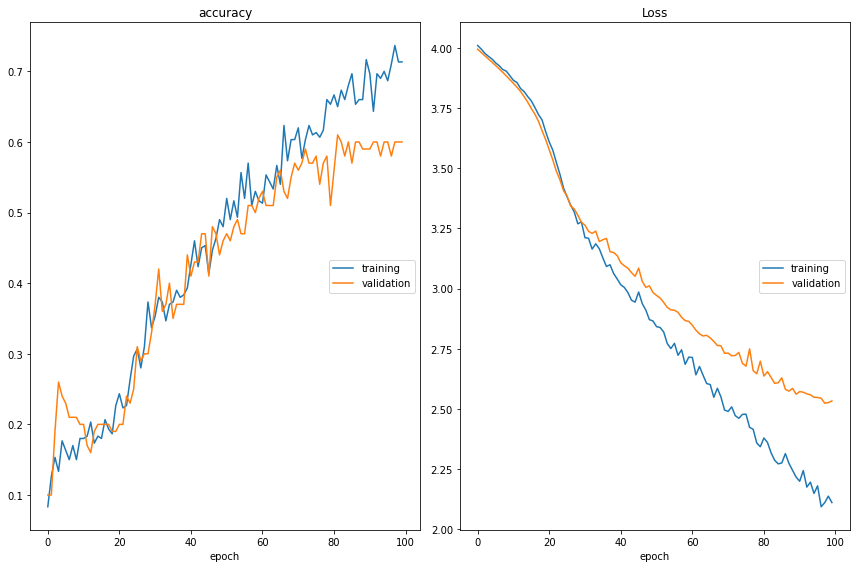

accuracy
	training         	 (min:    0.083, max:    0.737, cur:    0.713)
	validation       	 (min:    0.100, max:    0.610, cur:    0.600)
Loss
	training         	 (min:    2.094, max:    4.010, cur:    2.111)
	validation       	 (min:    2.524, max:    3.995, cur:    2.534)
3/3 [==============================] - 2s 793ms/step - loss: 2.1114 - accuracy: 0.7133 - val_loss: 2.5337 - val_accuracy: 0.6000


In [403]:
plot_loss7 = PlotLossesCallback()

#fit the model
model_7_history = model_7.fit(X_train,
                              np.array(y_train_replaced), 
                              batch_size=128, 
                              epochs=100, 
                              verbose=1, 
                              validation_data=(X_val,np.array(y_val_replaced)),
                              callbacks=[tl_checkpoint_7, early_stop,plot_loss7])

### Regularization and Data Augmentation 

In [404]:
model_8 = tf.keras.models.Sequential([
    #put the first convolution
    tf.keras.layers.Conv2D(64, (3,3), activation='relu', input_shape=(64, 64, 3)),
    
    #put the maxpooling layer
    tf.keras.layers.MaxPooling2D(2, 2),
    
    #put the second convolution
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    
    #put the maxpooling layer
    tf.keras.layers.MaxPooling2D(2,2),
    
    #put the third convolution
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    
    #put the maxpooling layer
    tf.keras.layers.MaxPooling2D(2,2),
    
    #put the fourth convolution
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    
    #put the maxpooling layer
    tf.keras.layers.MaxPooling2D(2,2),
    
    #put the Flatten the results to feed into a DNN
    tf.keras.layers.Flatten(),
    
    #put the dropout layer
    tf.keras.layers.Dropout(0.5),
    
    # 512 neuron hidden layer and apply the regularization
    tf.keras.layers.Dense(units=1024,activation='relu',
        kernel_regularizer=regularizers.L1L2(l1=1e-4, l2=1e-4),
        bias_regularizer=regularizers.L2(1e-4),
        activity_regularizer=regularizers.L2(1e-4)),
    
    #put the dense layer with softmax activation function
    tf.keras.layers.Dense(10, activation='softmax')
])

In [405]:
#compile the model
model_8.compile(optimizer=Adam(learning_rate=0.0001),
                loss='sparse_categorical_crossentropy',
                metrics=['accuracy'])

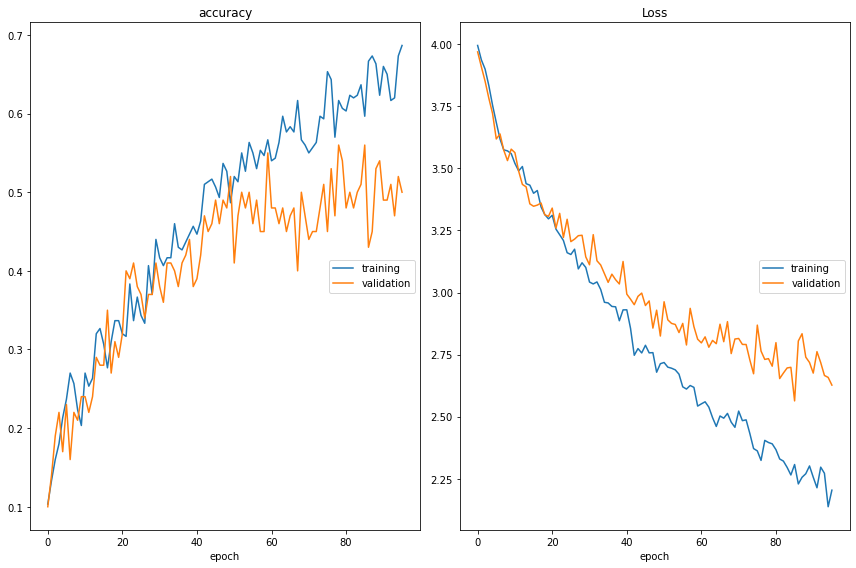

accuracy
	training         	 (min:    0.103, max:    0.687, cur:    0.687)
	validation       	 (min:    0.100, max:    0.560, cur:    0.500)
Loss
	training         	 (min:    2.137, max:    3.995, cur:    2.204)
	validation       	 (min:    2.563, max:    3.969, cur:    2.627)
10/10 [==============================] - 2s 251ms/step - loss: 2.2040 - accuracy: 0.6867 - val_loss: 2.6271 - val_accuracy: 0.5000


In [406]:
# fits the model on batches with real-time data augmentation:
plot_loss8 = PlotLossesCallback()
augmentation_history_8 = model_8.fit(datagen.flow(X_train,np.array(y_train_replaced), 
                                                  batch_size=32),
        validation_data=datagen.flow(X_val,np.array(y_val_replaced),batch_size=8), 
                                     epochs=100,
                                     callbacks=[tl_checkpoint_8, early_stop,plot_loss8])


### VGG without fine tunning (as a feature extractor) , with L1 and L2 normalization in a Dense layer 

In [407]:
input_shape = (64, 64, 3)
optim = Adam(learning_rate=0.0001)
n_classes=10

# Re-compile the model, with freezing all the weight of the VGG network 
model_9 = create_model_withL1L2Regularization(input_shape, n_classes, optim, fine_tune=0)

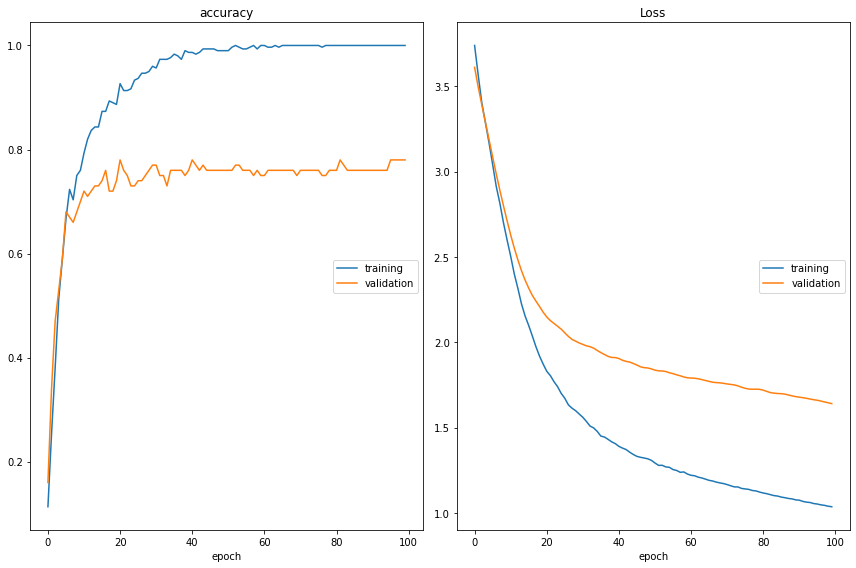

accuracy
	training         	 (min:    0.113, max:    1.000, cur:    1.000)
	validation       	 (min:    0.160, max:    0.780, cur:    0.780)
Loss
	training         	 (min:    1.037, max:    3.739, cur:    1.037)
	validation       	 (min:    1.641, max:    3.611, cur:    1.641)
3/3 [==============================] - 8s 3s/step - loss: 1.0368 - accuracy: 1.0000 - val_loss: 1.6410 - val_accuracy: 0.7800


In [408]:
plot_loss9 = PlotLossesCallback()

#to save the model
tl_checkpoint_9 = ModelCheckpoint(filepath='tl_model_9.weights.best.hdf5',save_best_only=True,verbose=1)

#fit the model
model_9_history = model_9.fit(X_train,np.array(y_train_replaced), 
                              batch_size=128,
                              epochs=100, 
                              verbose=1, 
                              validation_data=(X_val,np.array(y_val_replaced)),
                              callbacks=[tl_checkpoint_9, early_stop,plot_loss9])

### VGG without fine tunning (as a feature extractor) , with L1 and L2 normalization in a Dense layer , Data Augmentation 

In [409]:
input_shape = (64, 64, 3)
optim = Adam(learning_rate=0.0001)
n_classes=10

# Re-compile the model, with freezing all the weight of the VGG network 
model_10 = create_model_withL1L2Regularization(input_shape, n_classes, optim, fine_tune=0)

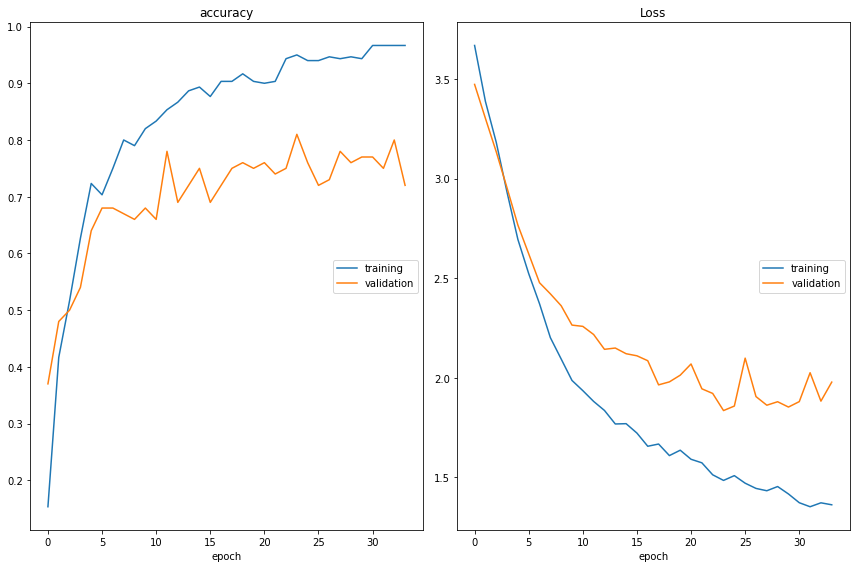

accuracy
	training         	 (min:    0.153, max:    0.967, cur:    0.967)
	validation       	 (min:    0.370, max:    0.810, cur:    0.720)
Loss
	training         	 (min:    1.353, max:    3.668, cur:    1.363)
	validation       	 (min:    1.836, max:    3.473, cur:    1.979)
10/10 [==============================] - 8s 821ms/step - loss: 1.3631 - accuracy: 0.9667 - val_loss: 1.9786 - val_accuracy: 0.7200


In [410]:
plot_loss10 = PlotLossesCallback()

#to save the model
tl_checkpoint_10 = ModelCheckpoint(filepath='tl_model_10.weights.best.hdf5',save_best_only=True,verbose=1)

#to fit the model
model_10_history = model_10.fit(datagen.flow(X_train,np.array(y_train_replaced), 
                                             batch_size=32),
        validation_data=datagen.flow(X_val,np.array(y_val_replaced),
                                     batch_size=8), 
                                epochs=100,
                                callbacks=[tl_checkpoint_10, early_stop,plot_loss10])

### VGG with fine tunning (as a feature extractor) , with L1 and L2 normalization in a Dense layer 

In [411]:
input_shape = (64, 64, 3)
optim = Adam(learning_rate=0.0001)
n_classes=10

# Re-compile the model, with freezing all the weight of the VGG network 
model_11 = create_model_withL1L2Regularization(input_shape, n_classes, optim, fine_tune=2)

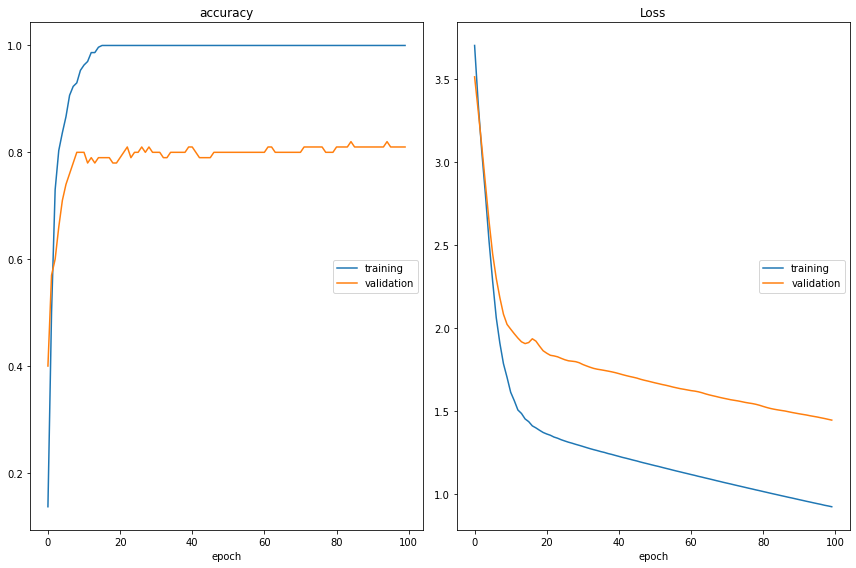

accuracy
	training         	 (min:    0.137, max:    1.000, cur:    1.000)
	validation       	 (min:    0.400, max:    0.820, cur:    0.810)
Loss
	training         	 (min:    0.925, max:    3.705, cur:    0.925)
	validation       	 (min:    1.447, max:    3.516, cur:    1.447)
3/3 [==============================] - 14s 6s/step - loss: 0.9247 - accuracy: 1.0000 - val_loss: 1.4468 - val_accuracy: 0.8100


In [412]:
plot_loss11 = PlotLossesCallback()

#to save the model
tl_checkpoint_11 = ModelCheckpoint(filepath='tl_model_11.weights.best.hdf5',save_best_only=True,verbose=1)

#to fit the model
model_11_history = model_11.fit(X_train,np.array(y_train_replaced), 
                                batch_size=128, 
                                epochs=100, 
                                verbose=1, 
                                validation_data=(X_val,np.array(y_val_replaced)),
                                callbacks=[tl_checkpoint_11, early_stop,plot_loss11])

### VGG with fine tunning (as a feature extractor) , with L1 and L2 normalization in a Dense layer , Data Augmentation 

In [413]:
input_shape = (64, 64, 3)
optim = Adam(learning_rate=0.0001)
n_classes=10

# Re-compile the model, with freezing all the weight of the VGG network 
model_12 = create_model_withL1L2Regularization(input_shape, n_classes, optim, fine_tune=2)

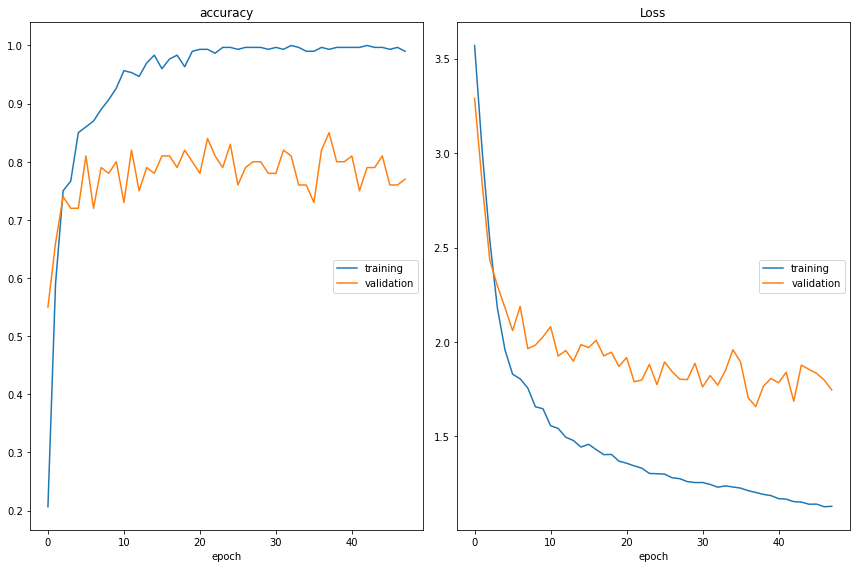

accuracy
	training         	 (min:    0.207, max:    1.000, cur:    0.990)
	validation       	 (min:    0.550, max:    0.850, cur:    0.770)
Loss
	training         	 (min:    1.128, max:    3.570, cur:    1.130)
	validation       	 (min:    1.658, max:    3.290, cur:    1.746)
10/10 [==============================] - 9s 887ms/step - loss: 1.1300 - accuracy: 0.9900 - val_loss: 1.7462 - val_accuracy: 0.7700


In [414]:
plot_loss12 = PlotLossesCallback()

#to save the model
tl_checkpoint_12 = ModelCheckpoint(filepath='tl_model_12.weights.best.hdf5',save_best_only=True,verbose=1)

#to fit the model
model_12_history = model_12.fit(datagen.flow(X_train,np.array(y_train_replaced), 
                                             batch_size=32),
        validation_data=datagen.flow(X_val,np.array(y_val_replaced),batch_size=8), 
                                epochs=100,
                                callbacks=[tl_checkpoint_12, early_stop,plot_loss12])

### **Model performance**

In [415]:
x_test_pred_7 = model_1.predict(X_test)
x_test_pred_7_cls = np.argmax(x_test_pred_7, axis=1)

x_test_pred_8 = model_2.predict(X_test)
x_test_pred_8_cls = np.argmax(x_test_pred_8, axis=1)

x_test_pred_9 = model_3.predict(X_test)
x_test_pred_9_cls = np.argmax(x_test_pred_9, axis=1)

x_test_pred_10 = model_1.predict(X_test)
x_test_pred_10_cls = np.argmax(x_test_pred_10, axis=1)

x_test_pred_11 = model_2.predict(X_test)
x_test_pred_11_cls = np.argmax(x_test_pred_11, axis=1)

x_test_pred_12 = model_3.predict(X_test)
x_test_pred_12_cls = np.argmax(x_test_pred_12, axis=1)


4/4 [==============================] - 2s 384ms/step


<Figure size 1152x1152 with 0 Axes>

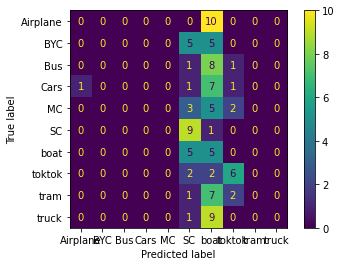

              precision    recall  f1-score   support

    Airplane       0.00      0.00      0.00        10
         BYC       0.00      0.00      0.00        10
         Bus       0.00      0.00      0.00        10
        Cars       0.00      0.00      0.00        10
          MC       0.00      0.00      0.00        10
          SC       0.32      0.90      0.47        10
        boat       0.08      0.50      0.14        10
      toktok       0.50      0.60      0.55        10
        tram       0.00      0.00      0.00        10
       truck       0.00      0.00      0.00        10

    accuracy                           0.20       100
   macro avg       0.09      0.20      0.12       100
weighted avg       0.09      0.20      0.12       100



In [416]:
#plot the model results
plot_report_confusionMatrix(list(x_test_pred_7_cls),y_test_replaced)

<Figure size 1152x1152 with 0 Axes>

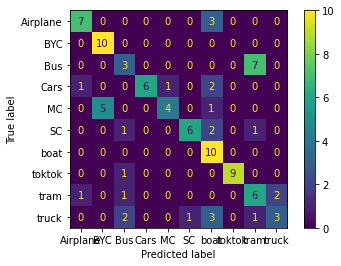

              precision    recall  f1-score   support

    Airplane       0.78      0.70      0.74        10
         BYC       0.67      1.00      0.80        10
         Bus       0.38      0.30      0.33        10
        Cars       1.00      0.60      0.75        10
          MC       0.80      0.40      0.53        10
          SC       0.86      0.60      0.71        10
        boat       0.48      1.00      0.65        10
      toktok       1.00      0.90      0.95        10
        tram       0.40      0.60      0.48        10
       truck       0.60      0.30      0.40        10

    accuracy                           0.64       100
   macro avg       0.70      0.64      0.63       100
weighted avg       0.70      0.64      0.63       100



In [417]:
#plot the model results
plot_report_confusionMatrix(list(x_test_pred_8_cls),y_test_replaced)

<Figure size 1152x1152 with 0 Axes>

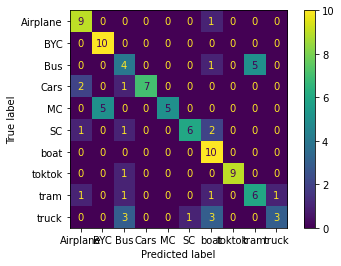

              precision    recall  f1-score   support

    Airplane       0.69      0.90      0.78        10
         BYC       0.67      1.00      0.80        10
         Bus       0.36      0.40      0.38        10
        Cars       1.00      0.70      0.82        10
          MC       1.00      0.50      0.67        10
          SC       0.86      0.60      0.71        10
        boat       0.56      1.00      0.71        10
      toktok       1.00      0.90      0.95        10
        tram       0.55      0.60      0.57        10
       truck       0.75      0.30      0.43        10

    accuracy                           0.69       100
   macro avg       0.74      0.69      0.68       100
weighted avg       0.74      0.69      0.68       100



In [418]:
#plot the model results
plot_report_confusionMatrix(list(x_test_pred_9_cls),y_test_replaced)

<Figure size 1152x1152 with 0 Axes>

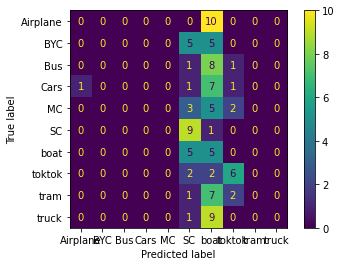

              precision    recall  f1-score   support

    Airplane       0.00      0.00      0.00        10
         BYC       0.00      0.00      0.00        10
         Bus       0.00      0.00      0.00        10
        Cars       0.00      0.00      0.00        10
          MC       0.00      0.00      0.00        10
          SC       0.32      0.90      0.47        10
        boat       0.08      0.50      0.14        10
      toktok       0.50      0.60      0.55        10
        tram       0.00      0.00      0.00        10
       truck       0.00      0.00      0.00        10

    accuracy                           0.20       100
   macro avg       0.09      0.20      0.12       100
weighted avg       0.09      0.20      0.12       100



In [419]:
#plot the model results
plot_report_confusionMatrix(list(x_test_pred_10_cls),y_test_replaced)

<Figure size 1152x1152 with 0 Axes>

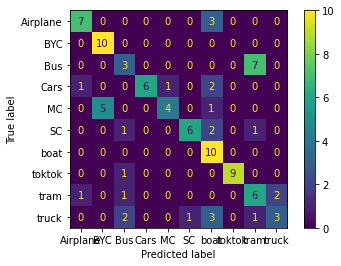

              precision    recall  f1-score   support

    Airplane       0.78      0.70      0.74        10
         BYC       0.67      1.00      0.80        10
         Bus       0.38      0.30      0.33        10
        Cars       1.00      0.60      0.75        10
          MC       0.80      0.40      0.53        10
          SC       0.86      0.60      0.71        10
        boat       0.48      1.00      0.65        10
      toktok       1.00      0.90      0.95        10
        tram       0.40      0.60      0.48        10
       truck       0.60      0.30      0.40        10

    accuracy                           0.64       100
   macro avg       0.70      0.64      0.63       100
weighted avg       0.70      0.64      0.63       100



In [420]:
#plot the model results
plot_report_confusionMatrix(list(x_test_pred_11_cls),y_test_replaced)

<Figure size 1152x1152 with 0 Axes>

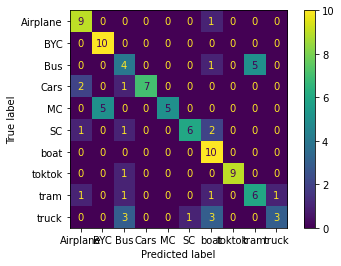

              precision    recall  f1-score   support

    Airplane       0.69      0.90      0.78        10
         BYC       0.67      1.00      0.80        10
         Bus       0.36      0.40      0.38        10
        Cars       1.00      0.70      0.82        10
          MC       1.00      0.50      0.67        10
          SC       0.86      0.60      0.71        10
        boat       0.56      1.00      0.71        10
      toktok       1.00      0.90      0.95        10
        tram       0.55      0.60      0.57        10
       truck       0.75      0.30      0.43        10

    accuracy                           0.69       100
   macro avg       0.74      0.69      0.68       100
weighted avg       0.74      0.69      0.68       100



In [421]:
#plot the model results
plot_report_confusionMatrix(list(x_test_pred_12_cls),y_test_replaced)

### Ensample method after L1,L2 Regularization 

In [422]:
preds =[]
preds.append(list(x_test_pred_7_cls))
preds.append(list(x_test_pred_9_cls))
preds.append(list(x_test_pred_11_cls))

# get the final predictions 
preds_new = np.array(preds)
transposed_preds_new = preds_new.T
predictions = st.mode(transposed_preds_new,axis=1)
y_pred_final=list(predictions[0].reshape(-1))

<Figure size 1152x1152 with 0 Axes>

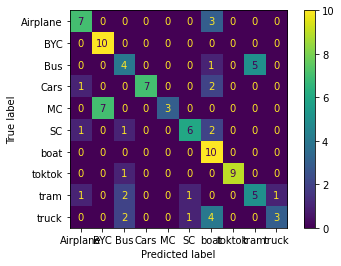

              precision    recall  f1-score   support

    Airplane       0.70      0.70      0.70        10
         BYC       0.59      1.00      0.74        10
         Bus       0.40      0.40      0.40        10
        Cars       1.00      0.70      0.82        10
          MC       1.00      0.30      0.46        10
          SC       0.75      0.60      0.67        10
        boat       0.45      1.00      0.62        10
      toktok       1.00      0.90      0.95        10
        tram       0.50      0.50      0.50        10
       truck       0.75      0.30      0.43        10

    accuracy                           0.64       100
   macro avg       0.71      0.64      0.63       100
weighted avg       0.71      0.64      0.63       100



In [423]:
#plot the model results
plot_report_confusionMatrix(y_pred_final,y_test_replaced)

### Ensample method after L1,L2 Regularization and Data Augmentation

In [424]:
preds =[]
preds.append(list(x_test_pred_8_cls))
preds.append(list(x_test_pred_10_cls))
preds.append(list(x_test_pred_12_cls))

# get the final predictions 
preds_new = np.array(preds)
transposed_preds_new = preds_new.T
predictions = st.mode(transposed_preds_new,axis=1)
y_pred_final=list(predictions[0].reshape(-1))

<Figure size 1152x1152 with 0 Axes>

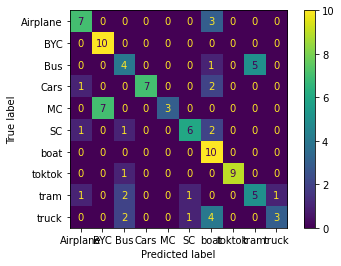

              precision    recall  f1-score   support

    Airplane       0.70      0.70      0.70        10
         BYC       0.59      1.00      0.74        10
         Bus       0.40      0.40      0.40        10
        Cars       1.00      0.70      0.82        10
          MC       1.00      0.30      0.46        10
          SC       0.75      0.60      0.67        10
        boat       0.45      1.00      0.62        10
      toktok       1.00      0.90      0.95        10
        tram       0.50      0.50      0.50        10
       truck       0.75      0.30      0.43        10

    accuracy                           0.64       100
   macro avg       0.71      0.64      0.63       100
weighted avg       0.71      0.64      0.63       100



In [425]:
#plot the model results
plot_report_confusionMatrix(y_pred_final,y_test_replaced)

## Results And Conclusion

In [18]:
summary = ["original Data","Data Augmentation","L1,L2 Regularization", "L1,L2 and Data Augmentation"]

# model 1 
model_1_loss    =[0.8189,1.1250,2.1114,2.2040]
model_1_acc     =[0.7467,0.6300 ,0.7133,0.6867]
model_1_val_loss=[1.3902,1.5753,2.5337,2.6271]
model_1_val_acc =[0.5800,0.4900,0.6000,0.5000]

# model 2 
model_2_loss    =[0.0366 ,0.1007,1.3631 ,0.9247 ]
model_2_acc     =[1.0000 ,0.9733,0.9667 ,1.0000 ]
model_2_val_loss=[0.5938 ,0.6779 ,1.9786,1.4468  ]
model_2_val_acc =[0.8100, 0.7600, 0.7200,0.8100  ]

# model 3 
model_3_loss    =[0.0027 ,0.0681,1.3631 ,0.9247 ]
model_3_acc     =[1.0000 ,0.9767,0.9667 ,1.0000 ]
model_3_val_loss=[0.6038 ,0.8586 ,1.9786 ,1.4468 ]
model_3_val_acc =[0.7600, 0.7900, 0.7200, 0.8100]

# ensamble method 
Ensamble_acc=[0.73 ,0.64 ,0.64,0.64]


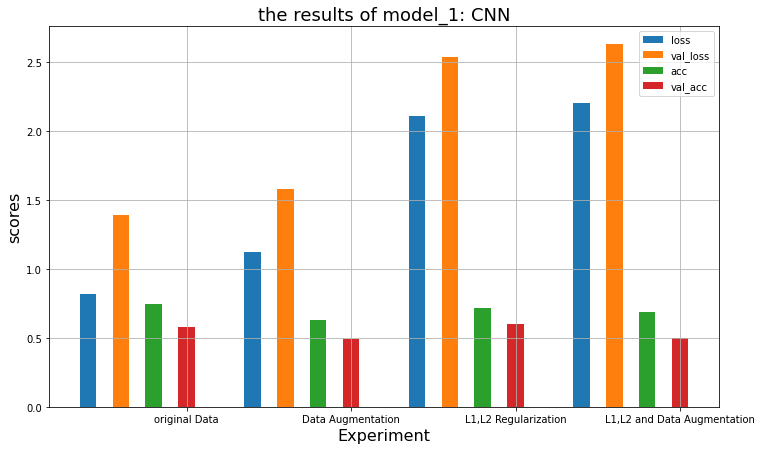

In [23]:
plot_results(model_1_loss,model_1_acc,
             model_1_val_loss,
             model_1_val_acc,"model_1: CNN")

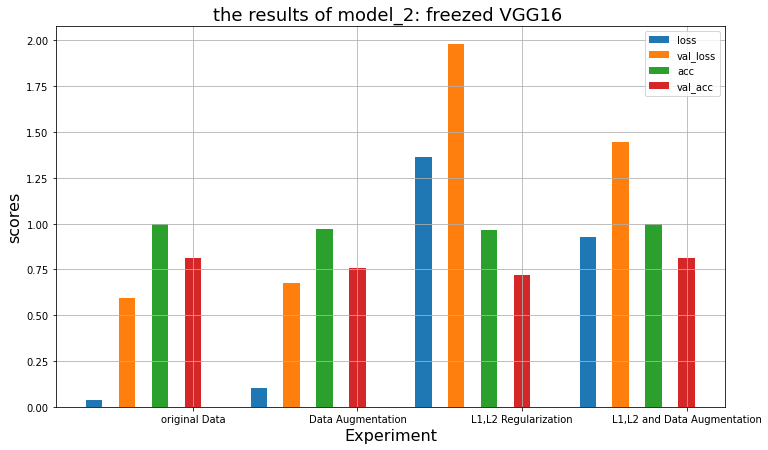

In [20]:
plot_results(model_2_loss,
             model_2_acc,
             model_2_val_loss,
             model_2_val_acc,"model_2: freezed VGG16 ")

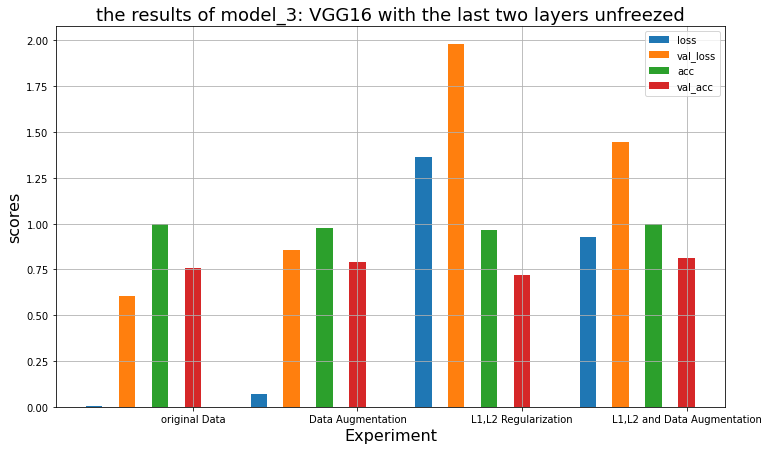

In [21]:
plot_results(model_3_loss,model_3_acc,
             model_3_val_loss,
             model_3_val_acc,"model_3: VGG16 with the last two layers unfreezed")

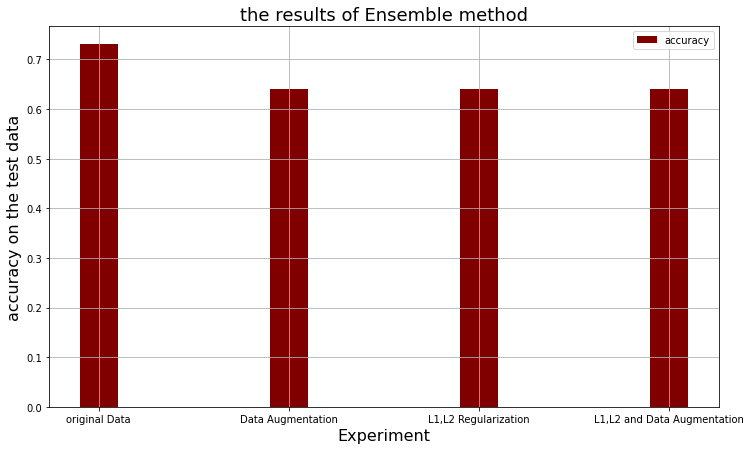

In [19]:
plt.figure(figsize=(12, 7))

X = ["original Data","Data Augmentation","L1,L2 Regularization", "L1,L2 and Data Augmentation"]

X_axis = np.arange(len(X))

plt.bar(X_axis, Ensamble_acc,width=0.2, label = 'accuracy',color="maroon")

plt.xticks(X_axis, X)
plt.xlabel("Experiment",fontsize=16)
plt.ylabel("accuracy on the test data",fontsize=16)
plt.title(f"the results of Ensemble method",fontsize=18)

    
plt.legend()
plt.grid()
plt.show()

## References 

[1] https://keras.io/examples/vision/grad_cam/

[2] https://keras.io/api/layers/regularizers/
    